# GUC Clustering Project 

**Objective:** 
The objective of this project teach students how to apply clustering to real data sets

The projects aims to teach student: 
* Which clustering approach to use
* Compare between Kmeans, Hierarchal, DBScan, and Gaussian Mixtures  
* How to tune the parameters of each data approach
* What is the effect of different distance functions (optional) 
* How to evaluate clustering approachs 
* How to display the output
* What is the effect of normalizing the data 

Students in this project will use ready-made functions from Sklearn, plotnine, numpy and pandas 
 



In [107]:
# if plotnine is not installed in Jupter then use the following command to install it 


Running this project require the following imports 

In [136]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
from sklearn.datasets import make_blobs
from plotnine import *   
# StandardScaler is a function to normalize the data 
# You may also check MinMaxScaler and MaxAbsScaler 
#from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors

from sklearn.cluster import DBSCAN


from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

from sklearn.metrics import silhouette_score

%matplotlib inline



#more 

from sklearn.datasets import load_iris
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.spatial.distance import pdist, squareform
from scipy.stats import pearsonr
from sklearn.datasets import load_iris
import matplotlib.patches as mpl_patches
from matplotlib.patches import Ellipse  # Correct import statement
from matplotlib.colors import LogNorm


In [109]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X,km=[],num_clusters=0):
    color = 'brgcmyk'  #List colors
    alpha = 0.5  #color obaque
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1],c = color[i],alpha = alpha,s=s)
            plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c = color[i], marker = 'x', s = 100)

## Multi Blob Data Set 
* The Data Set generated below has 6 cluster with varying number of users and varing densities
* Cluster the data set below using 



In [122]:
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)

### Kmeans 
* Use Kmeans with different values of K to cluster the above data 
* Display the outcome of each value of K 
* Plot distortion function versus K and choose the approriate value of k 
* Plot the silhouette_score versus K and use it to choose the best K 
* Store the silhouette_score for the best K for later comparison with other clustering techniques. 

In [111]:
def display_cluster(X, km=[], num_clusters=0):
    color = 'brgcmyk'  # List colors
    alpha = 0.5  # Color opacity
    s = 20

    if num_clusters == 0:
        plt.scatter(X[:, 0], X[:, 1], c=color[0], alpha=alpha, s=s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[km.labels_ == i, 0], X[km.labels_ == i, 1], c=color[i % len(color)], alpha=alpha, s=s)
            plt.scatter(km.cluster_centers_[i][0], km.cluster_centers_[i][1], c=color[i % len(color)], marker='x', s=100)

For K=2, Silhouette Score: 0.4751544541991239
For K=3, Silhouette Score: 0.43631793714185435
For K=4, Silhouette Score: 0.4628725400351352
For K=5, Silhouette Score: 0.48085813358066154
For K=6, Silhouette Score: 0.4859737366910219
For K=7, Silhouette Score: 0.46340972197949165
For K=8, Silhouette Score: 0.4437992701413617
For K=9, Silhouette Score: 0.44929583790433164
The best K based on Silhouette Score: 6


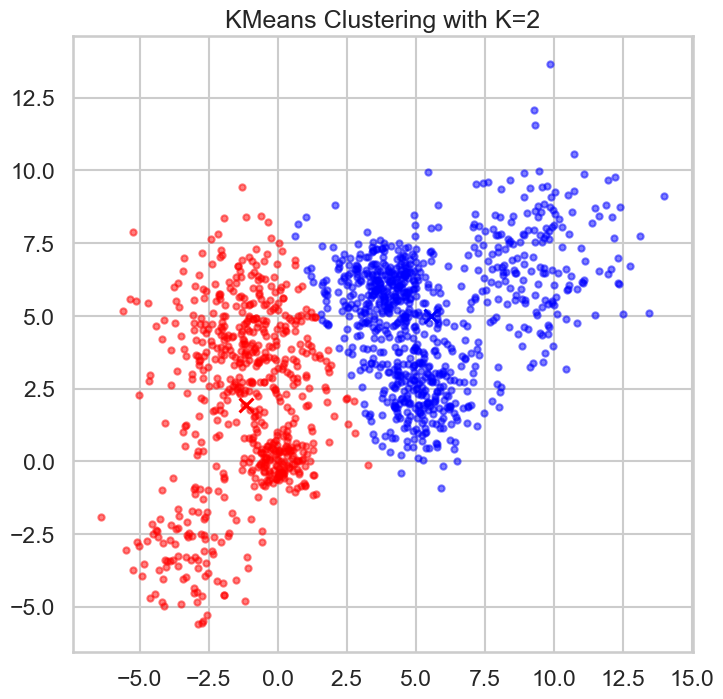

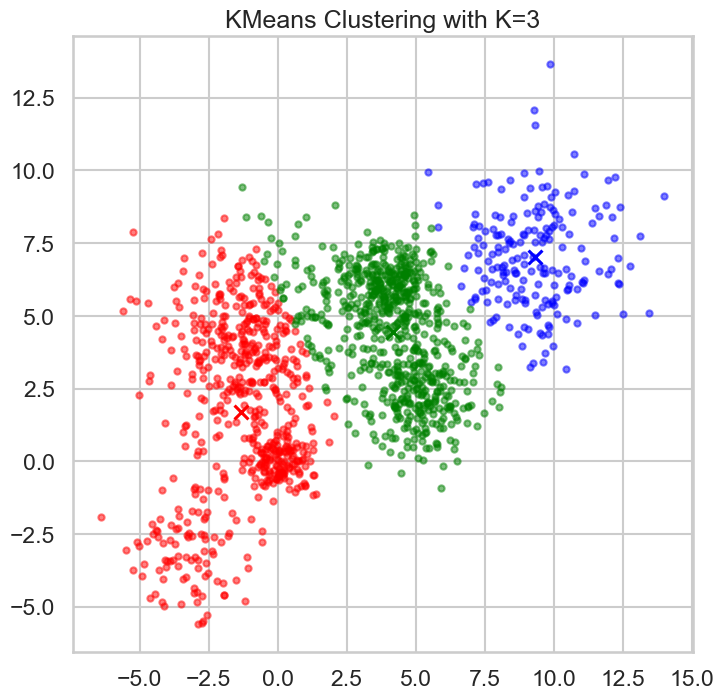

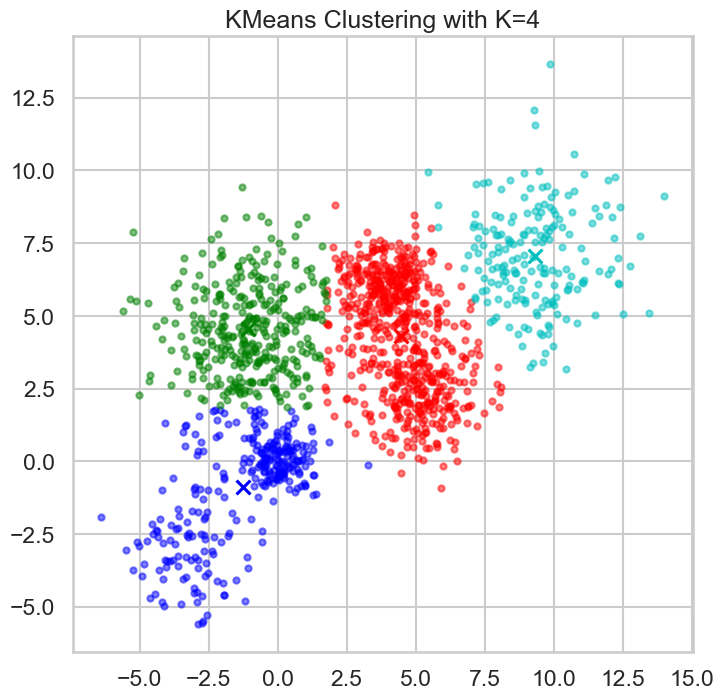

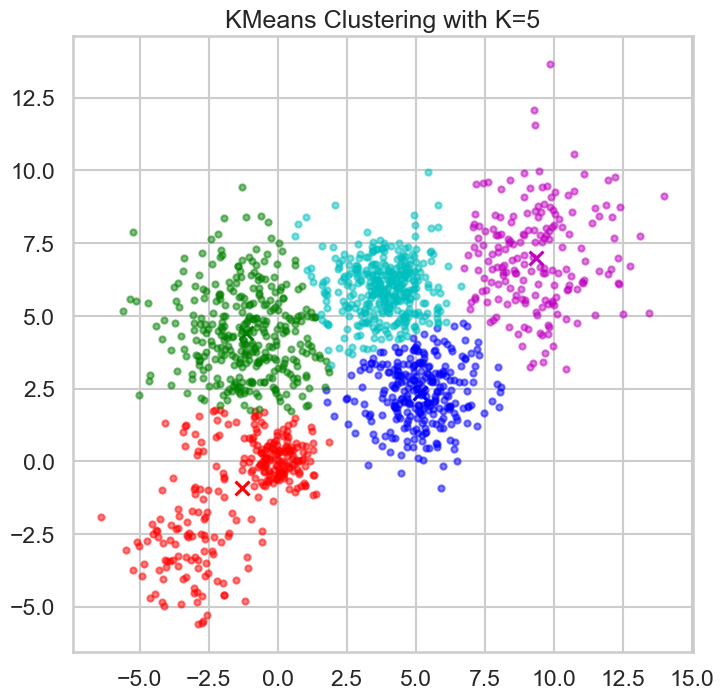

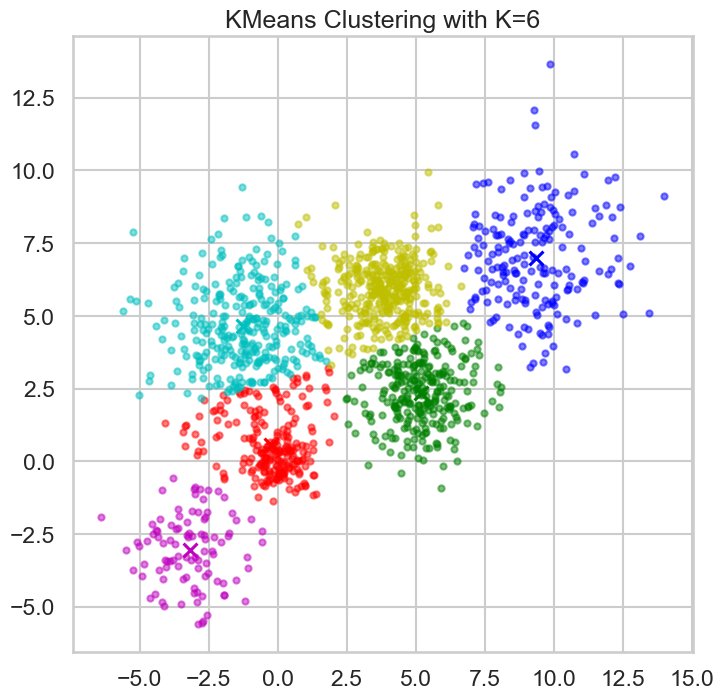

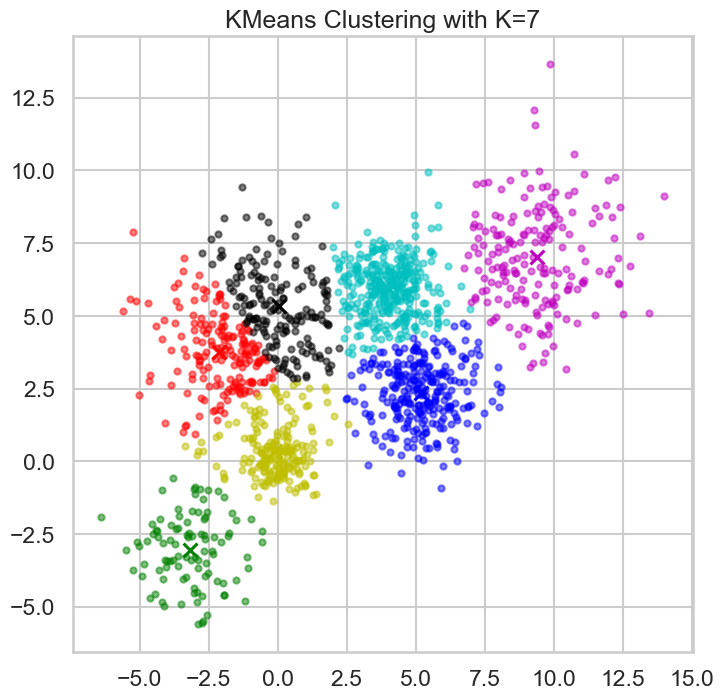

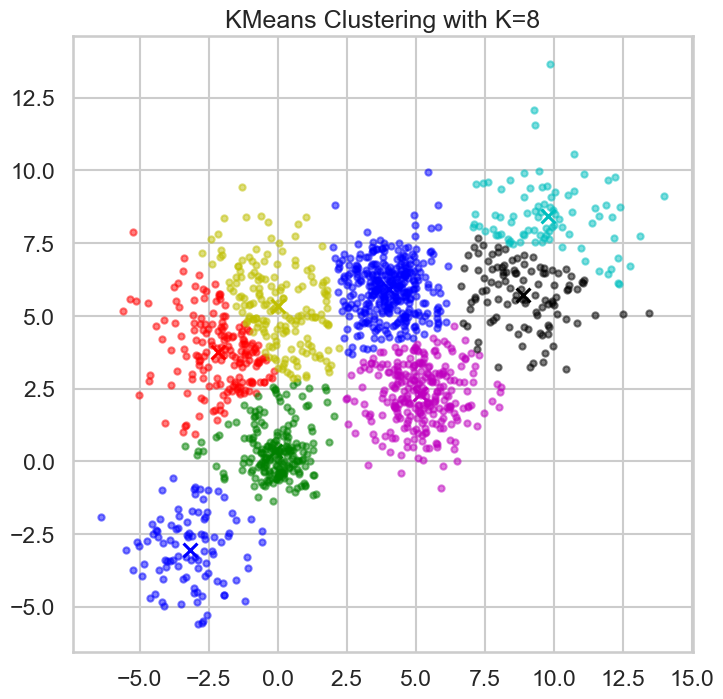

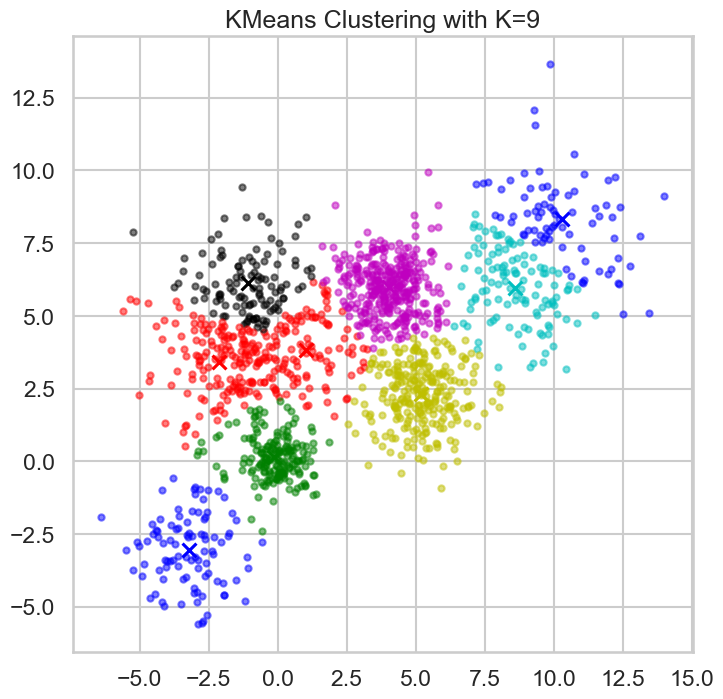

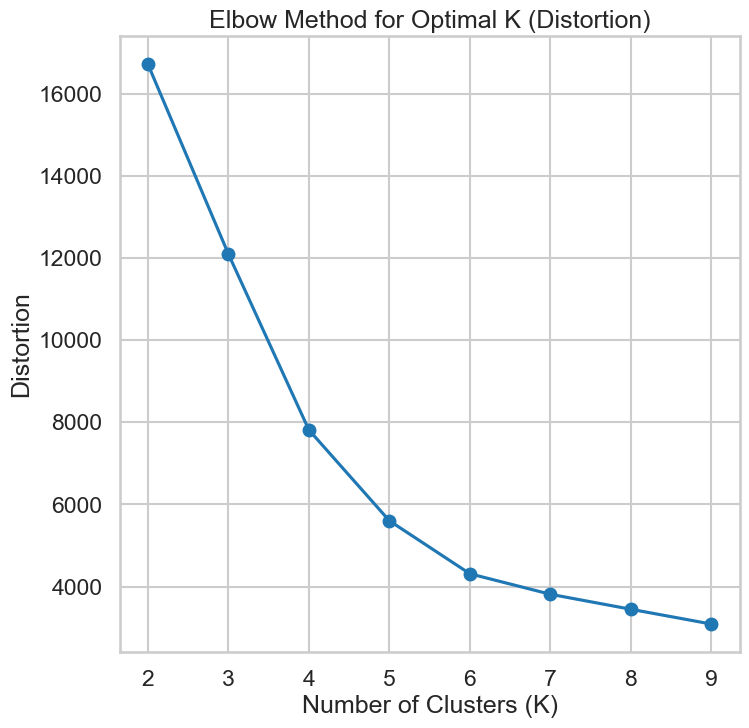

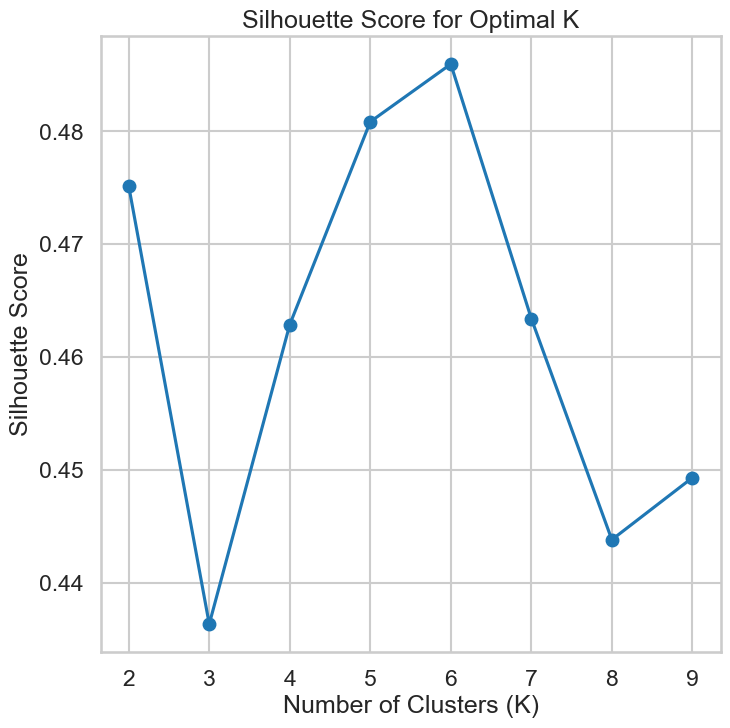

In [112]:
# Function to perform KMeans clustering and display results
def kmeans_clustering(X, k_values):
    distortions = []
    silhouette_scores = []

    for k in k_values:
        km = KMeans(n_clusters=k, random_state=42)
        km.fit(X)
        
        # Display clusters
        plt.figure()
        display_cluster(X, km, k)
        plt.title(f'KMeans Clustering with K={k}')
        
        # Calculate distortion and silhouette_score
        distortions.append(km.inertia_)
        silhouette_avg = silhouette_score(X, km.labels_)
        silhouette_scores.append(silhouette_avg)
        print(f'For K={k}, Silhouette Score: {silhouette_avg}')

    # Plot distortion function versus K
    plt.figure()
    plt.plot(k_values, distortions, marker='o')
    plt.xlabel('Number of Clusters (K)')
    plt.ylabel('Distortion')
    plt.title('Elbow Method for Optimal K (Distortion)')

    # Plot silhouette_score versus K
    plt.figure()
    plt.plot(k_values, silhouette_scores, marker='o')
    plt.xlabel('Number of Clusters (K)')
    plt.ylabel('Silhouette Score')
    plt.title('Silhouette Score for Optimal K')

    # Find the best K based on silhouette_score
    best_k = k_values[np.argmax(silhouette_scores)]
    print(f'The best K based on Silhouette Score: {best_k}')

    return best_k

# Specify K values to try
k_values = range(2, 10)

# Perform KMeans clustering and display results
best_k_kmeans = kmeans_clustering(Multi_blob_Data, k_values)


The K-means seem to be a very good way to deal with this and to cluter then 

### Hierarchal Clustering
* Use AgglomerativeClustering function to  to cluster the above data 
* In the  AgglomerativeClustering change the following parameters 
    * Affinity (use euclidean, manhattan and cosine)
    * Linkage( use average and single )
    * Distance_threshold (try different)
* For each of these trials plot the Dendograph , calculate the silhouette_score and display the resulting clusters  
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observation 

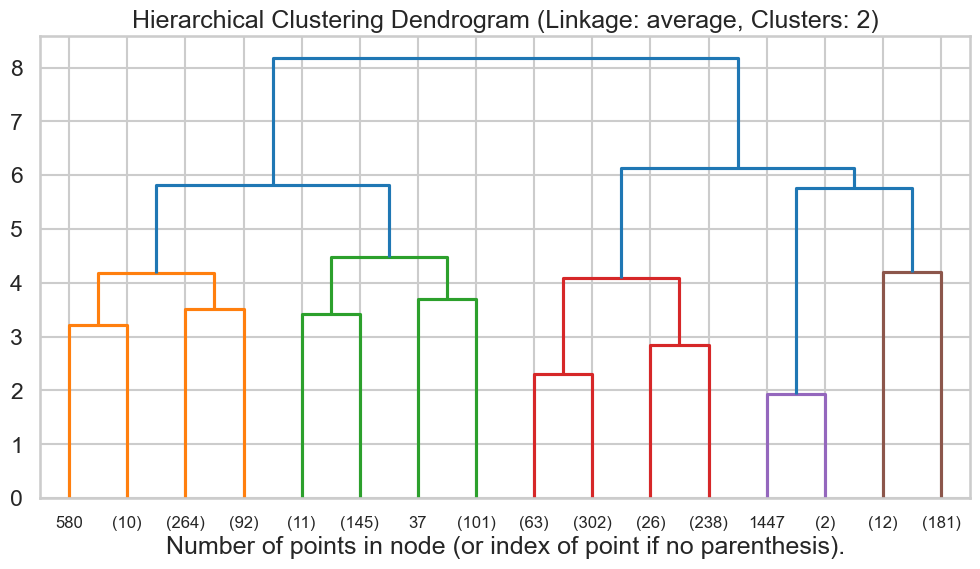

Silhouette Score: 0.4716908069861964


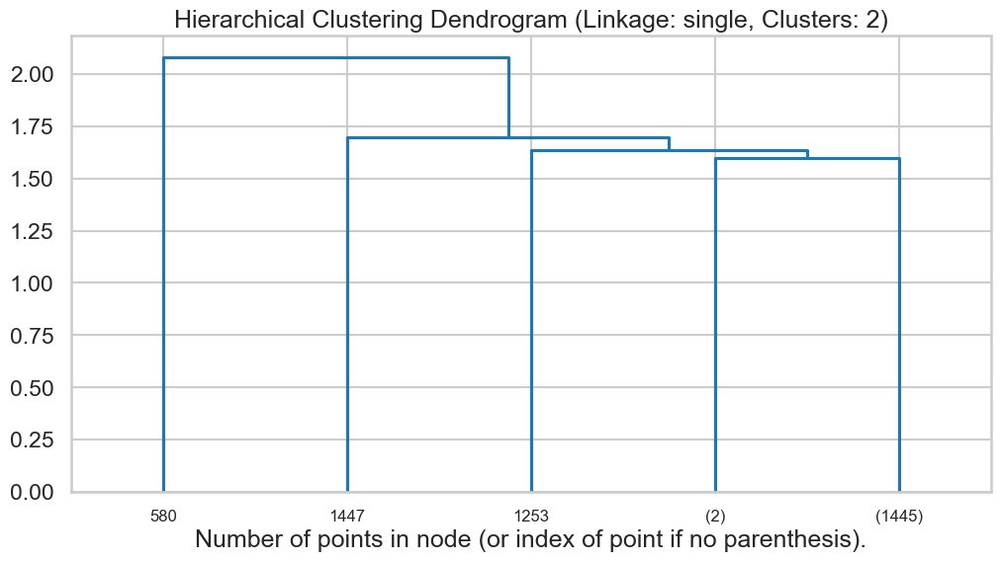

Silhouette Score: 0.3218066204847175
Best Parameters: {'linkage_type': 'average'}
Best Silhouette Score: 0.4716908069861964


In [10]:
def hierarchical_clustering(X, linkage_type='average', n_clusters=2):
    # Perform hierarchical clustering
    model = AgglomerativeClustering(linkage=linkage_type, n_clusters=n_clusters)
    labels = model.fit_predict(X)

    # Plot dendrogram
    plt.figure(figsize=(12, 6))
    plt.title(f'Hierarchical Clustering Dendrogram (Linkage: {linkage_type}, Clusters: {n_clusters})')
    dendrogram(linkage(X, method=linkage_type), truncate_mode='level', p=3)
    plt.xlabel("Number of points in node (or index of point if no parenthesis).")
    plt.show()

    # Calculate silhouette score
    silhouette_avg = silhouette_score(X, labels)
    print(f'Silhouette Score: {silhouette_avg}')

#     # Display resulting clusters
#     unique_clusters = np.unique(labels)
#     for cluster in unique_clusters:
#         cluster_points = X[labels == cluster]
#         print(f'Cluster {cluster + 1}: {cluster_points}')

    return silhouette_avg

linkage_types = ['average', 'single']
best_silhouette_score = float('-inf')
best_params = None

for linkage_type in linkage_types:
    silhouette_score_current = hierarchical_clustering(Multi_blob_Data, linkage_type)
    
    # Store the best silhouette_score and parameters
    if silhouette_score_current > best_silhouette_score:
        best_silhouette_score = silhouette_score_current
        best_params = {'linkage_type': linkage_type}

# Print the best parameters and silhouette score
print("Best Parameters:", best_params)
print("Best Silhouette Score:", best_silhouette_score)


IN this i base it on the n clusters not thebdistance threshhold 

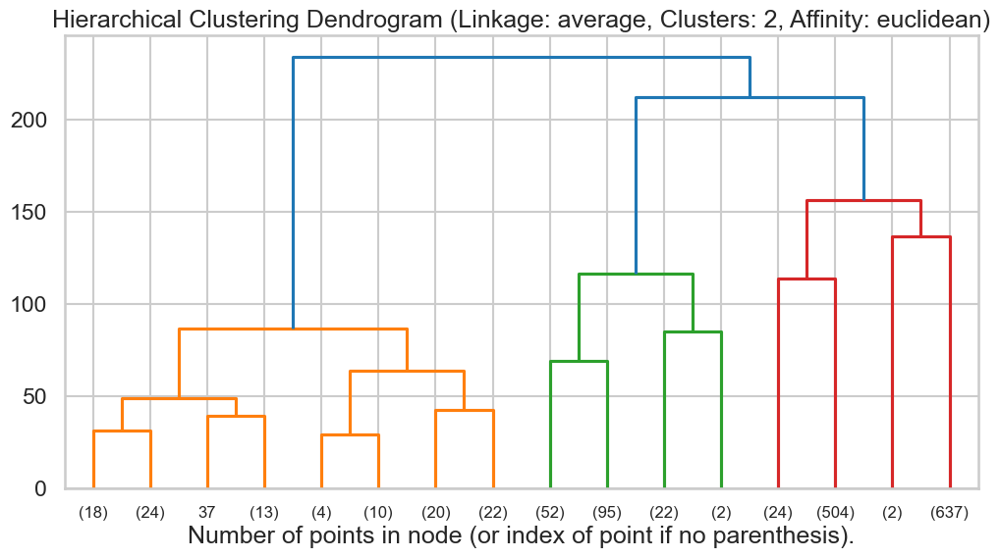

Silhouette Score: 0.4012903153173331


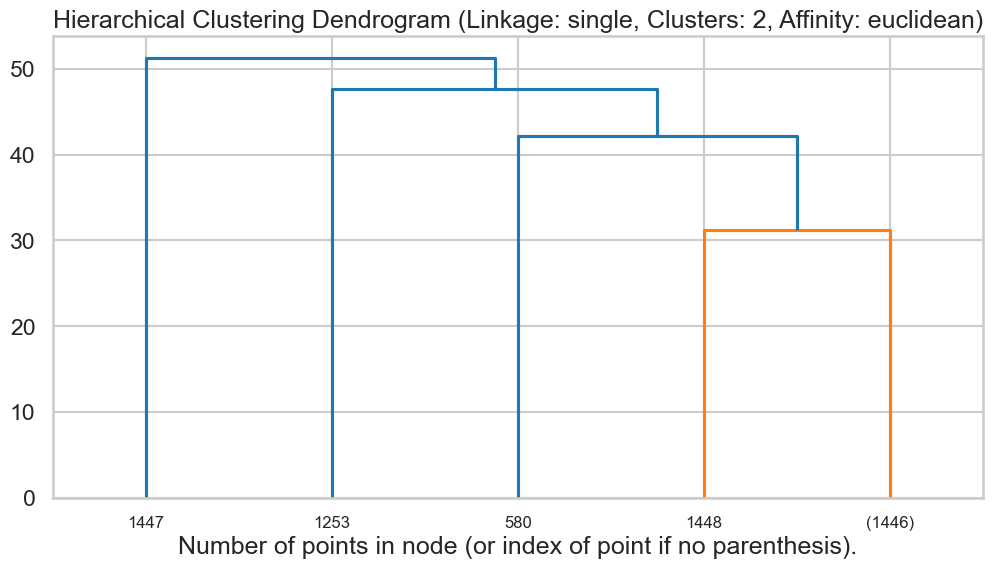

Silhouette Score: 0.48479122684696824


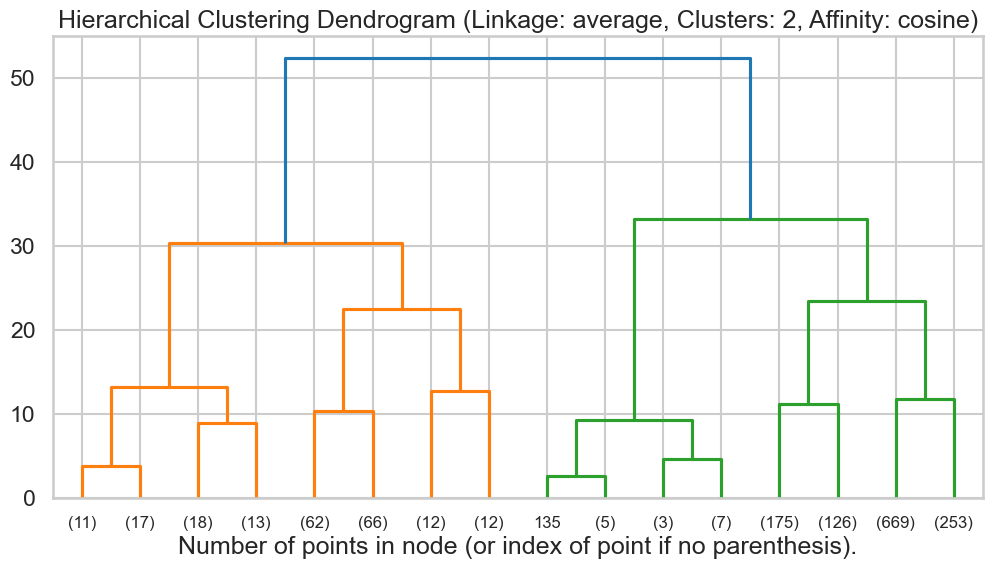

Silhouette Score: 0.6966213717667359


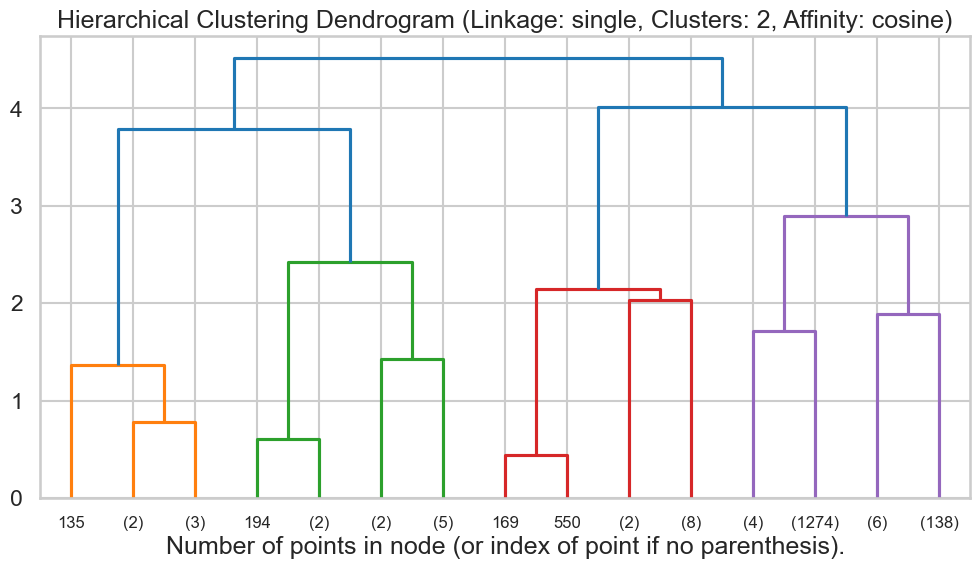

Silhouette Score: 0.3242061243974959


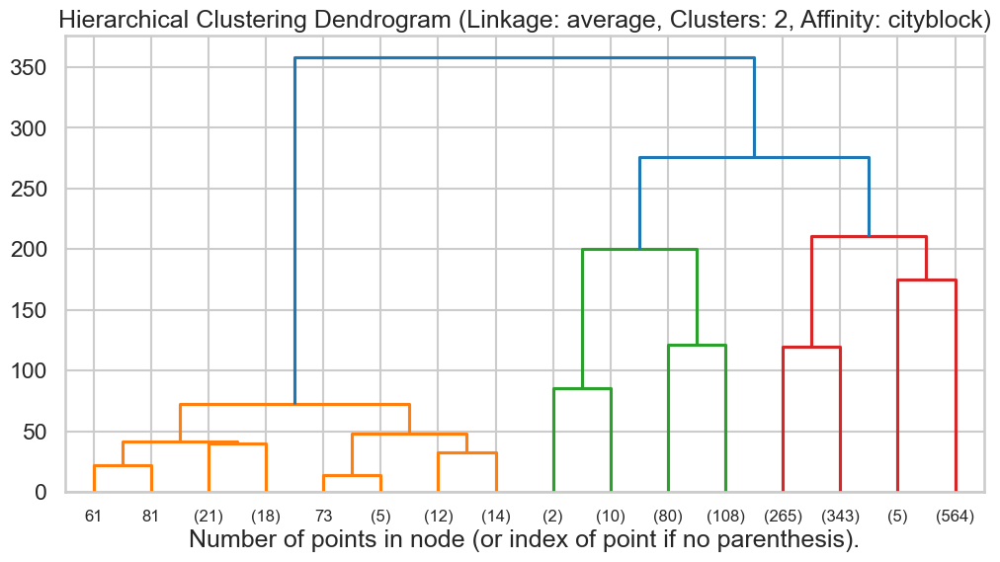

Silhouette Score: 0.46287568950386326


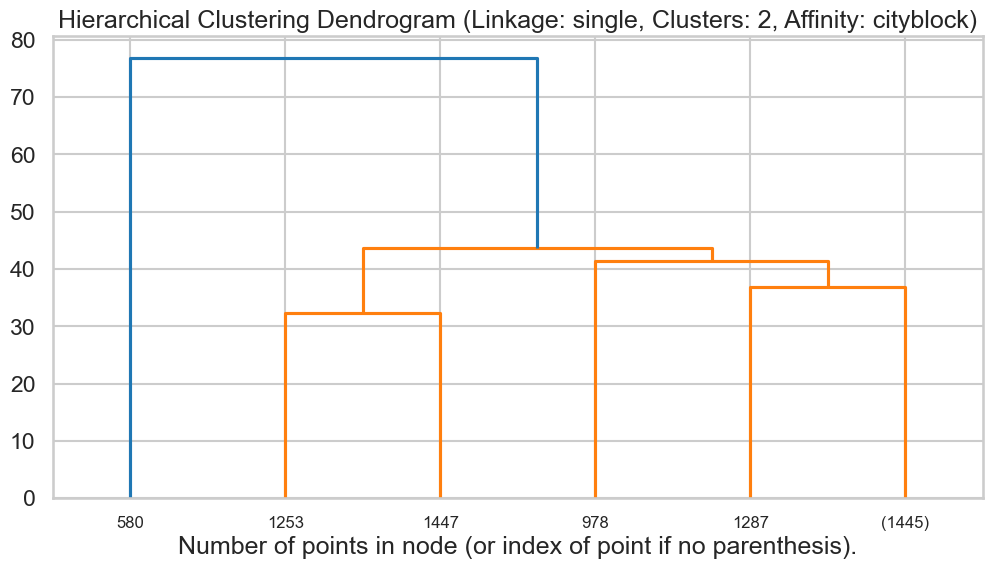

Silhouette Score: 0.22701778996335717
Best Parameters: {'distance_metric': 'cosine', 'linkage_type': 'average'}
Best Silhouette Score: 0.6966213717667359


In [11]:
def hierarchical_clustering(X, affinity='euclidean', linkage_type='average', n_clusters=2):
    distances = squareform(pdist(X, metric=affinity))

    # Perform hierarchical clustering
    model = AgglomerativeClustering(linkage=linkage_type, n_clusters=n_clusters)
    labels = model.fit_predict(distances)

    # Plot dendrogram
    plt.figure(figsize=(12, 6))
    plt.title(f'Hierarchical Clustering Dendrogram (Linkage: {linkage_type}, Clusters: {n_clusters}, Affinity: {affinity})')
    dendrogram(linkage(distances, method=linkage_type), truncate_mode='level', p=3)
    plt.xlabel("Number of points in node (or index of point if no parenthesis).")
    plt.show()

    # Calculate silhouette score
    silhouette_avg = silhouette_score(distances, labels)
    print(f'Silhouette Score: {silhouette_avg}')

    return silhouette_avg

distance_metrics = ['euclidean', 'cosine', 'cityblock']
best_silhouette_score = float('-inf')
best_params = None

for distance_metric in distance_metrics:
    for linkage_type in ['average', 'single']:
        silhouette_score_current = hierarchical_clustering(Multi_blob_Data, affinity=distance_metric, linkage_type=linkage_type)
        
        # Store the best silhouette_score and parameters
        if silhouette_score_current > best_silhouette_score:
            best_silhouette_score = silhouette_score_current
            best_params = {'distance_metric': distance_metric, 'linkage_type': linkage_type}

# Print the best parameters and silhouette score
print("Best Parameters:", best_params)
print("Best Silhouette Score:", best_silhouette_score)


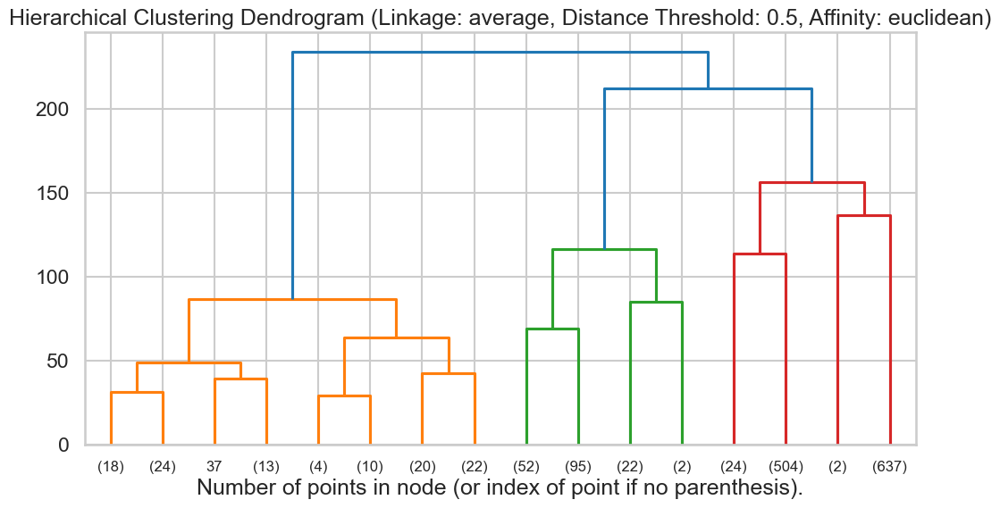

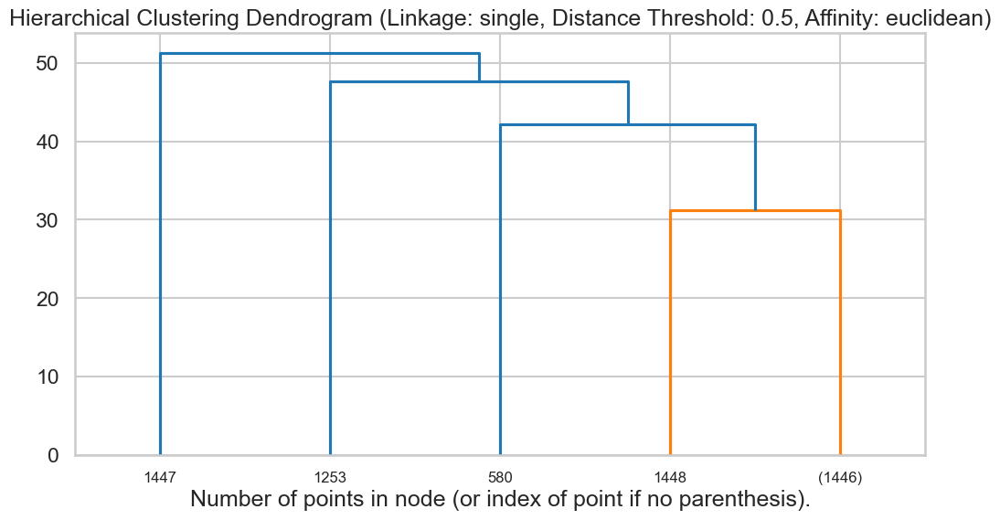

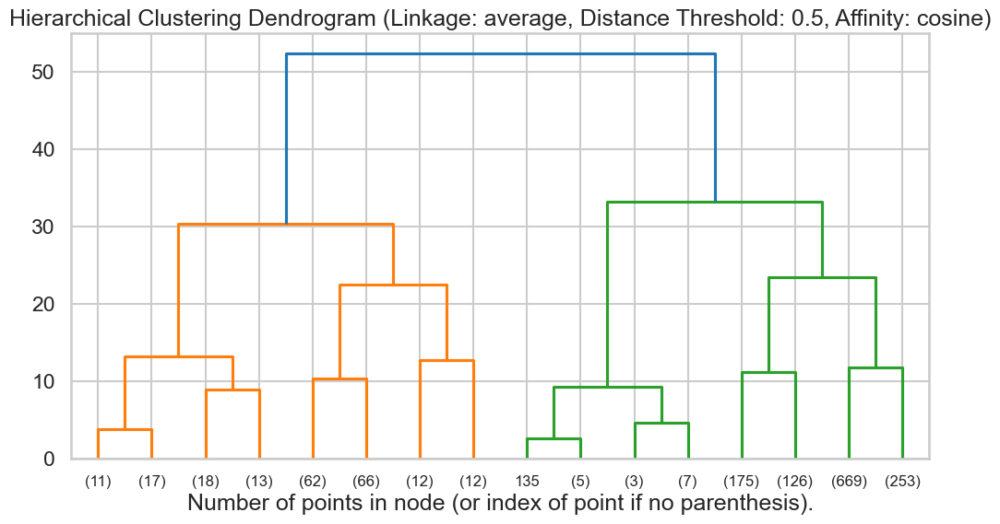

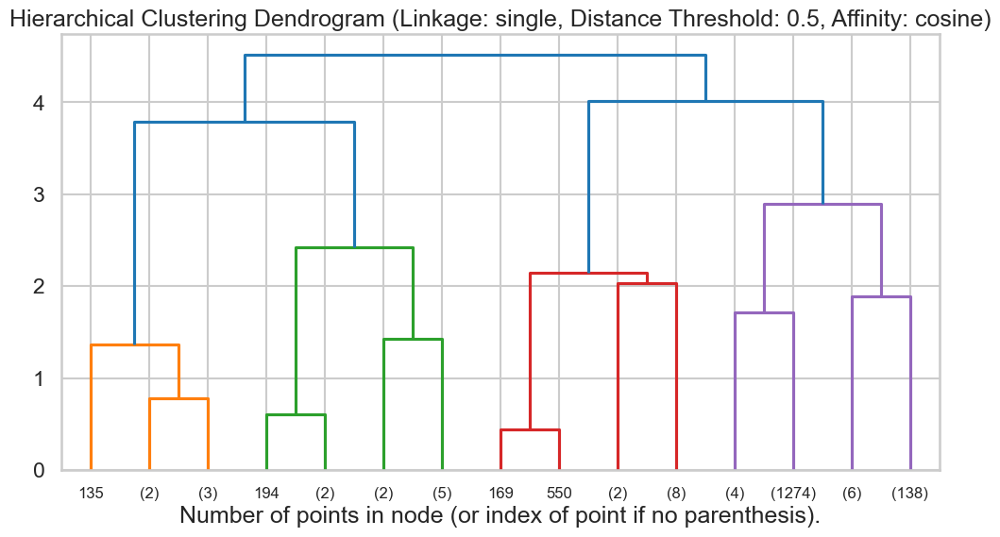

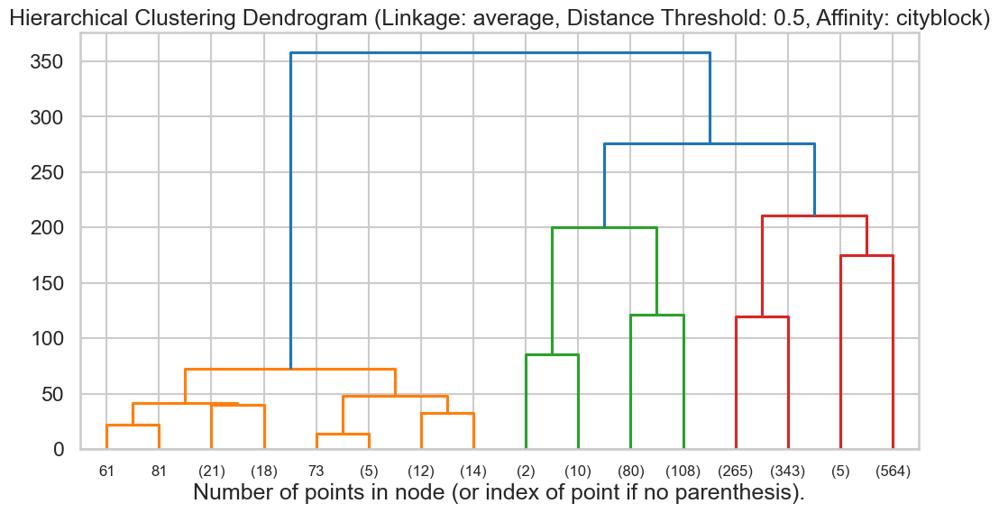

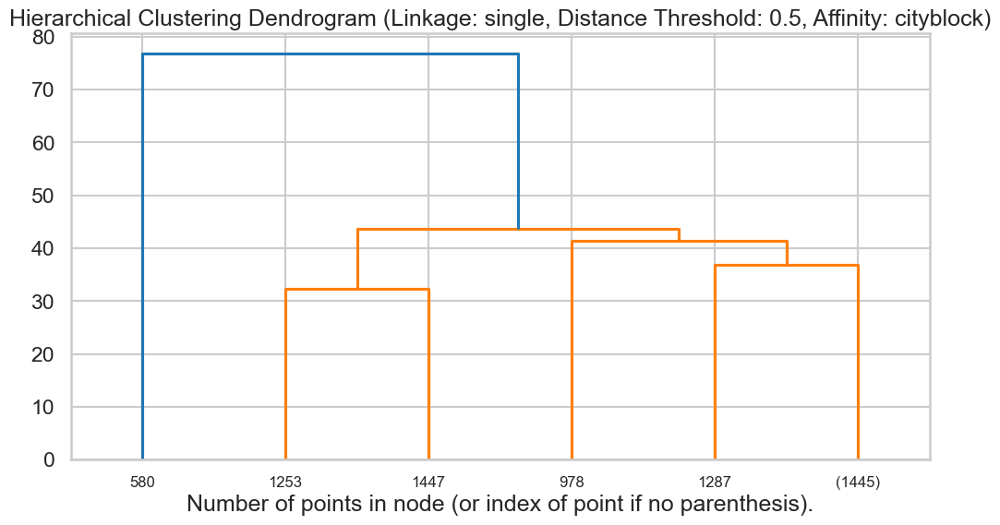

Best Parameters: {'distance_metric': 'cityblock', 'linkage_type': 'single', 'distance_threshold': 0.5}


In [208]:
def hierarchical_clustering(X, affinity='euclidean', linkage_type='average', distance_threshold=None):
    if affinity == 'pearson':
        distances = pearson_correlation(X)
    else:
        distances = squareform(pdist(X, metric=affinity))

    # Perform hierarchical clustering
    model = AgglomerativeClustering(linkage=linkage_type, n_clusters=None, distance_threshold=distance_threshold)
    labels = model.fit_predict(distances)

    # Plot dendrogram
    plt.figure(figsize=(12, 6))
    plt.title(f'Hierarchical Clustering Dendrogram (Linkage: {linkage_type}, Distance Threshold: {distance_threshold}, Affinity: {affinity})')
    dendrogram(linkage(distances, method=linkage_type), truncate_mode='level', p=3)
    plt.xlabel("Number of points in node (or index of point if no parenthesis).")
    plt.show()

    # Return the computed labels
    return labels

def pearson_correlation(X):
    # Calculate the pairwise Pearson correlation coefficients
    corr_matrix = np.corrcoef(X.T)
    # Convert correlation coefficients to distances
    distances = 1 - np.abs(corr_matrix)
    return distances

# Example usage:
distance_metrics = ['euclidean', 'cosine', 'cityblock']
distance_thresholds = np.linspace(0.1, 1.0, 10) 

best_params = None

for distance_metric in distance_metrics:
    for linkage_type in ['average', 'single']:
        labels = hierarchical_clustering(Multi_blob_Data, affinity=distance_metric, linkage_type=linkage_type, distance_threshold=0.5)
        
        # Perform any analysis or visualization using the computed labels
        # For example, you can use labels for further analysis or visualization

        # Store the best parameters (if needed)
        best_params = {'distance_metric': distance_metric, 'linkage_type': linkage_type, 'distance_threshold': 0.5}

# Print the best parameters (if needed)
print("Best Parameters:", best_params)


This is on the distance threshold looping between the ranges 

### DBScan
* Use DBScan function to  to cluster the above data 
* In the  DBscan change the following parameters 
    * EPS (from 0.1 to 3)
    * Min_samples (from 5 to 25)
* Plot the silhouette_score versus the variation in the EPS and the min_samples
* Plot the resulting Clusters in this case 
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observations and comments 

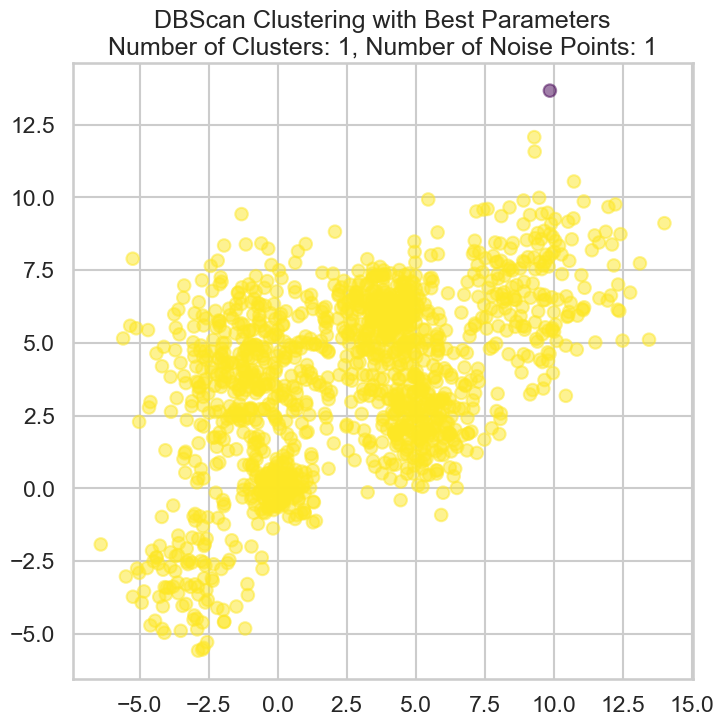

Best EPS: 2.1, Best Min_samples: 6
Best Silhouette Score: 0.4685207355522043


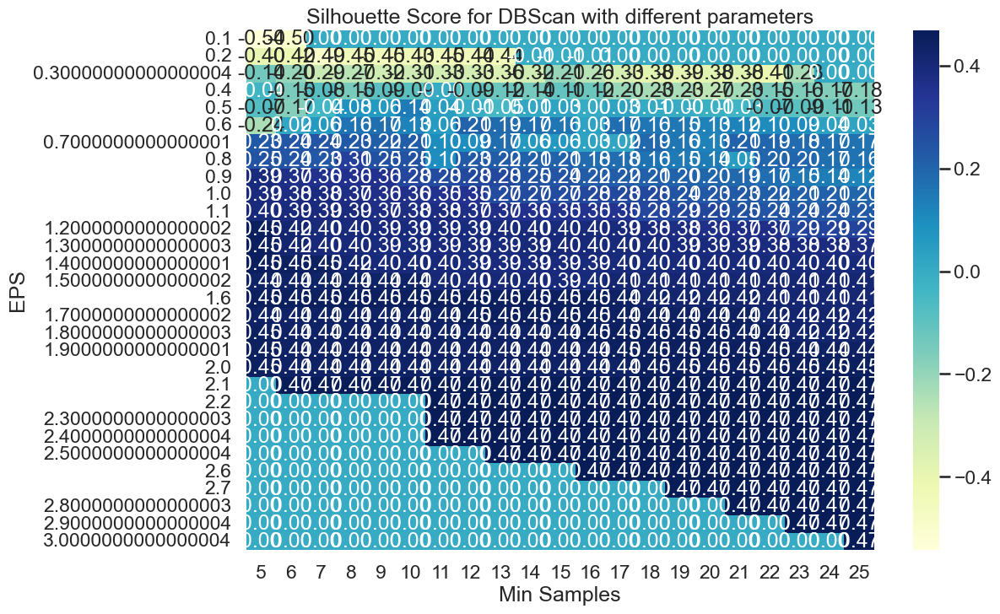

In [216]:

# Function to perform DBScan clustering and plot silhouette_score
def perform_dbscan(data, eps_range, min_samples_range):
    silhouette_scores = np.zeros((len(eps_range), len(min_samples_range)))

    for i, eps in enumerate(eps_range):
        for j, min_samples in enumerate(min_samples_range):
            dbscan = DBSCAN(eps=eps, min_samples=min_samples)
            labels = dbscan.fit_predict(data)
            
            # Exclude outliers (-1) from silhouette score calculation
            if len(set(labels)) > 1:
                silhouette_avg = silhouette_score(data, labels)
                silhouette_scores[i, j] = silhouette_avg

    return silhouette_scores

# Define the range of parameters to search
eps_range = np.arange(0.1, 3.1, 0.1)
min_samples_range = np.arange(5, 26, 1)

# Perform DBScan with varying parameters
silhouette_scores = perform_dbscan(Multi_blob_Data, eps_range, min_samples_range)

# Find the indices of the maximum silhouette score
best_indices = np.unravel_index(np.argmax(silhouette_scores), silhouette_scores.shape)
best_eps, best_min_samples, best_silhouette_score = eps_range[best_indices[0]], min_samples_range[best_indices[1]], silhouette_scores[best_indices]

# Plot resulting clusters with the best parameters
best_dbscan = DBSCAN(eps=best_eps, min_samples=best_min_samples)
best_labels = best_dbscan.fit_predict(Multi_blob_Data)

# Count the number of clusters (excluding noise)
num_clusters = len(set(best_labels)) - (1 if -1 in best_labels else 0)
num_noise_points = np.sum(best_labels == -1)

# Plot the clusters
plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=best_labels, cmap='viridis', alpha=0.5)
plt.title(f'DBScan Clustering with Best Parameters\nNumber of Clusters: {num_clusters}, Number of Noise Points: {num_noise_points}')
plt.show()

# Print the best parameters and corresponding silhouette score
print(f"Best EPS: {best_eps}, Best Min_samples: {best_min_samples}")
print(f"Best Silhouette Score: {best_silhouette_score}")
# Plot silhouette scores
plt.figure(figsize=(12, 8))
sns.heatmap(silhouette_scores, annot=True, fmt=".2f", cmap="YlGnBu",
                xticklabels=min_samples_range, yticklabels=eps_range)
plt.xlabel("Min Samples")
plt.ylabel("EPS")
plt.title("Silhouette Score for DBScan with different parameters")
plt.show()


This seems like it is right based on the silhuette score however this results seems like it isnt actually clustering therefore i will change it to be that the results not to be optimum if ithey arent "actualy" clustered 

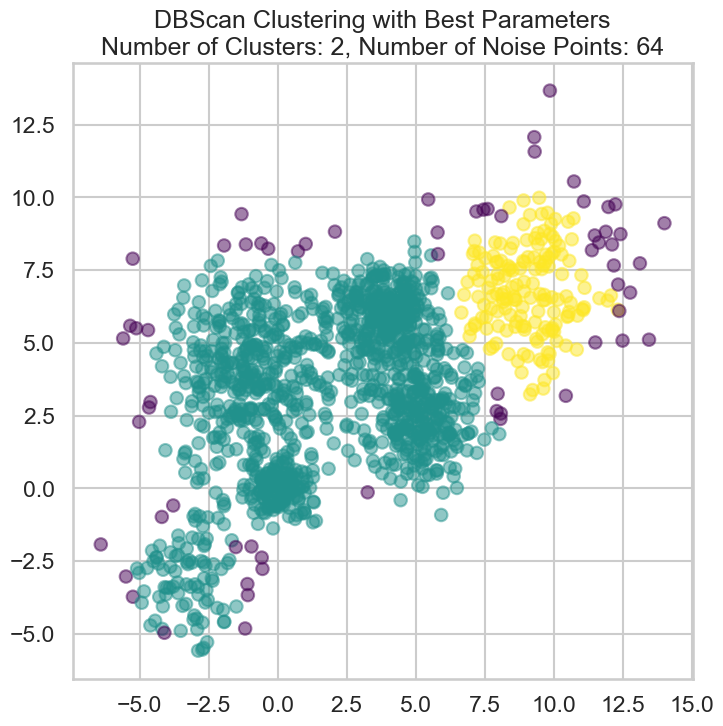

Best EPS: 0.8, Best Min_samples: 8
Best Silhouette Score: 0.3051951203876005


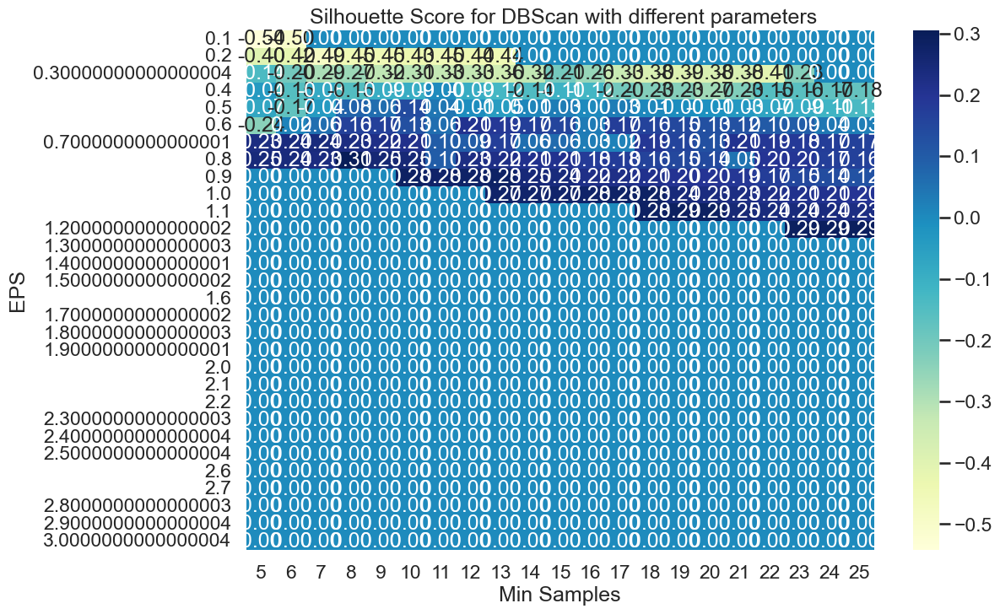

In [167]:
def perform_dbscan(data, eps_range, min_samples_range, num_iterations=5):
    silhouette_scores = np.zeros((len(eps_range), len(min_samples_range)))

    for i, eps in enumerate(eps_range):
        for j, min_samples in enumerate(min_samples_range):
            avg_silhouette = 0
            num_valid_runs = 0
            
            for _ in range(num_iterations):
                dbscan = DBSCAN(eps=eps, min_samples=min_samples)
                labels = dbscan.fit_predict(data)

                unique_labels = set(labels)
                if len(unique_labels) > 2:  # At least 2 clusters and noise
                    silhouette_avg = silhouette_score(data, labels)
                    avg_silhouette += silhouette_avg
                    num_valid_runs += 1

            if num_valid_runs > 0:
                avg_silhouette /= num_valid_runs
                silhouette_scores[i, j] = avg_silhouette

    return silhouette_scores

# Define the range of parameters to search
eps_range = np.arange(0.1, 3.1, 0.1)
min_samples_range = np.arange(5, 26, 1)

# Perform DBScan with varying parameters and average silhouette score
average_silhouette_scores = perform_dbscan(Multi_blob_Data, eps_range, min_samples_range)

# Find the indices of the maximum average silhouette score
best_indices = np.unravel_index(np.argmax(average_silhouette_scores), average_silhouette_scores.shape)
best_eps, best_min_samples, best_avg_silhouette_score = eps_range[best_indices[0]], min_samples_range[best_indices[1]], average_silhouette_scores[best_indices]

# Plot resulting clusters with the best parameters
best_dbscan = DBSCAN(eps=best_eps, min_samples=best_min_samples)
best_labels = best_dbscan.fit_predict(Multi_blob_Data)

# Count the number of clusters (excluding noise)
num_clusters = len(set(best_labels)) - (1 if -1 in best_labels else 0)
num_noise_points = np.sum(best_labels == -1)

# Plot the clusters
plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=best_labels, cmap='viridis', alpha=0.5)
plt.title(f'DBScan Clustering with Best Parameters\nNumber of Clusters: {num_clusters}, Number of Noise Points: {num_noise_points}')
plt.show()

# Print the best parameters and corresponding average silhouette score
print(f"Best EPS: {best_eps}, Best Min_samples: {best_min_samples}")
print(f"Best Silhouette Score: {best_avg_silhouette_score}")
# Plot average silhouette scores
plt.figure(figsize=(12, 8))
sns.heatmap(average_silhouette_scores, annot=True, fmt=".2f", cmap="YlGnBu",
                xticklabels=min_samples_range, yticklabels=eps_range)
plt.xlabel("Min Samples")
plt.ylabel("EPS")
plt.title(" Silhouette Score for DBScan with different parameters")
plt.show()


In [119]:
# def perform_dbscan(data, eps_range, min_samples_range, num_iterations=5):
#     max_silhouette_scores = np.zeros((len(eps_range), len(min_samples_range)))

#     for i, eps in enumerate(eps_range):
#         for j, min_samples in enumerate(min_samples_range):
#             max_silhouette = -1

#             for _ in range(num_iterations):
#                 dbscan = DBSCAN(eps=eps, min_samples=min_samples)
#                 labels = dbscan.fit_predict(data)

#                 unique_labels = len(set(labels))
#                 if unique_labels > 1:  # Exclude cases with only one unique label
#                     silhouette_avg = silhouette_score(data, labels)
#                     max_silhouette = max(max_silhouette, silhouette_avg)

#             max_silhouette_scores[i, j] = max_silhouette

#     return max_silhouette_scores

# def calculate_dynamic_threshold(data):
#     # Calculate a dynamic threshold based on the data characteristics
#     min_samples_threshold = int(np.sqrt(len(data)))
#     return min_samples_threshold

# # Define the range of parameters to search
# eps_range = np.arange(0.1, 3.1, 0.1)
# min_samples_range = np.arange(5, 26, 1)

# # Determine a dynamic threshold for the minimum number of clusters
# dynamic_min_samples = calculate_dynamic_threshold(Multi_blob_Data)

# # Perform DBScan with varying parameters and max silhouette score
# max_silhouette_scores = perform_dbscan(Multi_blob_Data, eps_range, min_samples_range)

# # Find the indices of the maximum silhouette score
# best_indices = np.unravel_index(np.argmax(max_silhouette_scores), max_silhouette_scores.shape)
# best_eps, best_min_samples, best_max_silhouette_score = eps_range[best_indices[0]], min_samples_range[best_indices[1]], max_silhouette_scores[best_indices]

# # Plot resulting clusters with the best parameters
# best_dbscan = DBSCAN(eps=best_eps, min_samples=best_min_samples)
# best_labels = best_dbscan.fit_predict(Multi_blob_Data)

# # Count the number of clusters (excluding noise)
# num_clusters = len(set(best_labels)) - (1 if -1 in best_labels else 0)
# num_noise_points = np.sum(best_labels == -1)

# # Plot the clusters
# plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=best_labels, cmap='viridis', alpha=0.5)
# plt.title(f'DBScan Clustering with Best Parameters\nNumber of Clusters: {num_clusters}, Number of Noise Points: {num_noise_points}')
# plt.show()

# # Print the best parameters and corresponding max silhouette score
# print(f"Best EPS: {best_eps}, Best Min_samples: {best_min_samples}")
# print(f"Best Max Silhouette Score: {best_max_silhouette_score}")
# # Plot max silhouette scores
# plt.figure(figsize=(12, 8))
# sns.heatmap(max_silhouette_scores, annot=True, fmt=".2f", cmap="YlGnBu",
#                 xticklabels=min_samples_range, yticklabels=eps_range)
# plt.xlabel("Min Samples")
# plt.ylabel("EPS")
# plt.title("Max Silhouette Score for DBScan with different parameters")
# plt.show()


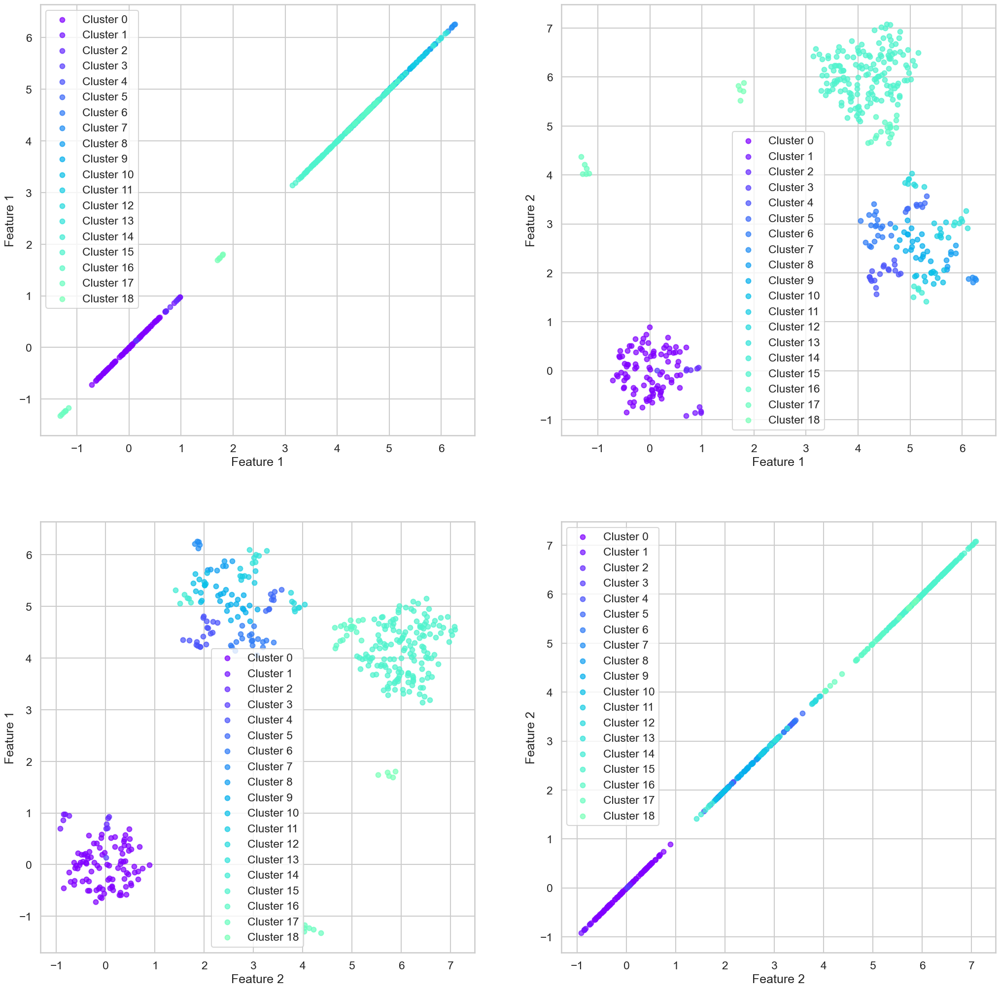

In [71]:

def display_cluster(data_points, dbscan=None, num_clusters=None, alpha=0.7, s=50, feature_names=None):
    if dbscan is not None:
        labels = dbscan.fit_predict(data_points)
        unique_labels = set(labels)
        num_clusters = len(unique_labels) - (1 if -1 in labels else 0)

        color = plt.cm.rainbow(np.linspace(0, 1, num_clusters))
        vars = len(data_points[0])
        fig, axs = plt.subplots(vars, vars, figsize=(25, 25))

        # Calculate the average number of clusters
        avg_num_clusters = num_clusters // 2 

        for i in range(avg_num_clusters):  # Plot only the first avg_num_clusters clusters
            cluster_points = data_points[labels == i, :]
            for j in range(vars):
                for k in range(vars):
                    axs[j, k].scatter(cluster_points[:, j], cluster_points[:, k], c=[color[i]], alpha=alpha, s=s, label=f'Cluster {i}')
                    axs[j, k].set_xlabel(feature_names[j])
                    axs[j, k].set_ylabel(feature_names[k])
                    axs[j, k].legend()
    
        plt.show()

# Set up the dataset
n_bins = 6  
centers = [(-3, -3), (0, 0), (5, 2.5), (-1, 4), (4, 6), (9, 7)]
Multi_blob_Data, _ = make_blobs(n_samples=[100, 150, 300, 400, 300, 200], n_features=2, cluster_std=[1.3, 0.6, 1.2, 1.7, 0.9, 1.7],
                                centers=centers, shuffle=False, random_state=42)

# Define the range of parameters to search
eps_range = np.arange(0.1, 3.1, 0.1)
min_samples_range = np.arange(5, 26, 1)

# Store the number of unique clusters for each combination
unique_clusters_count = []

# Display clusters for all combinations of eps and min_samples
for eps in eps_range:
    for min_samples in min_samples_range:
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        labels = dbscan.fit_predict(Multi_blob_Data)
        
        # Exclude combinations resulting in only one cluster
        unique_labels = np.unique(labels)
        if len(unique_labels) < 2:
            continue
        
        num_clusters = len(unique_labels) - (1 if -1 in labels else 0)
        unique_clusters_count.append((eps, min_samples, num_clusters))

# Sort combinations based on the number of unique clusters
unique_clusters_count.sort(key=lambda x: x[2], reverse=True)

# Choose the top combination
top_eps_min_samples = unique_clusters_count[0]

# Plot clusters for the top combination
eps, min_samples, _ = top_eps_min_samples
dbscan = DBSCAN(eps=eps, min_samples=min_samples)
display_cluster(Multi_blob_Data, dbscan, feature_names=['Feature 1', 'Feature 2'])


In [ ]:
def display_cluster(data_points, dbscan=None, num_clusters=None, alpha=0.7, s=50, feature_names=None):
    if dbscan is not None:
        labels = dbscan.fit_predict(data_points)
        unique_labels = set(labels)
        num_clusters = len(unique_labels) - (1 if -1 in labels else 0)

        color = plt.cm.rainbow(np.linspace(0, 1, num_clusters))
        vars = len(data_points[0])
        fig, axs = plt.subplots(vars, vars, figsize=(25, 25))

        for i in unique_labels:
            if i == -1 or np.sum(labels == i) == 0:
                continue  # Skip noise points and clusters with no points
            cluster_points = data_points[labels == i, :]
            for j in range(vars):
                for k in range(vars):
                    axs[j, k].scatter(cluster_points[:, j], cluster_points[:, k], c=[color[i]], alpha=alpha, s=s, label=f'Cluster {i}')
                    axs[j, k].set_xlabel(feature_names[j])
                    axs[j, k].set_ylabel(feature_names[k])
                    axs[j, k].legend()
    
        plt.show()

# Set up the dataset
n_bins = 6  
centers = [(-3, -3), (0, 0), (5, 2.5), (-1, 4), (4, 6), (9, 7)]
Multi_blob_Data, _ = make_blobs(n_samples=[100, 150, 300, 400, 300, 200], n_features=2, cluster_std=[1.3, 0.6, 1.2, 1.7, 0.9, 1.7],
                                centers=centers, shuffle=False, random_state=42)

# Define the range of parameters to search
eps_range = np.arange(0.1, 3.1, 0.1)
min_samples_range = np.arange(5, 26, 1)

# Display clusters for all combinations of eps and min_samples
for eps in eps_range:
    for min_samples in min_samples_range:
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        display_cluster(Multi_blob_Data, dbscan, feature_names=['Feature 1', 'Feature 2'])


This is not the best thing to do as it will be extremely time consumig and for no reason 

### Gaussian Mixture
* Use GaussianMixture function to cluster the above data 
* In GMM change the covariance_type and check the difference in the resulting proabability fit 
* Use a 2D contour plot to plot the resulting distribution (the components of the GMM) as well as the total Gaussian mixture 

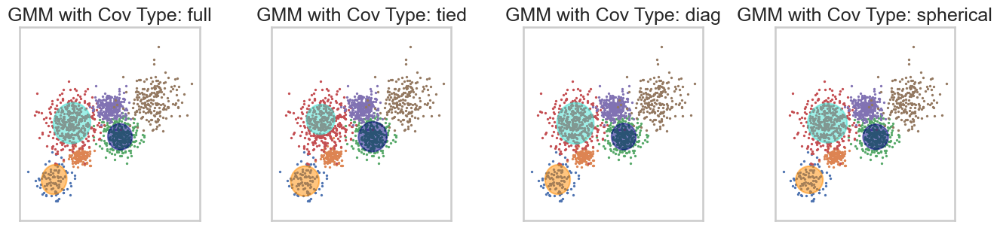

In [138]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.mixture import GaussianMixture
from matplotlib.patches import Ellipse  # Correct import statement
from matplotlib.colors import LogNorm

# Define the make_ellipses function
def make_ellipses(gmm, ax):
    for n, color in enumerate(colors):
        if gmm.covariance_type == "full":
            covariances = gmm.covariances_[n][:2, :2]
        elif gmm.covariance_type == "tied":
            covariances = gmm.covariances_[:2, :2]
        elif gmm.covariance_type == "diag":
            covariances = np.diag(gmm.covariances_[n][:2])
        elif gmm.covariance_type == "spherical":
            covariances = np.eye(gmm.means_.shape[1]) * gmm.covariances_[n]
        v, w = np.linalg.eigh(covariances)
        u = w[0] / np.linalg.norm(w[0])
        angle = np.arctan2(u[1], u[0])
        angle = 180 * angle / np.pi  # convert to degrees
        v = 2.0 * np.sqrt(2.0) * np.sqrt(v)
        ell = Ellipse(
            gmm.means_[n, :2], v[0], v[1], angle=180 + angle, color=color
        )
        ell.set_clip_box(ax.bbox)
        ell.set_alpha(0.5)
        ax.add_artist(ell)
        ax.set_aspect("equal", "datalim")


# Example usage
colors = ["navy", "turquoise", "darkorange"]
n_classes = len(np.unique(y))

# Set up GMM parameters
covariance_types = ["full", "tied", "diag", "spherical"]
n_estimators = len(covariance_types)

plt.figure(figsize=(4 * n_estimators, 8))
plt.subplots_adjust(wspace=0.4, hspace=0.4)

for index, cov_type in enumerate(covariance_types):
    # Fit GMM with the current covariance_type
    gmm = GaussianMixture(n_components=n_classes, covariance_type=cov_type, random_state=42)
    gmm.fit(Multi_blob_Data)

    # Plot data points
    plt.subplot(2, n_estimators, index + 1)
    for n, color in enumerate(sns.color_palette("deep")):
        data = Multi_blob_Data[y == n]
        plt.scatter(data[:, 0], data[:, 1], s=0.8, color=color, label=f"Class {n + 1}")

    # Plot GMM components
    make_ellipses(gmm, plt.gca())
    plt.title(f"GMM with Cov Type: {cov_type}")
    plt.xticks(())
    plt.yticks(())

# Show the plot
plt.show()


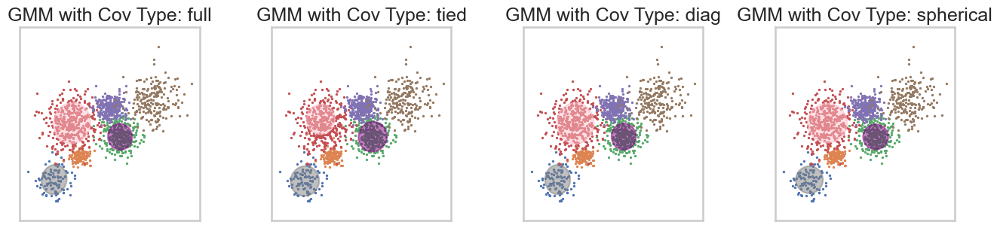

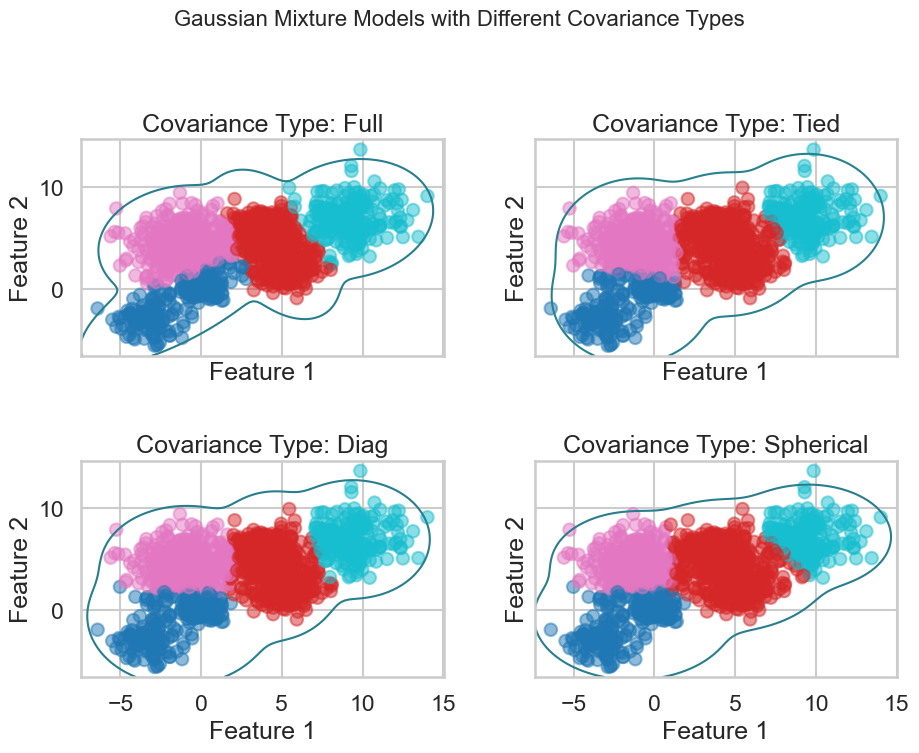

Log-likelihood for Full covariance type: -4.90
Log-likelihood for Tied covariance type: -5.00
Log-likelihood for Diag covariance type: -4.99
Log-likelihood for Spherical covariance type: -5.02


In [148]:

# Define the make_ellipses function
def make_ellipses(gmm, ax):
    for n, color in enumerate(colors):
        if gmm.covariance_type == "full":
            covariances = gmm.covariances_[n][:2, :2]
        elif gmm.covariance_type == "tied":
            covariances = gmm.covariances_[:2, :2]
        elif gmm.covariance_type == "diag":
            covariances = np.diag(gmm.covariances_[n][:2])
        elif gmm.covariance_type == "spherical":
            covariances = np.eye(gmm.means_.shape[1]) * gmm.covariances_[n]
        v, w = np.linalg.eigh(covariances)
        u = w[0] / np.linalg.norm(w[0])
        angle = np.arctan2(u[1], u[0])
        angle = 180 * angle / np.pi  # convert to degrees
        v = 2.0 * np.sqrt(2.0) * np.sqrt(v)
        ell = Ellipse(
            gmm.means_[n, :2], v[0], v[1], angle=180 + angle, color=color
        )
        ell.set_clip_box(ax.bbox)
        ell.set_alpha(0.5)
        ax.add_artist(ell)
        ax.set_aspect("equal", "datalim")


colors = ["purple", "pink", "grey"]
n_classes = len(np.unique(y))

# Set up GMM parameters
covariance_types = ["full", "tied", "diag", "spherical"]
n_estimators = len(covariance_types)

plt.figure(figsize=(4 * n_estimators, 8))
plt.subplots_adjust(wspace=0.4, hspace=0.4)

for index, cov_type in enumerate(covariance_types):
    # Fit GMM with the current covariance_type
    gmm = GaussianMixture(n_components=n_classes, covariance_type=cov_type, random_state=42)
    gmm.fit(Multi_blob_Data)

    # Plot data points
    plt.subplot(2, n_estimators, index + 1)
    for n, color in enumerate(sns.color_palette("deep")):
        data = Multi_blob_Data[y == n]
        plt.scatter(data[:, 0], data[:, 1], s=0.8, color=color, label=f"Class {n + 1}")

    # Plot GMM components
    make_ellipses(gmm, plt.gca())
    plt.title(f"GMM with Cov Type: {cov_type}")
    plt.xticks(())
    plt.yticks(())



# Create a dictionary to store log-likelihoods for each covariance type
log_likelihoods = {}

# Set up GMM parameters
covariance_types = ["full", "tied", "diag", "spherical"]
n_estimators = len(covariance_types)

# Create subplots with shared axes
fig, axes = plt.subplots(2, 2, figsize=(10, 8), sharex=True, sharey=True)
fig.suptitle("Gaussian Mixture Models with Different Covariance Types", fontsize=16)

for i, cov_type in enumerate(covariance_types, 1):
    # Create and fit GMM model
    gmm = GaussianMixture(n_components=4, covariance_type=cov_type, random_state=0)
    gmm.fit(Multi_blob_Data)
    
    # Compute log-likelihood and store it in the dictionary
    log_likelihoods[cov_type] = gmm.score(Multi_blob_Data)
    
    # Generate grid points to evaluate the density
    x_min, x_max = Multi_blob_Data[:, 0].min() - 1, Multi_blob_Data[:, 0].max() + 1
    y_min, y_max = Multi_blob_Data[:, 1].min() - 1, Multi_blob_Data[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 100), np.linspace(y_min, y_max, 100))
    Z = -gmm.score_samples(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    
    # Plot data points
    axes.flatten()[i - 1].scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], marker='o', c=gmm.predict(Multi_blob_Data), cmap='tab10', alpha=0.5)
    
    # Plot contour plot
    contour = axes.flatten()[i - 1].contour(xx, yy, Z, levels=10, linewidths=1.5, cmap='viridis', norm=LogNorm(vmin=Z.min(), vmax=Z.max()))
    axes.flatten()[i - 1].set_title(f'Covariance Type: {cov_type.capitalize()}')
    axes.flatten()[i - 1].set_xlabel('Feature 1')
    axes.flatten()[i - 1].set_ylabel('Feature 2')


plt.tight_layout(pad=2)  
plt.show()

# Print log-likelihoods
for covariance_type, log_likelihood in log_likelihoods.items():
    print(f'Log-likelihood for {covariance_type.capitalize()} covariance type: {log_likelihood:.2f}')



## iris data set 
The iris data set is test data set that is part of the Sklearn module 
which contains 150 records each with 4 features. All the features are represented by real numbers 

The data represents three classes 


In [157]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X,km=[],num_clusters=0):
    color = 'brgcmyk'  #List colors
    alpha = 0.5  #color obaque
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1],c = color[i],alpha = alpha,s=s)
            plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c = color[i], marker = 'x', s = 100)

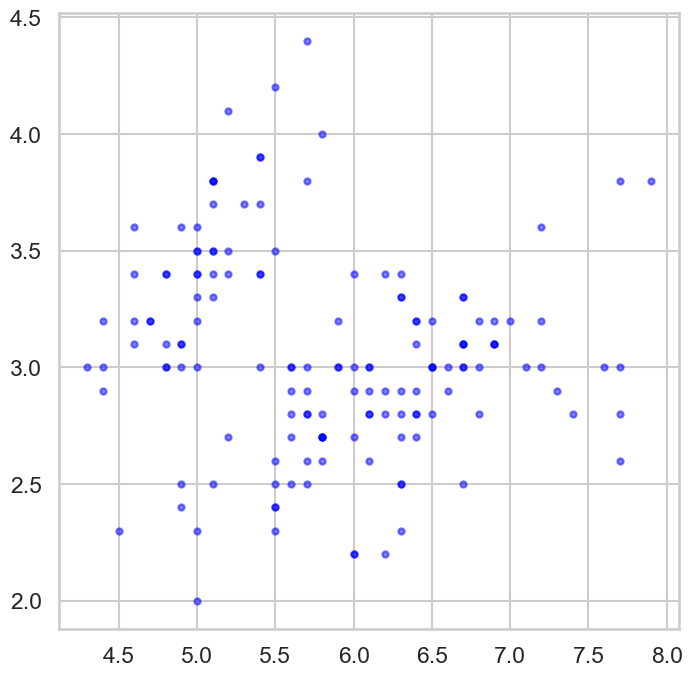

In [158]:
from sklearn.datasets import load_iris
iris_data = load_iris()
iris_data.target[[10, 25, 50]]
#array([0, 0, 1])
list(iris_data.target_names)
['setosa', 'versicolor', 'virginica']
display_cluster(iris_data.data)

## KMEANS

In [151]:
def display_cluster(data_points, km=None, num_clusters=None, alpha=0.7, s=50, feature_names=None):
    color = plt.cm.rainbow(np.linspace(0, 1, num_clusters))
    vars = len(data_points[0])
    fig, axs = plt.subplots(vars, vars, figsize=(25, 25))
    
    if km is not None:
        for i in range(num_clusters):
            cluster_points = data_points[km == i, :]
            for j in range(vars):
                for k in range(vars):
                    axs[j, k].scatter(cluster_points[:, j], cluster_points[:, k], c=[color[i]], alpha=alpha, s=s, label=f'Cluster {i}')
                    axs[j, k].scatter(np.mean(cluster_points[:, j]), np.mean(cluster_points[:, k]), c=color[i], marker='x', s=100, label=f'Centroid {i}')
                    axs[j, k].set_xlabel(feature_names[j])
                    axs[j, k].set_ylabel(feature_names[k])
                    axs[j, k].legend()
    else:
        plt.scatter(data_points[:, 0], data_points[:, 1], c='b', alpha=alpha, s=s, label='Data Points')
        plt.title('K-means Clustering Result')
        plt.xlabel(feature_names[0])
        plt.ylabel(feature_names[1])
        plt.legend()

    plt.show()



[0 0 1]
['setosa', 'versicolor', 'virginica']


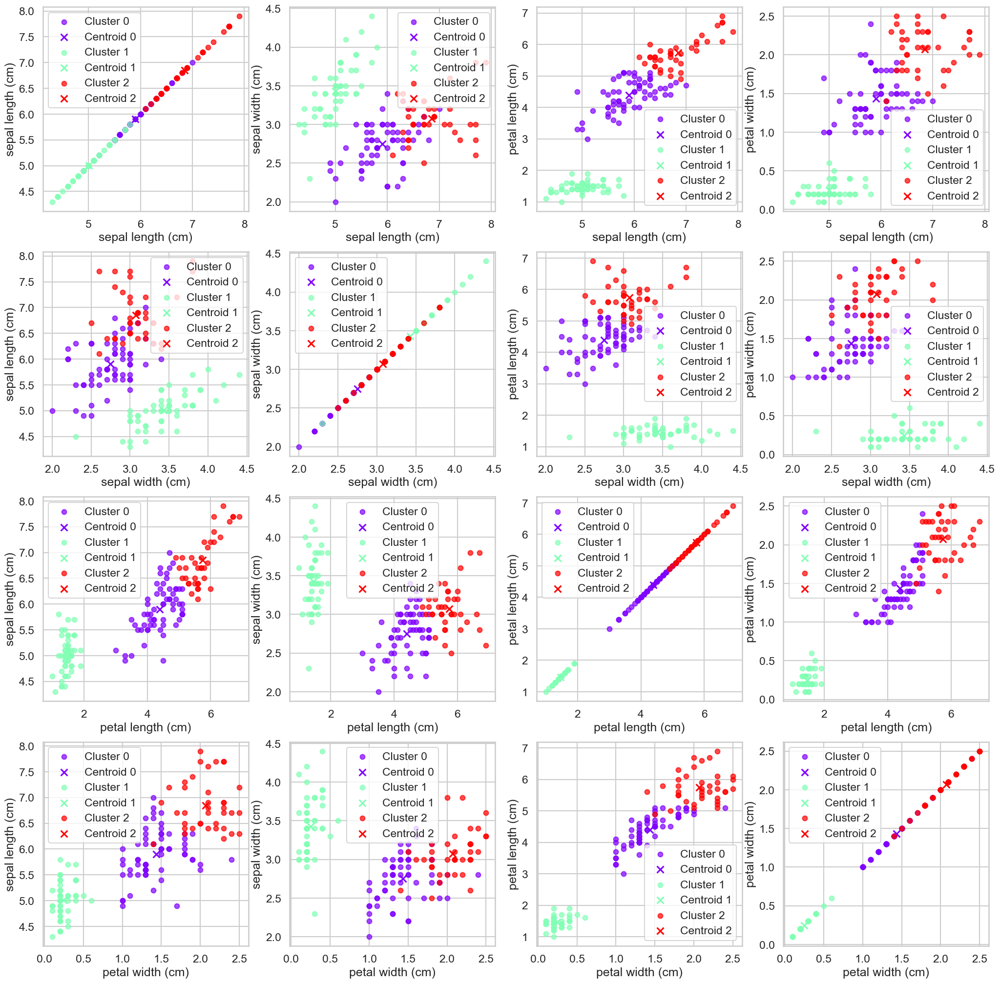

In [152]:

# Load Iris dataset
iris_data = load_iris()

# Select specific data points
selected_points = [10, 25, 50]
selected_targets = iris_data.target[selected_points]

# Display selected targets
print(selected_targets)
# array([0, 0, 1])

# Display target names
print(list(iris_data.target_names))
# ['setosa', 'versicolor', 'virginica']

# Extract features
iris_features = iris_data.data

# Perform KMeans clustering
kmeans = KMeans(n_clusters=3, random_state=42)
kmeans.fit(iris_features)

# Get feature names
feature_names = iris_data.feature_names

# Use the modified display_cluster function to visualize the result
display_cluster(iris_features, km=kmeans.labels_, num_clusters=3, feature_names=feature_names)


The best K based on Silhouette Score: 2
Silhouette Score for the best K: 0.5817500491982808


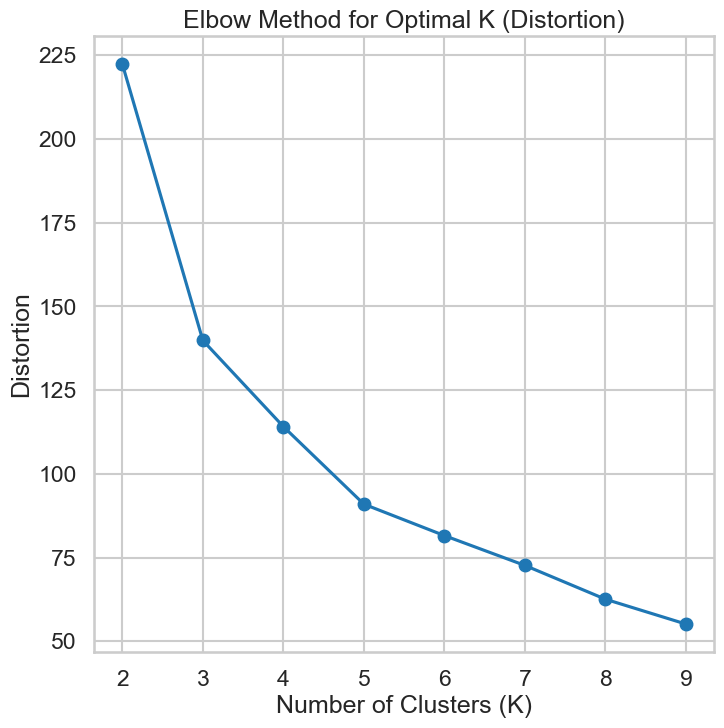

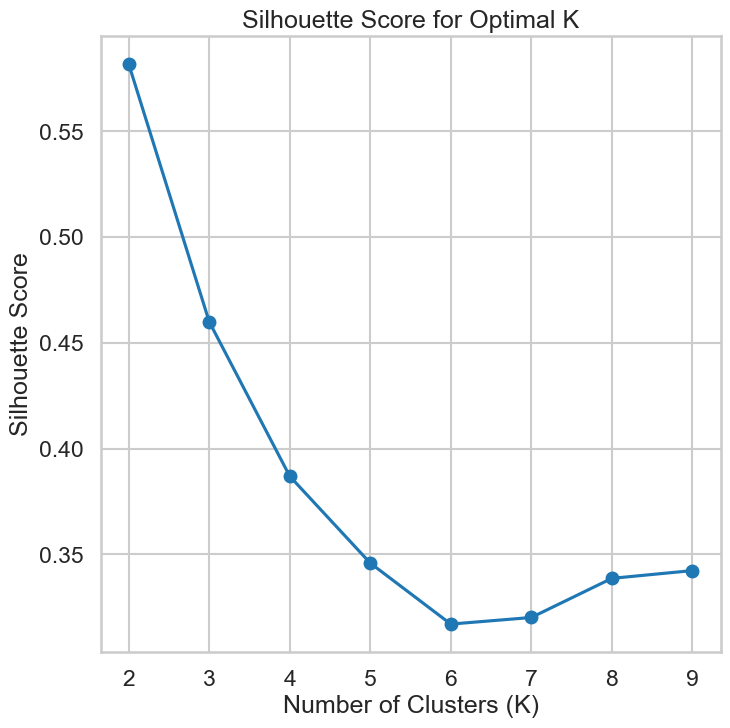

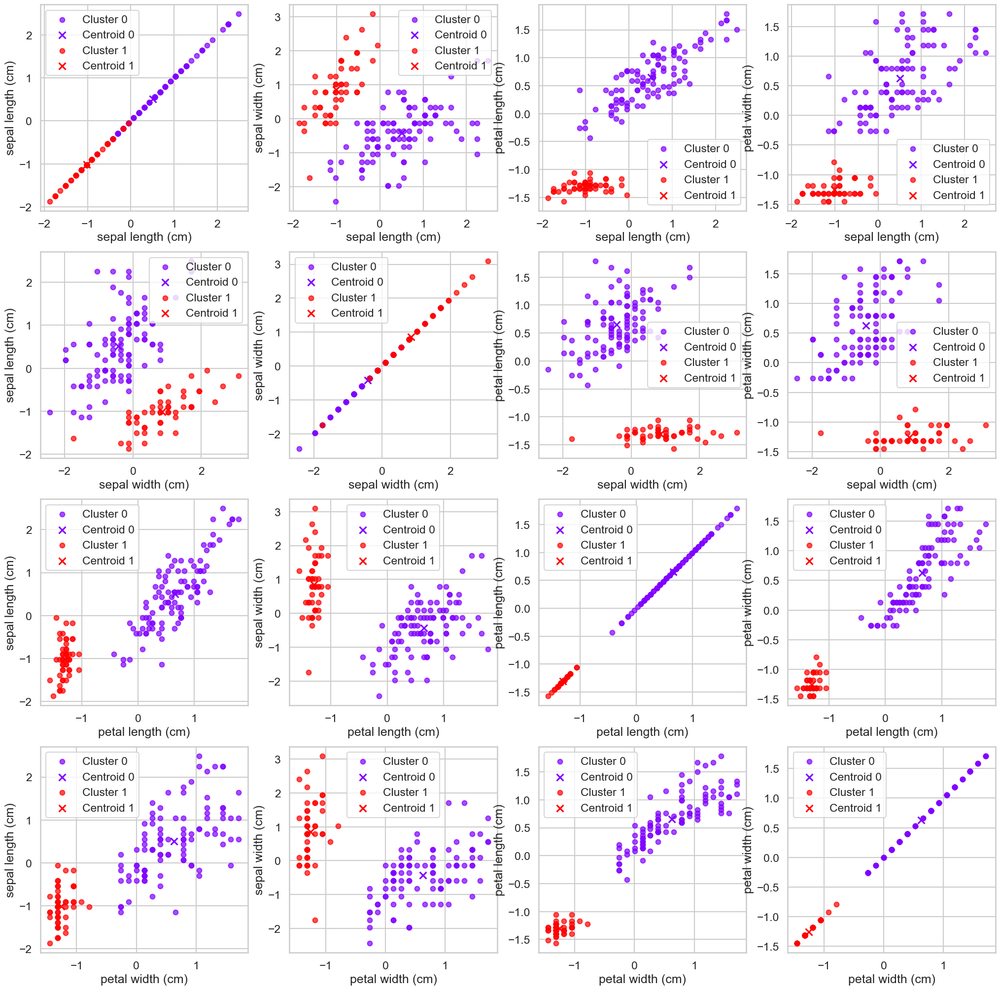

In [153]:

# Load Iris dataset
iris_data = load_iris()

# Extract features and feature names
iris_features = iris_data.data
feature_names = iris_data.feature_names

# Standardize the features
scaler = StandardScaler()
iris_features_std = scaler.fit_transform(iris_features)

# Specify K values to try
k_values = range(2, 10)

# Lists to store results
distortions = []
silhouette_scores = []

# Perform KMeans clustering for each value of K
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(iris_features_std)
    
    # Calculate distortion and silhouette_score
    distortions.append(kmeans.inertia_)
    silhouette_avg = silhouette_score(iris_features_std, kmeans.labels_)
    silhouette_scores.append(silhouette_avg)
    
# Plot distortion function versus K
plt.figure()
plt.plot(k_values, distortions, marker='o')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Distortion')
plt.title('Elbow Method for Optimal K (Distortion)')

# Plot silhouette_score versus K
plt.figure()
plt.plot(k_values, silhouette_scores, marker='o')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for Optimal K')

# Find the best K based on silhouette_score
best_k = k_values[np.argmax(silhouette_scores)]
print(f'The best K based on Silhouette Score: {best_k}')

# Perform KMeans clustering with the best K
best_kmeans = KMeans(n_clusters=best_k, random_state=42)
best_kmeans.fit(iris_features_std)

# Store silhouette_score for the best K
best_silhouette_score = silhouette_score(iris_features_std, best_kmeans.labels_)
print(f'Silhouette Score for the best K: {best_silhouette_score}')

# Use the modified display_cluster function to visualize the result with the best K
display_cluster(iris_features_std, km=best_kmeans.labels_, num_clusters=best_k, feature_names=feature_names)
plt.show()


## Heirarchal clustering

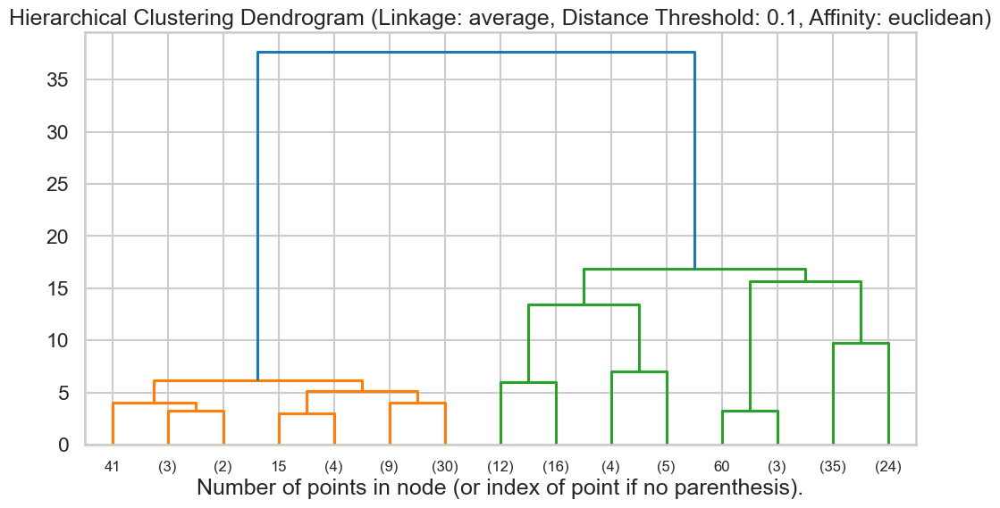

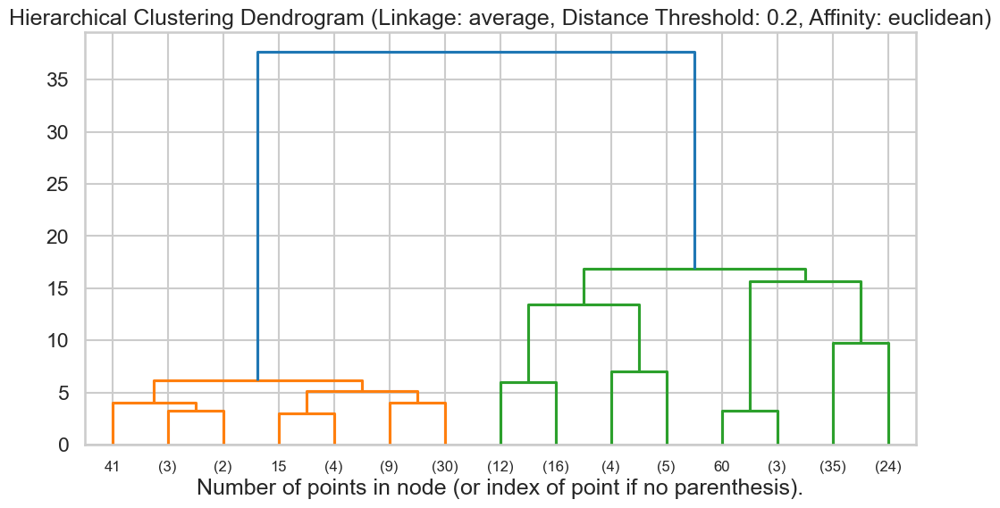

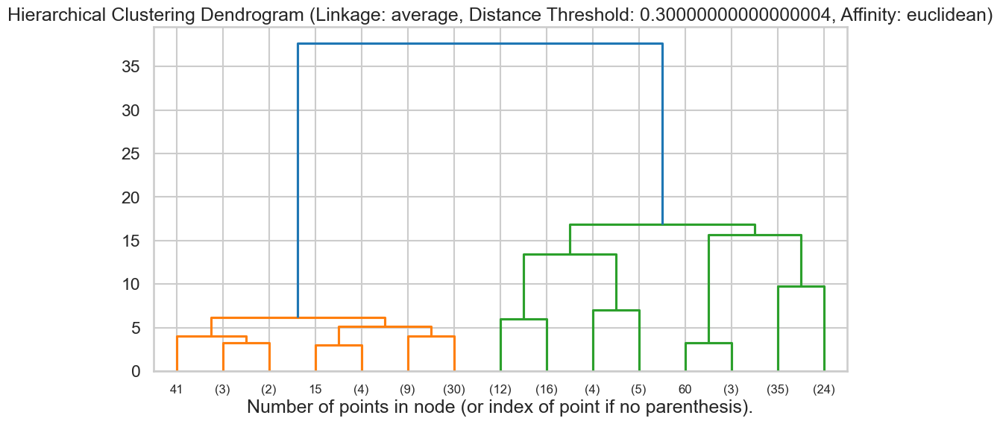

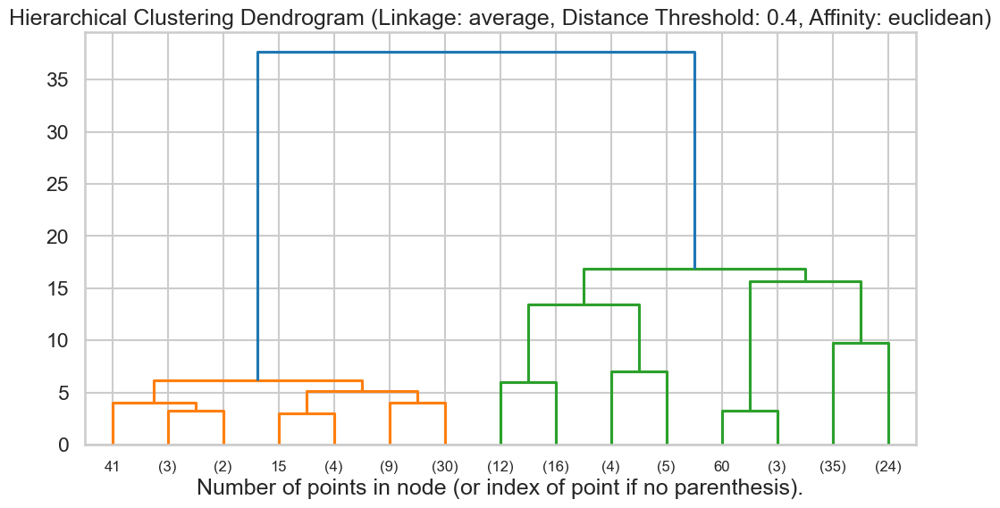

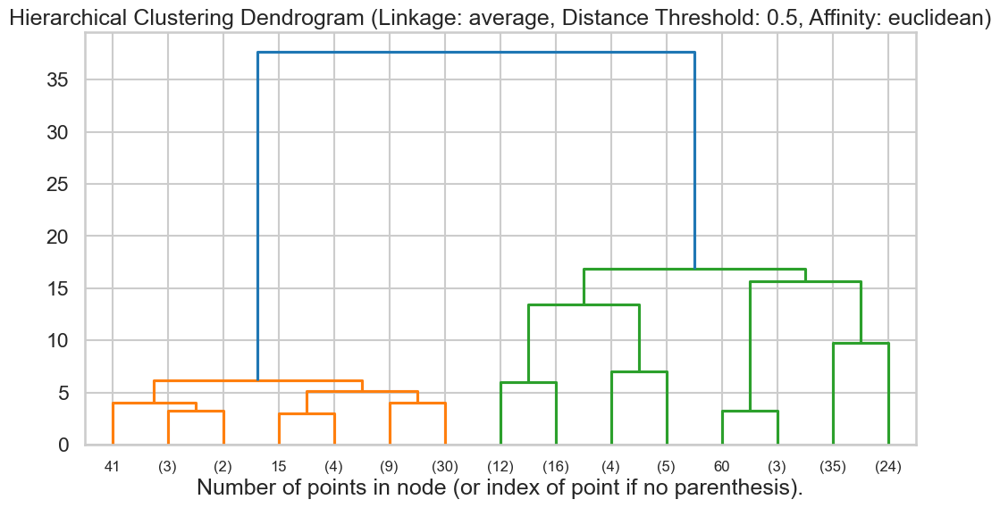

...

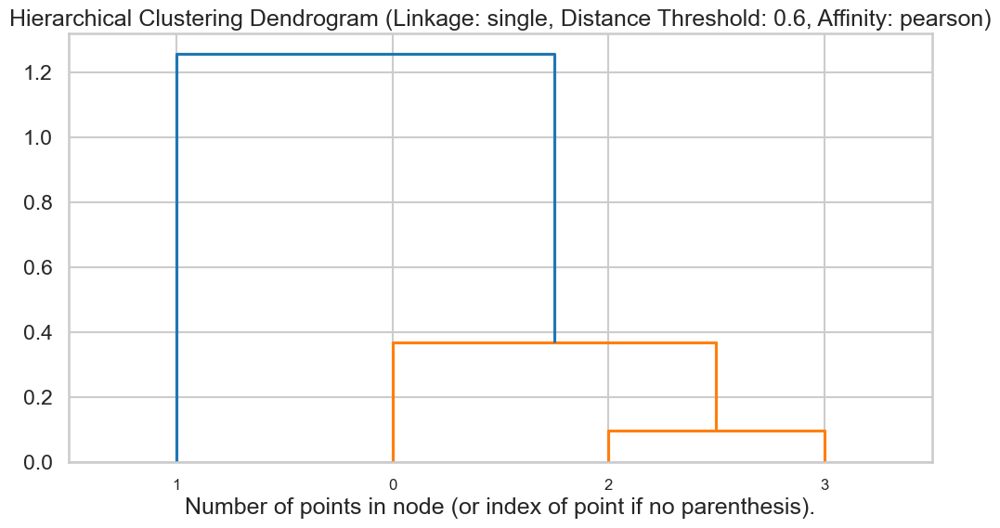

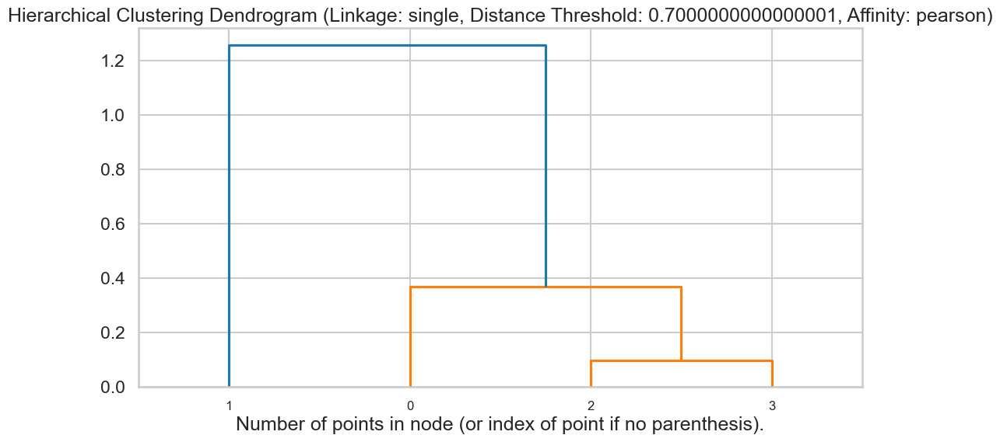

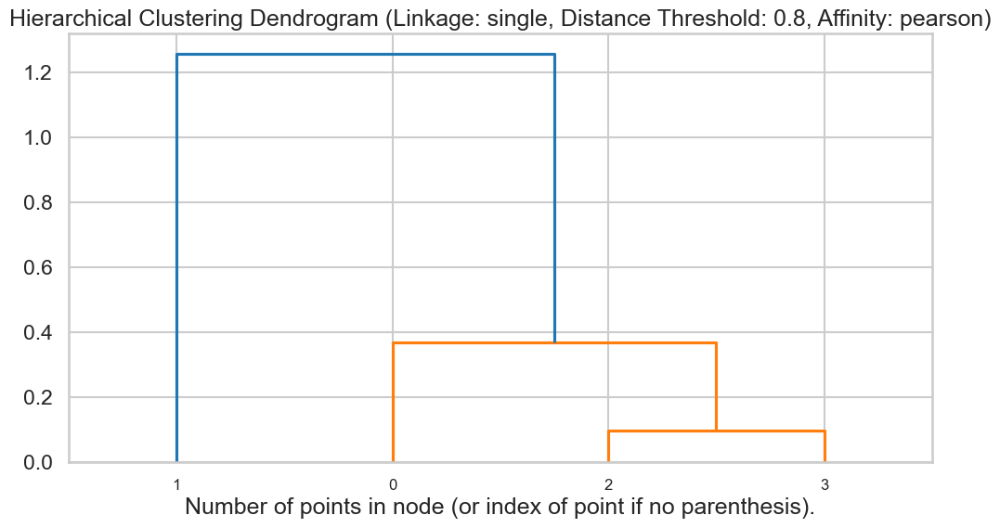

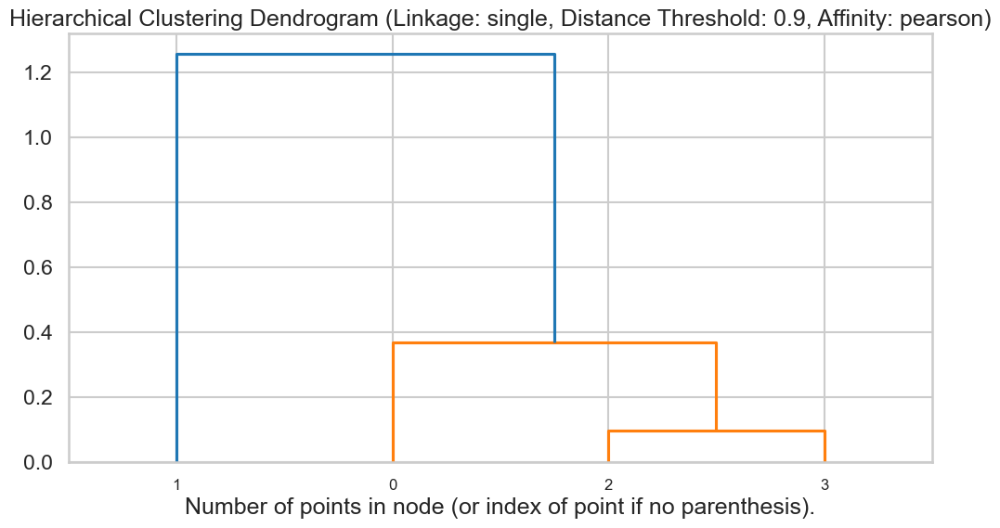

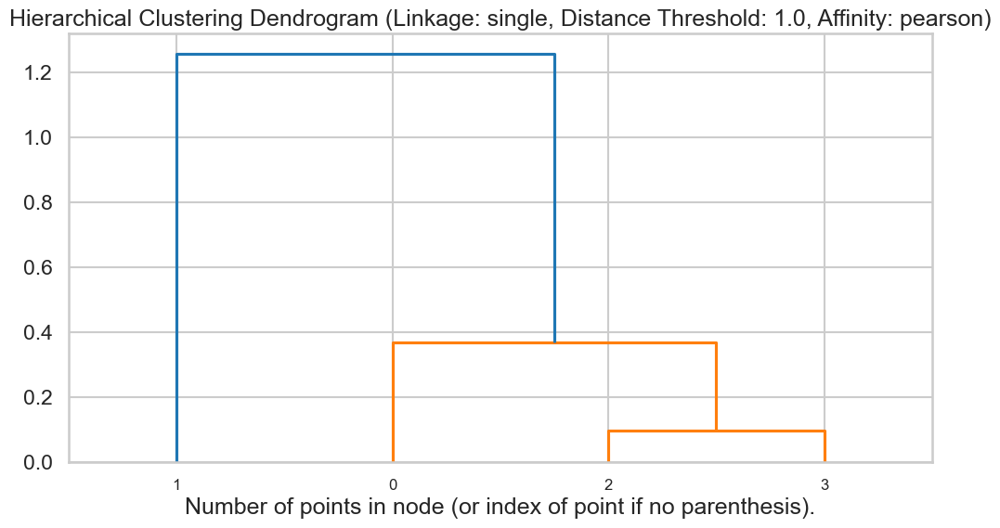

In [160]:
iris_data = load_iris()
X_iris = iris_data.data
feature_names_iris = iris_data.feature_names

# Perform hierarchical clustering for each pair of features with a range of distance thresholds
for distance_metric in ['euclidean', 'cosine', 'cityblock', 'pearson']:
    for linkage_type in ['average', 'single']:
        for distance_threshold in np.linspace(0.1, 1.0, 10):
            hierarchical_clustering(
                X_iris,
                affinity=distance_metric,
                linkage_type=linkage_type,
                distance_threshold=distance_threshold
            )

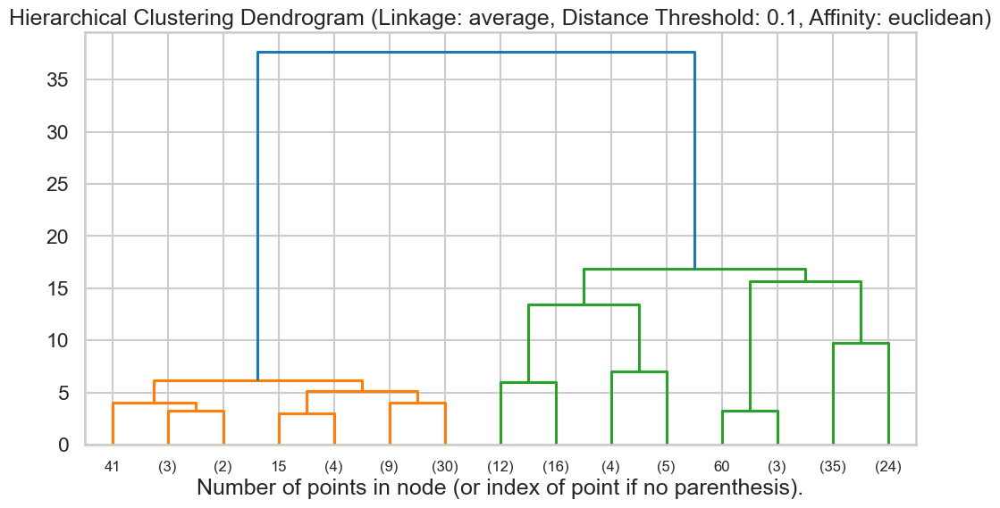

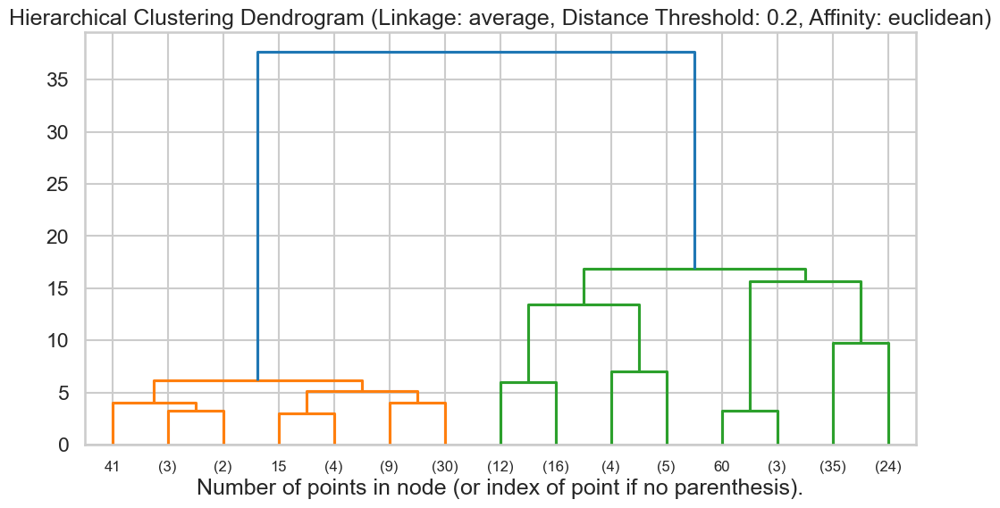

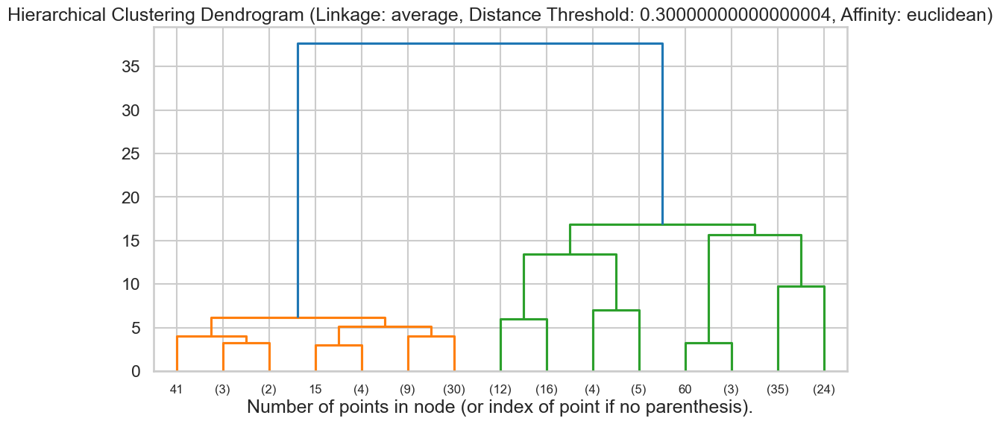

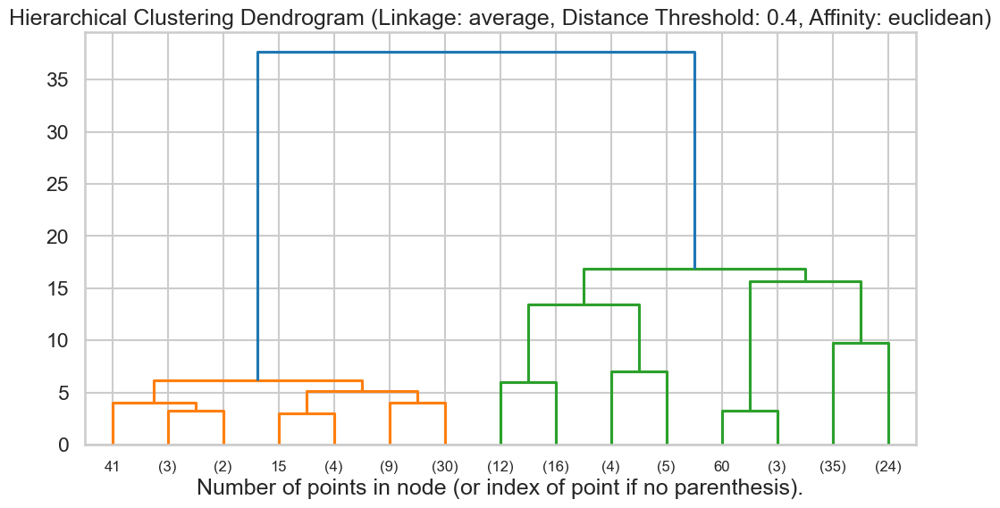

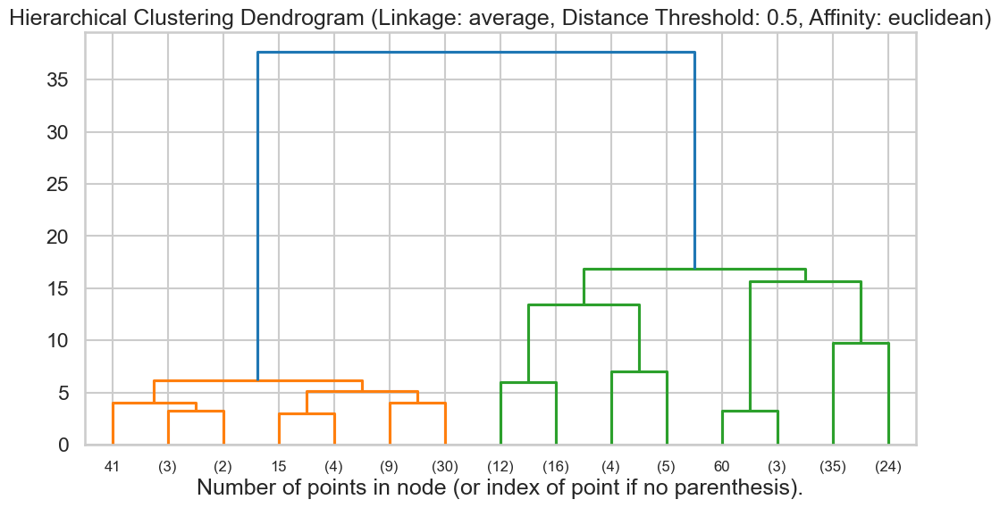

...

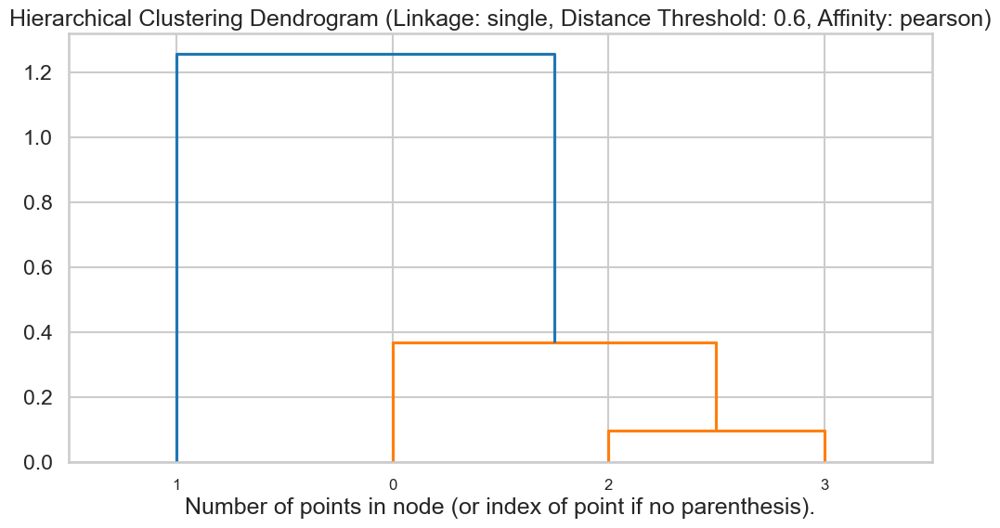

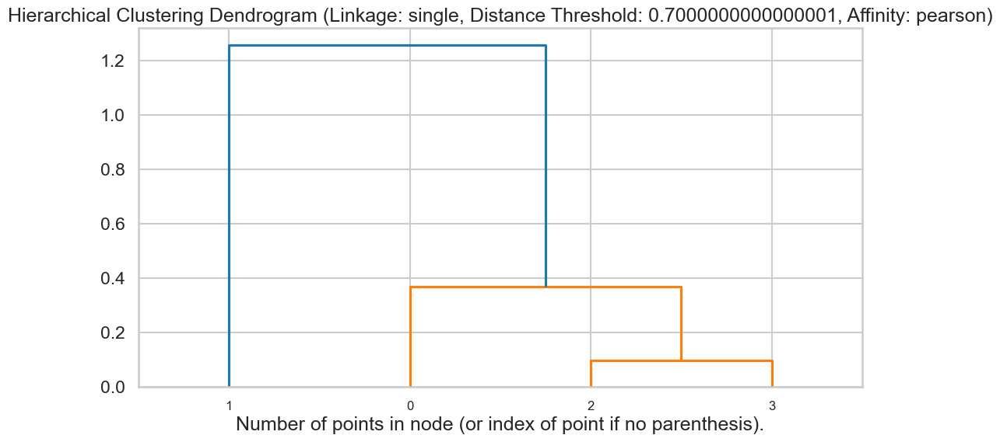

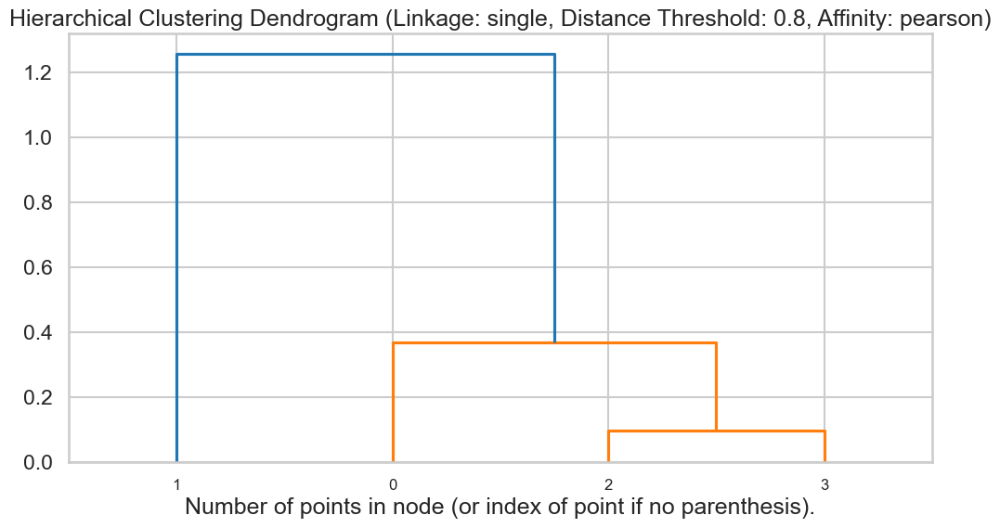

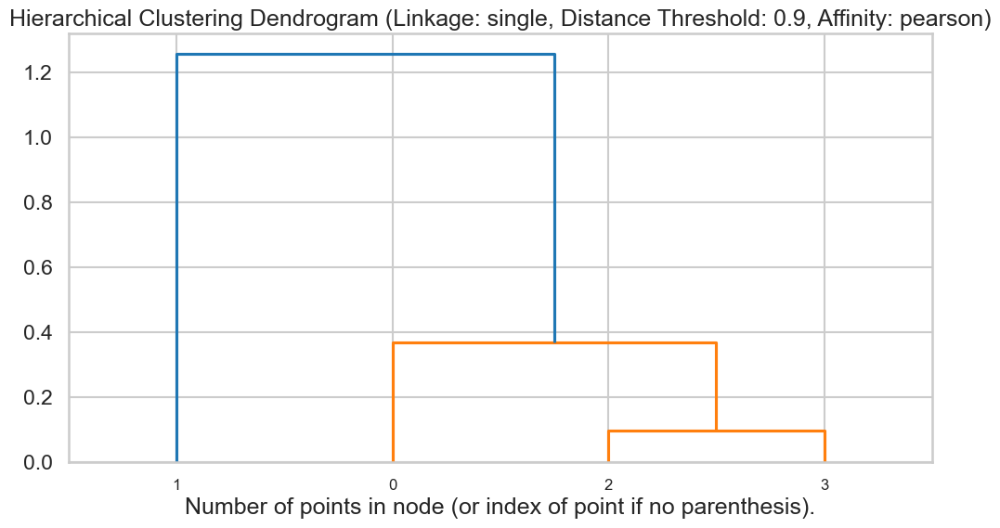

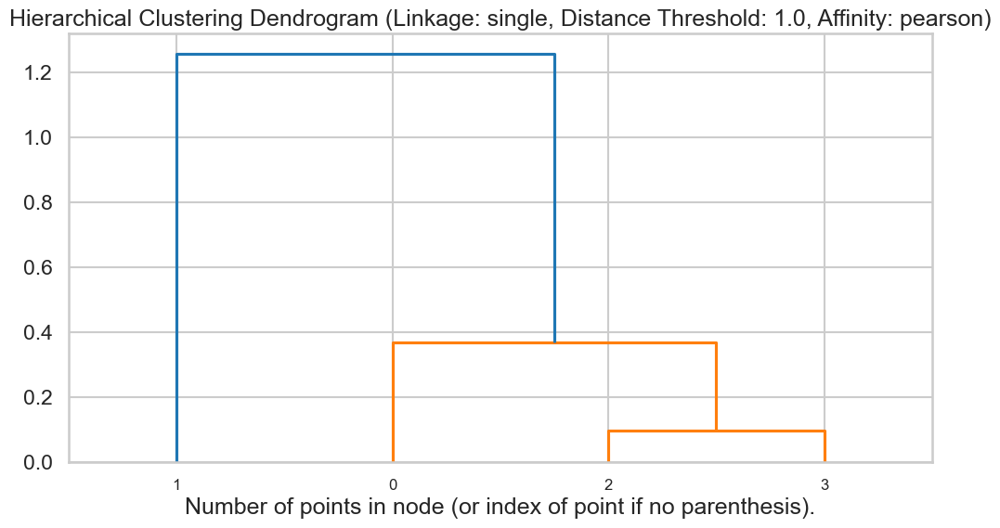


Best Parameters: {'distance_metric': 'euclidean', 'linkage_type': 'average', 'distance_threshold': 0.1}
Best Silhouette Score: 73.50666666666666


In [163]:

# Load Iris dataset
iris_data = load_iris()
X_iris = iris_data.data
feature_names_iris = iris_data.feature_names

best_silhouette_score = float('-inf')
best_params = None

# Perform hierarchical clustering for each pair of features with a range of distance thresholds
for distance_metric in ['euclidean', 'cosine', 'cityblock', 'pearson']:
    for linkage_type in ['average', 'single']:
        for distance_threshold in np.linspace(0.1, 1.0, 10):
            # Compute silhouette score
            silhouette_score_current = hierarchical_clustering(
                X_iris,
                affinity=distance_metric,
                linkage_type=linkage_type,
                distance_threshold=distance_threshold
            )

            # Check if the silhouette score is better than the current best
            if np.mean(silhouette_score_current) > np.mean(best_silhouette_score):
                best_silhouette_score = silhouette_score_current
                best_params = {
                    'distance_metric': distance_metric,
                    'linkage_type': linkage_type,
                    'distance_threshold': distance_threshold
                }

# Print the best parameters and silhouette score
print("\nBest Parameters:", best_params)
print("Best Silhouette Score:", np.mean(best_silhouette_score))





## DBScan

In [175]:
def display_dbscan_clusters(data_points, dbscan=None, alpha=0.7, s=50, feature_names=None):
    if dbscan is not None:
        labels = dbscan.fit_predict(data_points)
        unique_labels = set(labels)
        num_clusters = len(unique_labels) - (1 if -1 in labels else 0)

        color = plt.cm.rainbow(np.linspace(0, 1, num_clusters))
        vars = len(data_points[0])
        fig, axs = plt.subplots(vars, vars, figsize=(25, 25))

        for i in unique_labels:
            if i == -1 or np.sum(labels == i) == 0:
                continue  # Skip noise points and clusters with no points
            cluster_points = data_points[labels == i, :]
            for j in range(vars):
                for k in range(vars):
                    axs[j, k].scatter(cluster_points[:, j], cluster_points[:, k], c=[color[i]], alpha=alpha, s=s, label=f'Cluster {i}')

                    # Remove the centroid marker and label
                    axs[j, k].set_xlabel(feature_names[j])
                    axs[j, k].set_ylabel(feature_names[k])
                    axs[j, k].legend()

        plt.show()


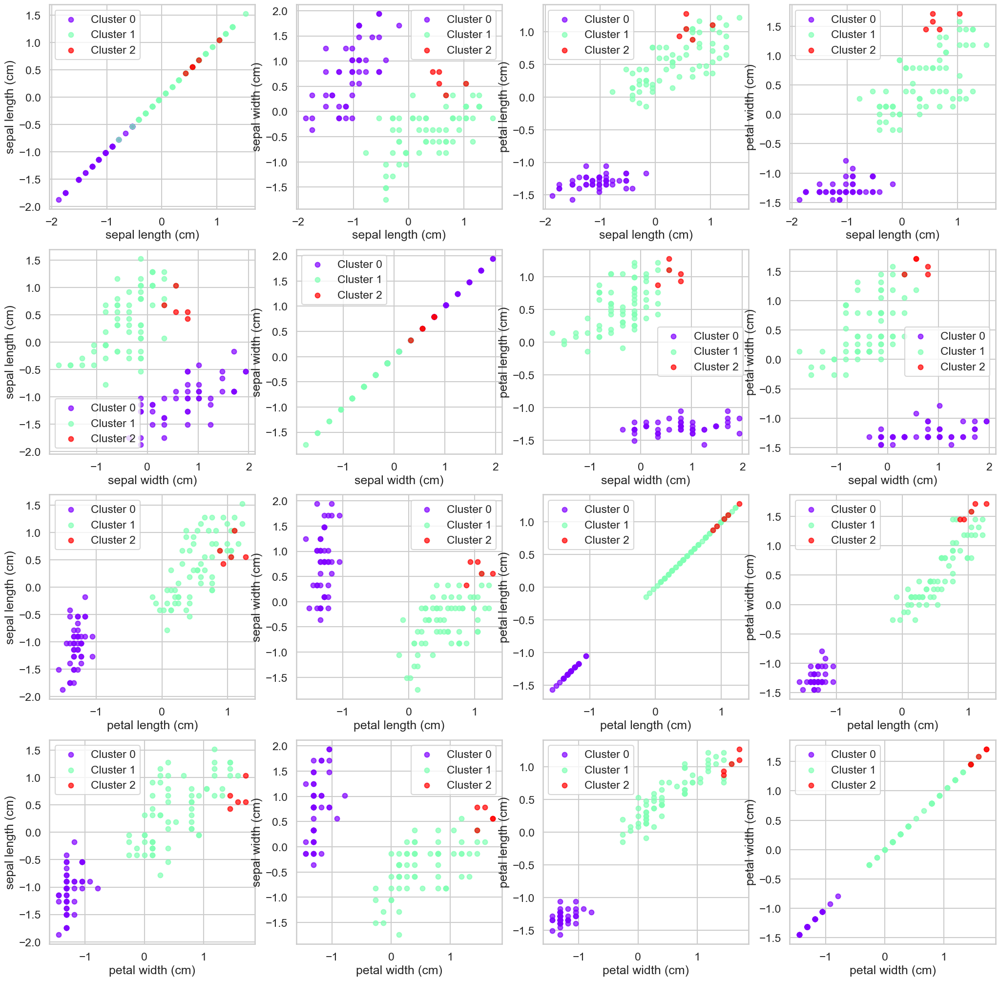

Best EPS: 0.6, Best Min_samples: 11
Best Silhouette Score: 0.2354813977987615
Best Number of Clusters: 3
Number of Noise Points: 35


In [177]:
# Load Iris dataset
iris_data = load_iris()
data = iris_data.data

# Standardize the data
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data)

# Define the best parameters
best_eps = 0.6
best_min_samples = 11

# Apply DBScan with the best parameters
best_dbscan = DBSCAN(eps=best_eps, min_samples=best_min_samples)
best_labels = best_dbscan.fit_predict(data_scaled)
feature_names_iris = iris_data.feature_names

# Display DBScan clusters with all features
feature_names = [f'Feature {i+1}' for i in range(data_scaled.shape[1])]
display_dbscan_clusters(data_scaled, dbscan=best_dbscan, feature_names=iris_data.feature_names)

# Print the best parameters and corresponding silhouette score
silhouette_avg = silhouette_score(data_scaled, best_labels)
num_clusters = len(set(best_labels)) - (1 if -1 in best_labels else 0)
num_noise_points = np.sum(best_labels == -1)

print(f"Best EPS: {best_eps}, Best Min_samples: {best_min_samples}")
print(f"Best Silhouette Score: {silhouette_avg}")
print(f"Best Number of Clusters: {num_clusters}")
print(f"Number of Noise Points: {num_noise_points}")


In [178]:
# import numpy as np
# import matplotlib.pyplot as plt
# from sklearn.cluster import DBSCAN
# from sklearn.metrics import silhouette_score
# from sklearn.datasets import load_iris
# from sklearn.preprocessing import StandardScaler

# # Function to perform DBScan clustering and plot silhouette_score
# def perform_dbscan(data, eps_range, min_samples_range):
#     silhouette_scores = np.zeros((len(eps_range), len(min_samples_range)))

#     for i, eps in enumerate(eps_range):
#         for j, min_samples in enumerate(min_samples_range):
#             dbscan = DBSCAN(eps=eps, min_samples=min_samples)
#             labels = dbscan.fit_predict(data)
            
#             # Exclude outliers (-1) from silhouette score calculation
#             if len(set(labels)) > 1:
#                 silhouette_avg = silhouette_score(data, labels)
#                 silhouette_scores[i, j] = silhouette_avg

#     return silhouette_scores

# # Load Iris dataset
# iris_data = load_iris()
# data = iris_data.data
# feature_names = iris_data.feature_names

# # Standardize the data
# scaler = StandardScaler()
# data_scaled = scaler.fit_transform(data)

# # Define the range of parameters to search
# eps_range = np.arange(0.1, 3.1, 0.1)
# min_samples_range = np.arange(5, 26, 1)

# # Create subplots
# fig, axs = plt.subplots(4, 4, figsize=(20, 20))
# fig.subplots_adjust(hspace=0.5, wspace=0.5)

# # Iterate through each feature combination
# for i in range(4):
#     for j in range(4):
#         feature_indices = [i, j]
#         feature_names_subplot = [feature_names[feature_indices[0]], feature_names[feature_indices[1]]]
        
#         # Perform DBScan with varying parameters
#         silhouette_scores = perform_dbscan(data_scaled[:, feature_indices], eps_range, min_samples_range)
        
#         # Find the indices of the maximum silhouette score
#         best_indices = np.unravel_index(np.argmax(silhouette_scores), silhouette_scores.shape)
#         best_eps, best_min_samples, best_silhouette_score = eps_range[best_indices[0]], min_samples_range[best_indices[1]], silhouette_scores[best_indices]

#         # Apply DBScan with the best parameters and display clusters
#         best_dbscan = DBSCAN(eps=best_eps, min_samples=best_min_samples)
#         labels = best_dbscan.fit_predict(data_scaled[:, feature_indices])

#         # Count the number of clusters (excluding noise)
#         num_clusters = len(set(labels)) - (1 if -1 in labels else 0)
#         num_noise_points = np.sum(labels == -1)

#         # Plot the clusters
#         scatter = axs[i, j].scatter(data_scaled[:, feature_indices[0]], data_scaled[:, feature_indices[1]], c=labels, cmap='viridis', alpha=0.5)
#         axs[i, j].set_title(f'{feature_names_subplot[0]} vs {feature_names_subplot[1]}')
#         axs[i, j].set_xlabel(feature_names_subplot[0])
#         axs[i, j].set_ylabel(feature_names_subplot[1])

#         # Print the results for each plot
#         axs[i, j].text(0.5, -0.2,
#                        f"Best EPS: {best_eps:.2f}\nBest Min_samples: {best_min_samples}\nBest Silhouette Score: {best_silhouette_score:.2f}\n"
#                        f"Best Number of Clusters: {num_clusters}\nNumber of Noise Points: {num_noise_points}",
#                        size=8, ha="center", transform=axs[i, j].transAxes)

# # Rotate x-axis labels for better visibility
# for ax in axs.flat:
#     ax.label_outer()
#     ax.tick_params(axis='x', labelrotation=45)

# plt.show()


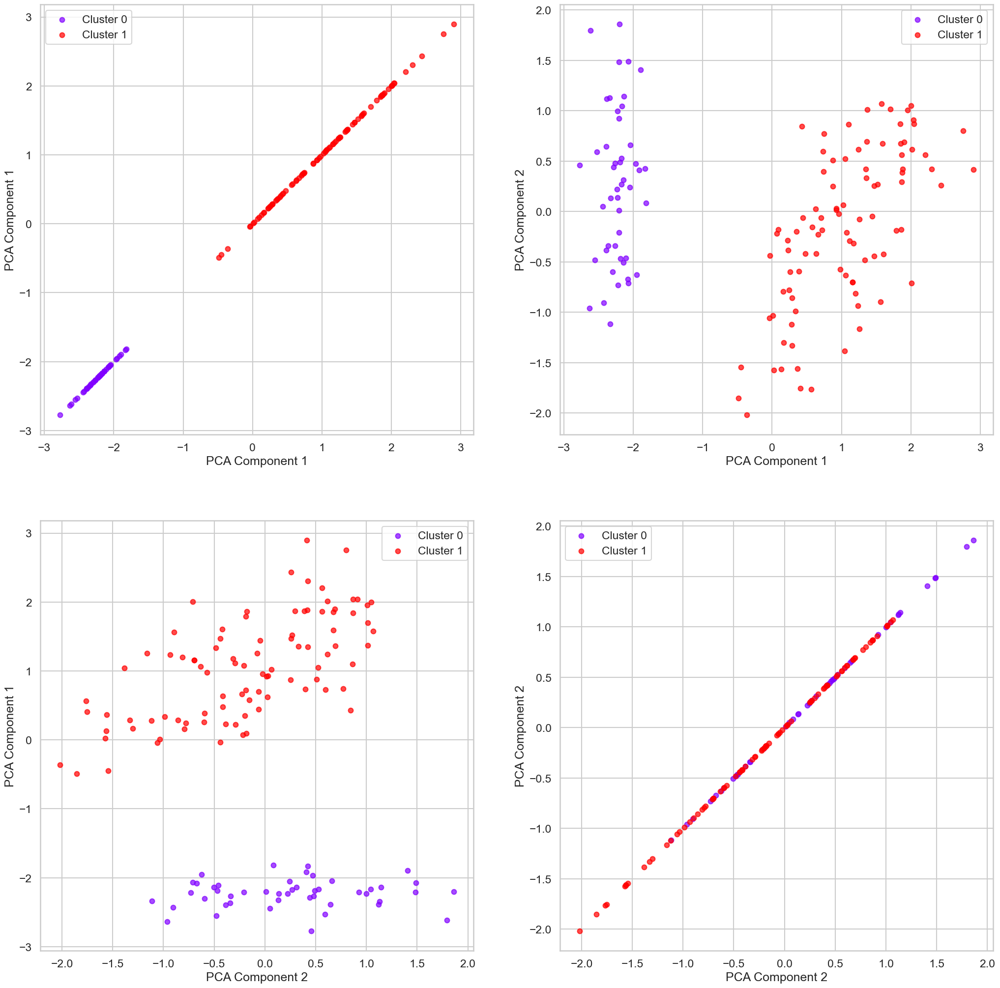

Best EPS: 0.6, Best Min_samples: 11
Best Silhouette Score: 0.5243209397065848
Best Number of Clusters: 2
Number of Noise Points: 11


In [179]:
from sklearn.decomposition import PCA

# Load Iris dataset
iris_data = load_iris()
data = iris_data.data

# Standardize the data
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data)

# Apply PCA
pca = PCA(n_components=2)
data_pca = pca.fit_transform(data_scaled)

# Define the best parameters
best_eps = 0.6
best_min_samples = 11

# Apply DBScan with the best parameters
best_dbscan = DBSCAN(eps=best_eps, min_samples=best_min_samples)
best_labels = best_dbscan.fit_predict(data_pca)

# Display DBScan clusters with PCA features
feature_names_pca = [f'PCA Component {i+1}' for i in range(data_pca.shape[1])]
display_dbscan_clusters(data_pca, dbscan=best_dbscan, feature_names=feature_names_pca)

# Print the best parameters and corresponding silhouette score
silhouette_avg = silhouette_score(data_pca, best_labels)
num_clusters = len(set(best_labels)) - (1 if -1 in best_labels else 0)
num_noise_points = np.sum(best_labels == -1)

print(f"Best EPS: {best_eps}, Best Min_samples: {best_min_samples}")
print(f"Best Silhouette Score: {silhouette_avg}")
print(f"Best Number of Clusters: {num_clusters}")
print(f"Number of Noise Points: {num_noise_points}")


## Gaussian Mixture


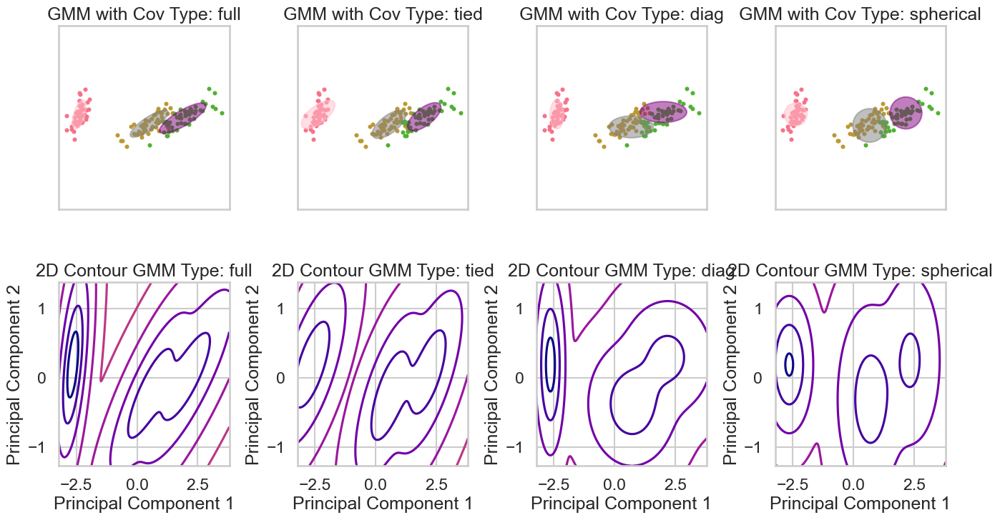

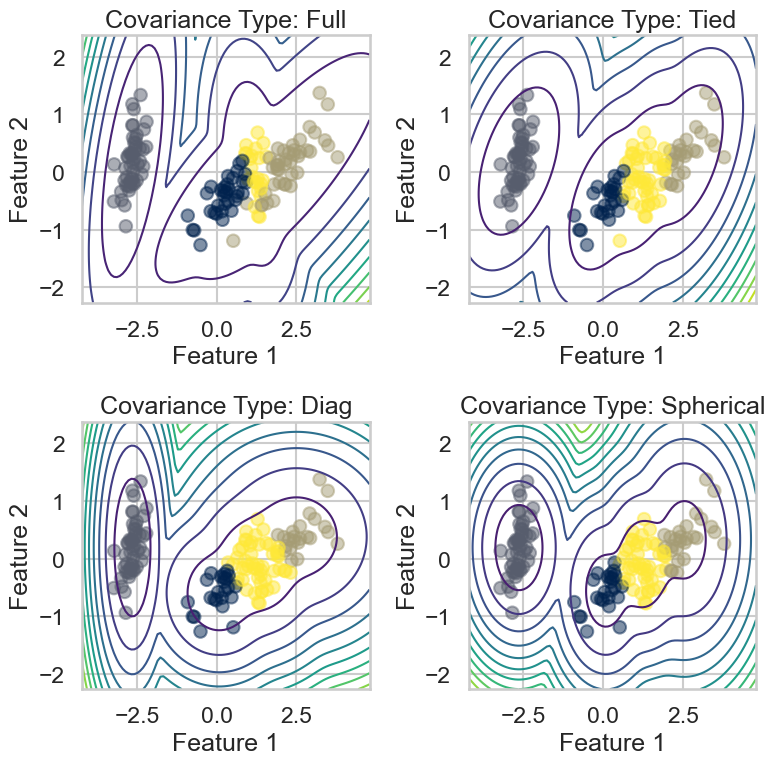

Log-likelihood for Full covariance type: -1.86
Log-likelihood for Tied covariance type: -2.08
Log-likelihood for Diag covariance type: -2.02
Log-likelihood for Spherical covariance type: -2.15


In [192]:
# Load Iris dataset
iris_data = load_iris()
iris_features = iris_data.data

# Apply PCA to reduce the dataset to 2 dimensions
pca = PCA(n_components=2)
iris_features_pca = pca.fit_transform(iris_features)

# Set up GMM parameters
covariance_types = ["full", "tied", "diag", "spherical"]
n_estimators = len(covariance_types)


# ... (previous code)

plt.figure(figsize=(4 * n_estimators, 8))
plt.subplots_adjust(wspace=0.4, hspace=0.4)

for index, cov_type in enumerate(covariance_types):
    # Fit GMM with the current covariance_type
    gmm = GaussianMixture(n_components=len(np.unique(iris_data.target)),
                          covariance_type=cov_type,
                          random_state=42)
    gmm.fit(iris_features_pca)

    # Plot data points
    plt.subplot(2, n_estimators, index + 1)
    for n, color in enumerate(sns.color_palette("husl")):  # Change color palette to 'husl'
        data = iris_features_pca[iris_data.target == n]
        plt.scatter(data[:, 0], data[:, 1], s=8, color=color, label=f"Class {n + 1}")

    # Plot GMM components
    make_ellipses(gmm, plt.gca())
    plt.title(f"GMM with Cov Type: {cov_type}")
    plt.xticks(())
    plt.yticks(())

    # Plot 2D contour plot of the GMM
    plt.subplot(2, n_estimators, index + n_estimators + 1)
    h = plt.gca()
    x, y = np.meshgrid(np.linspace(iris_features_pca[:, 0].min(), iris_features_pca[:, 0].max(), 500),
                       np.linspace(iris_features_pca[:, 1].min(), iris_features_pca[:, 1].max(), 500))
    xy = np.column_stack((x.ravel(), y.ravel()))
    z = -gmm.score_samples(xy)
    z = z.reshape(x.shape)
    plt.contour(x, y, z, norm=LogNorm(vmin=1.0, vmax=1000.0), levels=np.logspace(0, 3, 10), cmap='plasma')  # Change color map to 'plasma'
    plt.title(f"2D Contour GMM Type: {cov_type}")
    plt.xlabel("Principal Component 1")
    plt.ylabel("Principal Component 2")

plt.show()

log_likelihoods = {}

for i, covariance_type in enumerate(covariance_types, 1):
    # Create and fit GMM model
    gmm = GaussianMixture(n_components=4, covariance_type=covariance_type, random_state=0)
    gmm.fit(iris_features_pca)
    
    log_likelihoods[covariance_type] = gmm.score(iris_features_pca)
    
    # Generate grid points to evaluate the density
    x_min, x_max = iris_features_pca[:, 0].min() - 1, iris_features_pca[:, 0].max() + 1
    y_min, y_max = iris_features_pca[:, 1].min() - 1, iris_features_pca[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 100), np.linspace(y_min, y_max, 100))
    Z = -gmm.score_samples(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    
    # Plot contour plot
    plt.subplot(2, 2, i)
    plt.scatter(iris_features_pca[:, 0], iris_features_pca[:, 1], marker='o', c=gmm.predict(iris_features_pca), cmap='cividis', alpha=0.5)  # Change color map to 'cividis'
    plt.contour(xx, yy, Z, levels=10, linewidths=1.5, cmap='viridis')  # Change color map to 'viridis'
    plt.title(f'Covariance Type: {covariance_type.capitalize()}')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')

plt.tight_layout()
plt.show()

for covariance_type, log_likelihood in log_likelihoods.items():
    print(f'Log-likelihood for {covariance_type.capitalize()} covariance type: {log_likelihood:.2f}')


* Repeat all the above clustering approaches and steps on the above data 
* Normalize the data then repeat all the above steps 
* Compare between the different clustering approaches 

## Customer dataset
Repeat all the above on the customer data set 

In [221]:
dataset = pd.read_csv('C:/Users/hp/Desktop/Semester 10/(NETW 1013) Machine Learning/Machine Learning Submission 1/Customer data.csv')


In [222]:
dataset.head()

,ID,Sex,Marital status,Age,Education,Income,Occupation,Settlement size
0,100000001,0,0,67,2,124670,1,2
1,100000002,1,1,22,1,150773,1,2
2,100000003,0,0,49,1,89210,0,0
3,100000004,0,0,45,1,171565,1,1
4,100000005,0,0,53,1,149031,1,1


In [223]:
df = dataset.copy()

In [224]:
C=df.values

## KMEANS

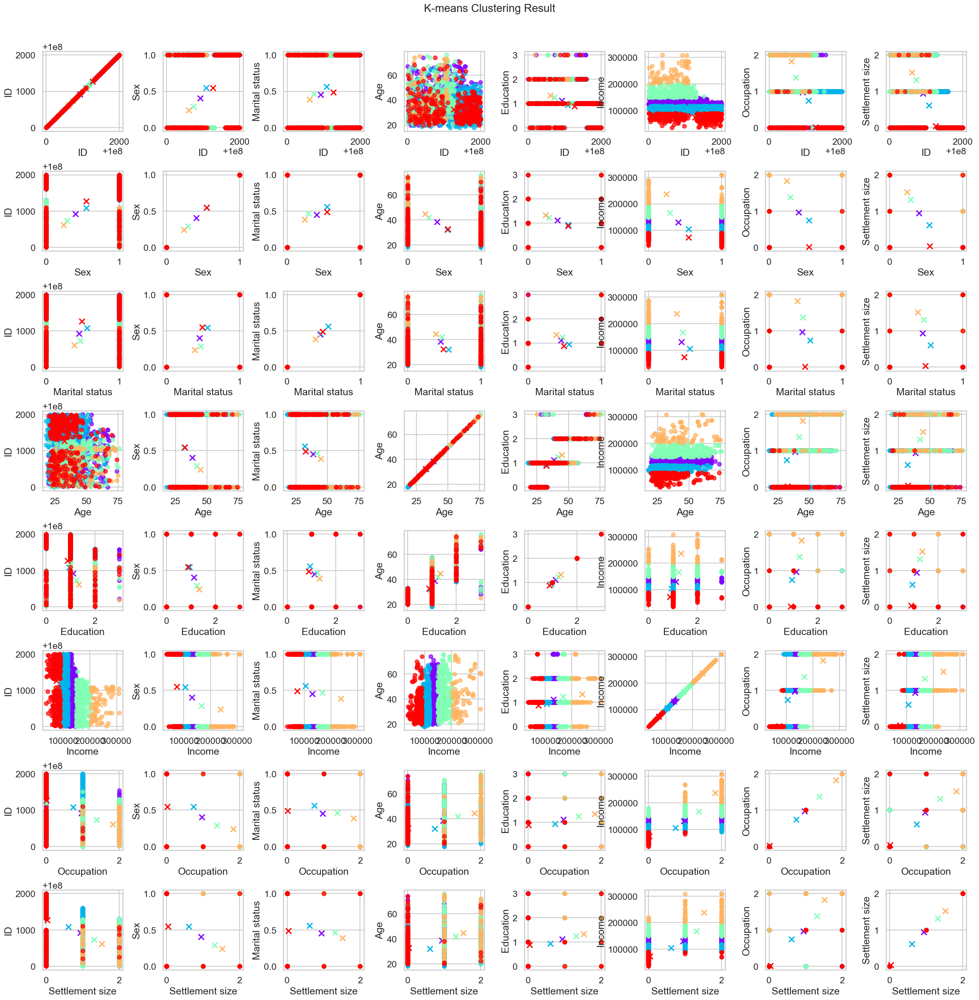

In [225]:
def display_cluster(data_points, feature_names=None, km=None, num_clusters=None, alpha=0.7, s=50):
    color = plt.cm.rainbow(np.linspace(0, 1, num_clusters))
    num_features = len(data_points[0])
    fig, axs = plt.subplots(num_features, num_features, figsize=(30, 30))
    
    plt.subplots_adjust(wspace=0.5, hspace=0.5)  # Add more spacing between subplots
    
    if km is not None:
        for i in range(num_clusters):
            cluster_points = data_points[km == i, :]
            for j in range(num_features):
                for k in range(num_features):
                    axs[j, k].scatter(cluster_points[:, j], cluster_points[:, k], c=[color[i]], alpha=alpha, s=s, label=f'Cluster {i}')
                    axs[j, k].scatter(np.mean(cluster_points[:, j]), np.mean(cluster_points[:, k]), c=color[i], marker='x', s=100, label=f'Centroid {i}')
                    axs[j, k].set_xlabel(feature_names[j])  # Set x-axis label
                    axs[j, k].set_ylabel(feature_names[k])  # Set y-axis label
    else:
        plt.scatter(data_points[:, 0], data_points[:, 1], c='b', alpha=alpha, s=s, label='Data Points')

    plt.suptitle('K-means Clustering Result', y=0.92, fontsize=20)
    plt.show()

kmeans_new = KMeans(n_clusters=5, random_state=42)
kmeans_new.fit(C)

# Get feature names
feature_names_new = df.columns

# Use the modified display_cluster function to visualize the result
display_cluster(C, km=kmeans_new.labels_, num_clusters=5, feature_names=feature_names_new)

The best K based on Silhouette Score: 3
Silhouette Score for the best K: 0.24437057324500533


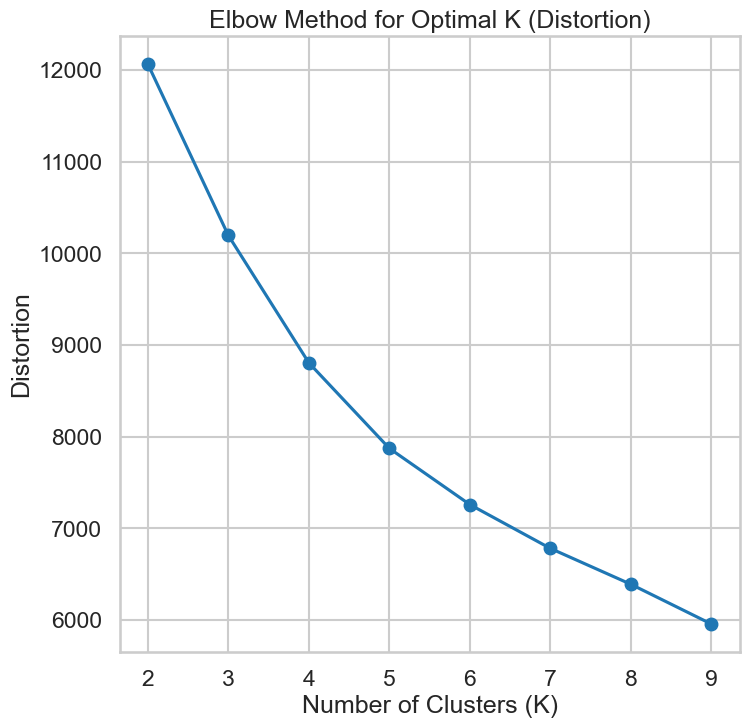

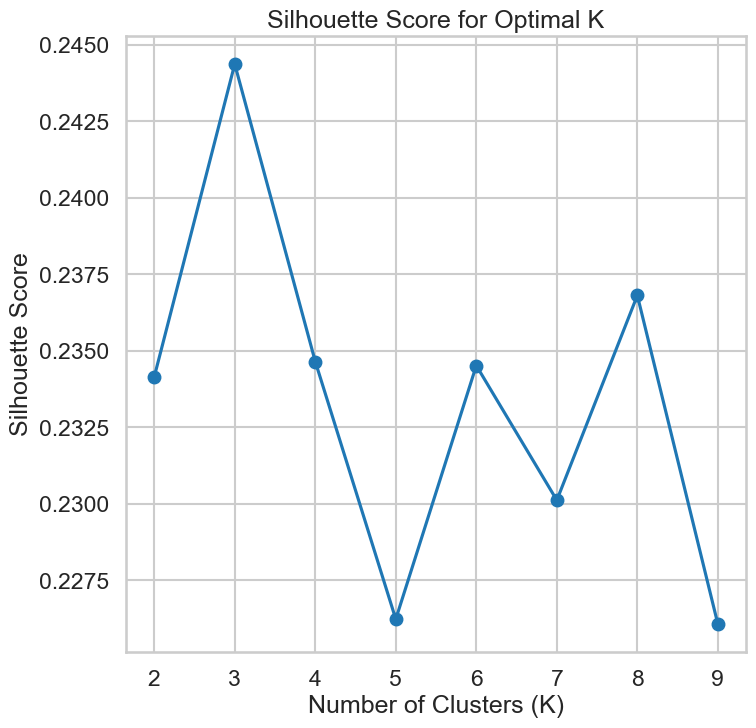

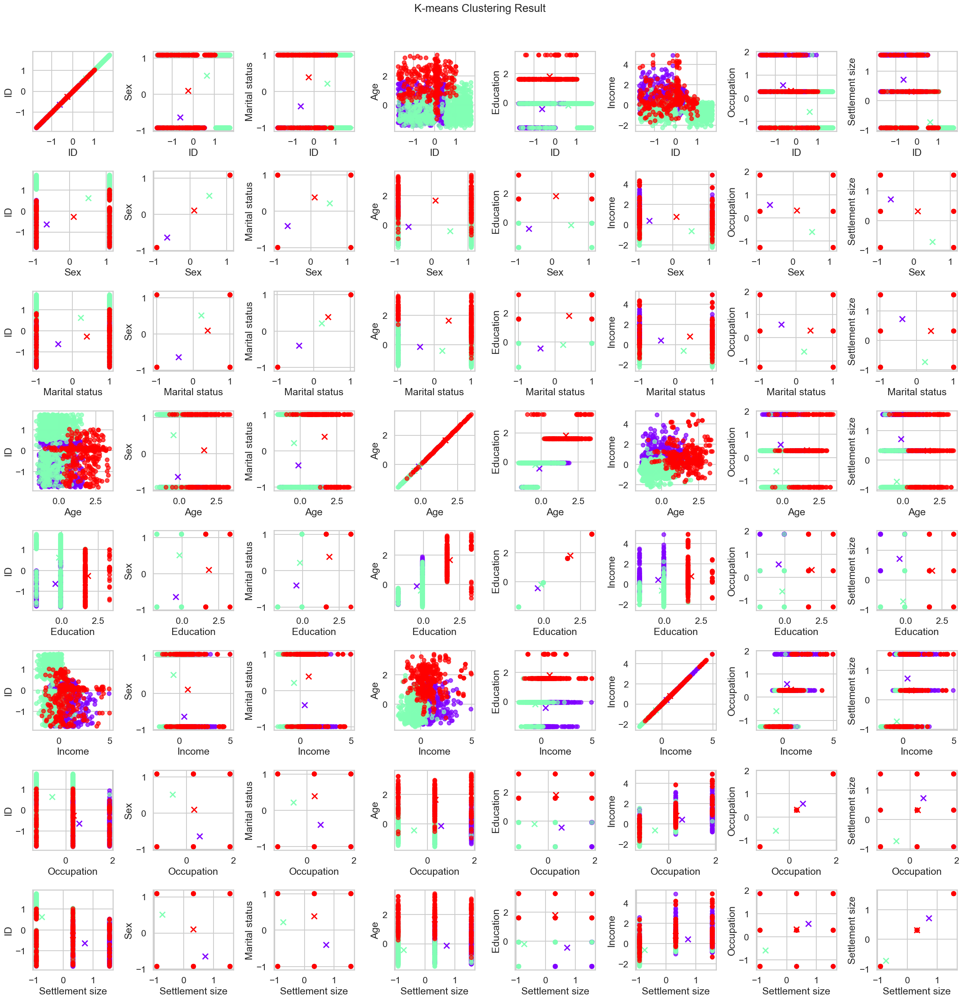

In [226]:


# Standardize the features
scaler = StandardScaler()
C_std = scaler.fit_transform(C)

# Specify K values to try
k_values = range(2, 10)

# Lists to store results
distortions = []
silhouette_scores = []

# Perform KMeans clustering for each value of K
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(C_std)
    
    # Calculate distortion and silhouette_score
    distortions.append(kmeans.inertia_)
    silhouette_avg = silhouette_score(C_std, kmeans.labels_)
    silhouette_scores.append(silhouette_avg)

# Plot distortion function versus K
plt.figure()
plt.plot(k_values, distortions, marker='o')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Distortion')
plt.title('Elbow Method for Optimal K (Distortion)')

# Plot silhouette_score versus K
plt.figure()
plt.plot(k_values, silhouette_scores, marker='o')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for Optimal K')

# Find the best K based on silhouette_score
best_k = k_values[np.argmax(silhouette_scores)]
print(f'The best K based on Silhouette Score: {best_k}')

# Perform KMeans clustering with the best K
best_kmeans = KMeans(n_clusters=best_k, random_state=42)
best_kmeans.fit(C_std)

# Store silhouette_score for the best K
best_silhouette_score = silhouette_score(C_std, best_kmeans.labels_)
print(f'Silhouette Score for the best K: {best_silhouette_score}')

# Use the modified display_cluster function to visualize the result with the best K
display_cluster(C_std, km=best_kmeans.labels_, num_clusters=best_k, feature_names=feature_names_new)
plt.show()


The best K based on Silhouette Score: 3
Silhouette Score for the best K: 0.42716578550681367


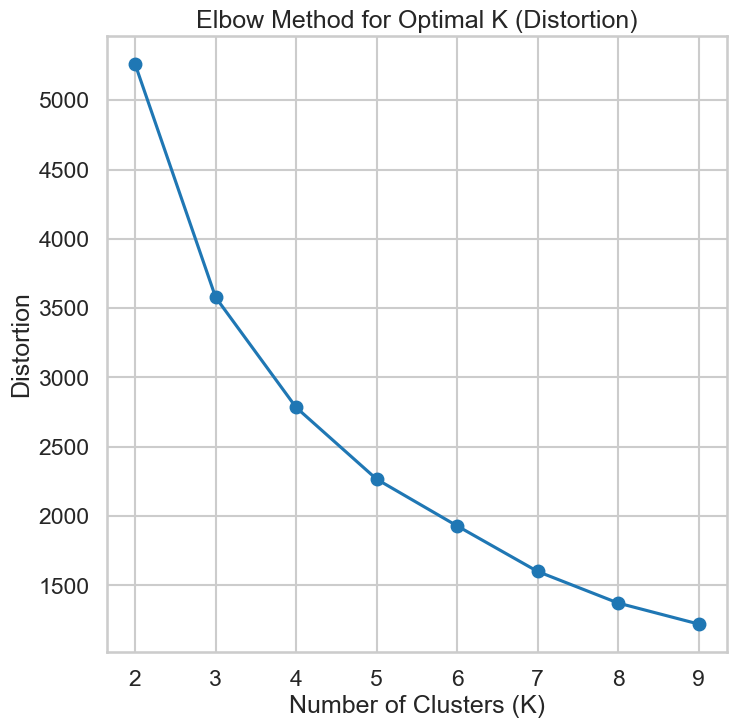

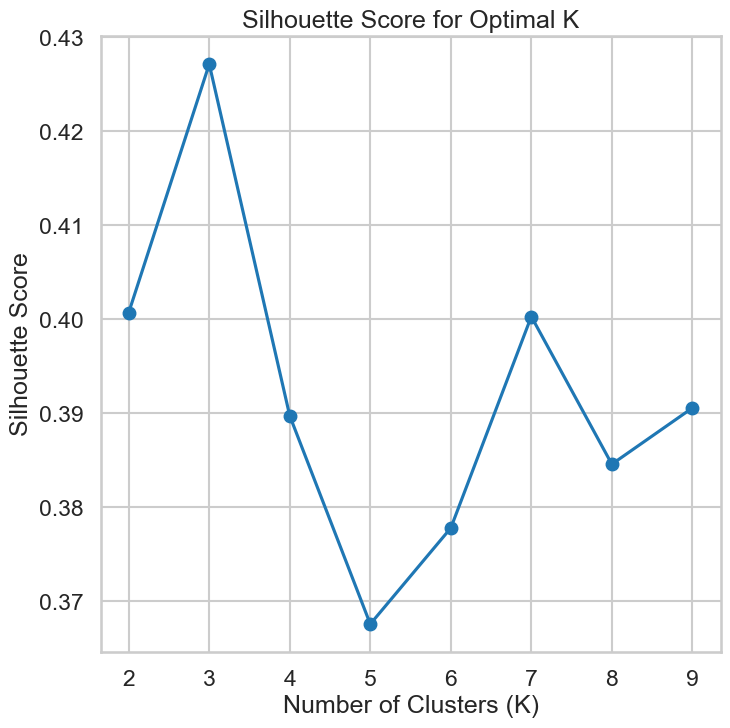

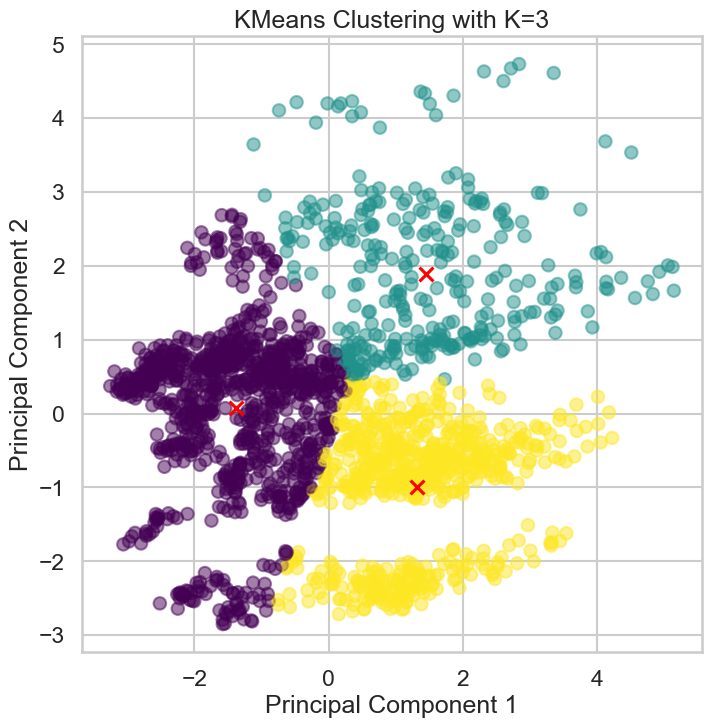

In [227]:

# Assuming you have a dataset 'C' and feature names 'feature_names_new'
# Standardize the features
scaler = StandardScaler()
C_std = scaler.fit_transform(C)

# Apply PCA to reduce the dataset to 2 dimensions
pca = PCA(n_components=2)
C_pca = pca.fit_transform(C_std)

# Specify K values to try
k_values = range(2, 10)

# Lists to store results
distortions = []
silhouette_scores = []

# Perform KMeans clustering for each value of K
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(C_pca)
    
    # Calculate distortion and silhouette_score
    distortions.append(kmeans.inertia_)
    silhouette_avg = silhouette_score(C_pca, kmeans.labels_)
    silhouette_scores.append(silhouette_avg)

# Plot distortion function versus K
plt.figure()
plt.plot(k_values, distortions, marker='o')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Distortion')
plt.title('Elbow Method for Optimal K (Distortion)')

# Plot silhouette_score versus K
plt.figure()
plt.plot(k_values, silhouette_scores, marker='o')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for Optimal K')

# Find the best K based on silhouette_score
best_k = k_values[np.argmax(silhouette_scores)]
print(f'The best K based on Silhouette Score: {best_k}')

# Perform KMeans clustering with the best K
best_kmeans = KMeans(n_clusters=best_k, random_state=42)
best_kmeans.fit(C_pca)

# Store silhouette_score for the best K
best_silhouette_score = silhouette_score(C_pca, best_kmeans.labels_)
print(f'Silhouette Score for the best K: {best_silhouette_score}')

# Visualize the result with the best K
plt.figure()
plt.scatter(C_pca[:, 0], C_pca[:, 1], c=best_kmeans.labels_, cmap='viridis', marker='o', alpha=0.5)
plt.scatter(best_kmeans.cluster_centers_[:, 0], best_kmeans.cluster_centers_[:, 1], c='red', marker='x', s=100)
plt.title(f'KMeans Clustering with K={best_k}')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.show()


### Heirarchal clustering

In [228]:
df = df.drop('ID', axis=1)
df.head()

,Sex,Marital status,Age,Education,Income,Occupation,Settlement size
0,0,0,67,2,124670,1,2
1,1,1,22,1,150773,1,2
2,0,0,49,1,89210,0,0
3,0,0,45,1,171565,1,1
4,0,0,53,1,149031,1,1


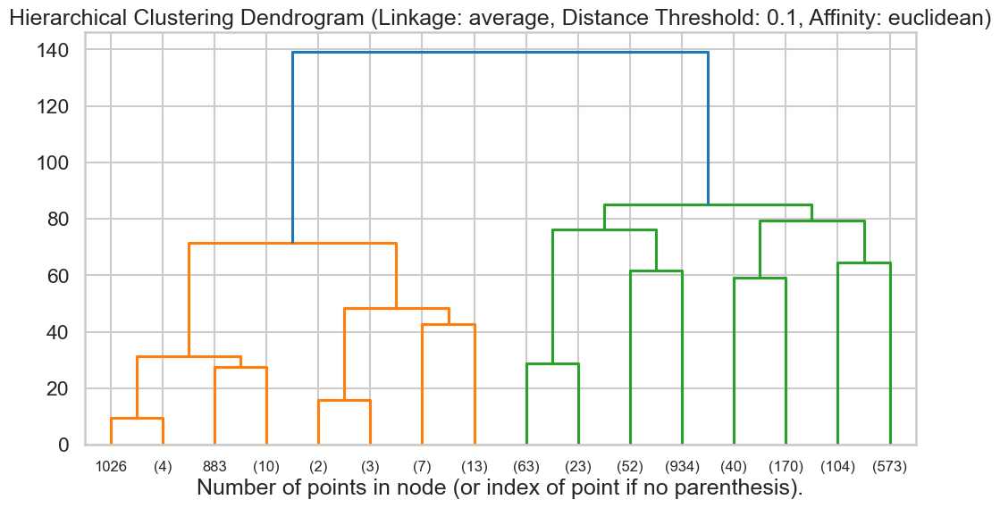

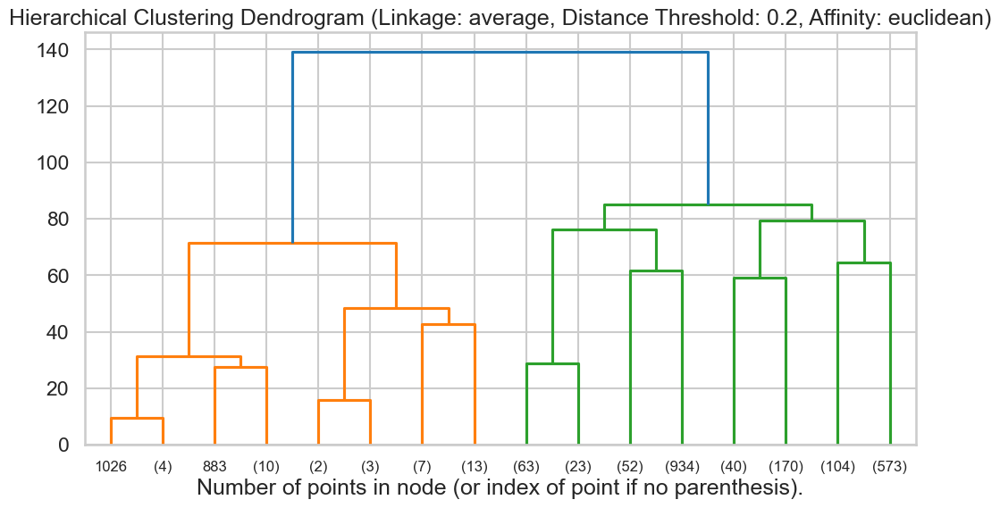

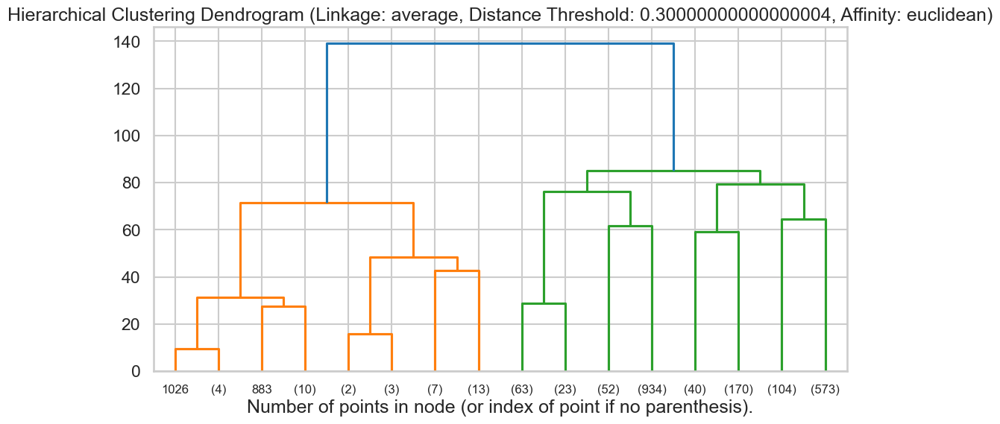

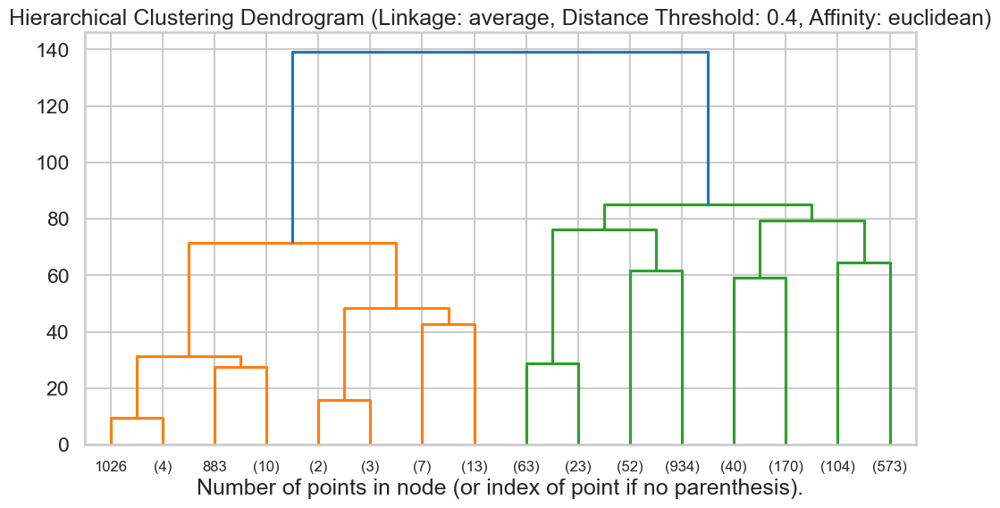

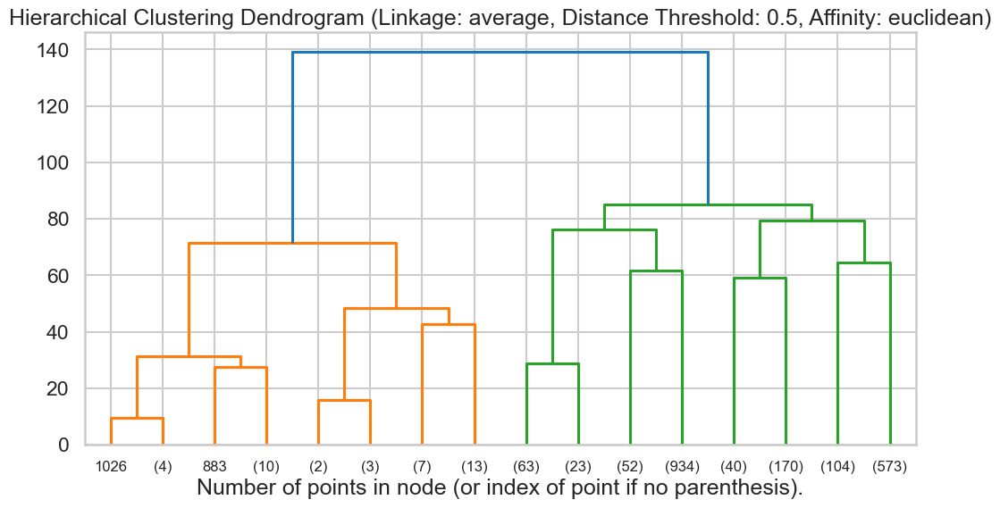

...

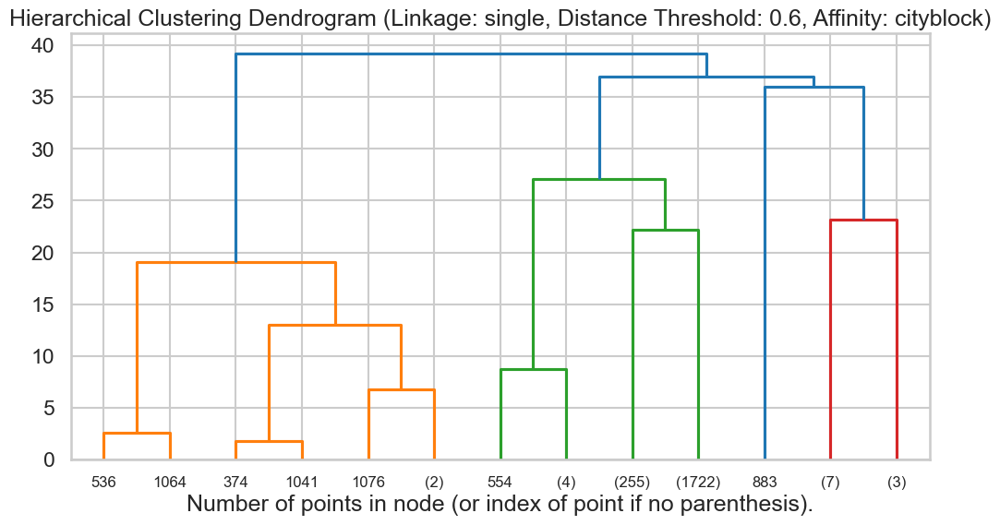

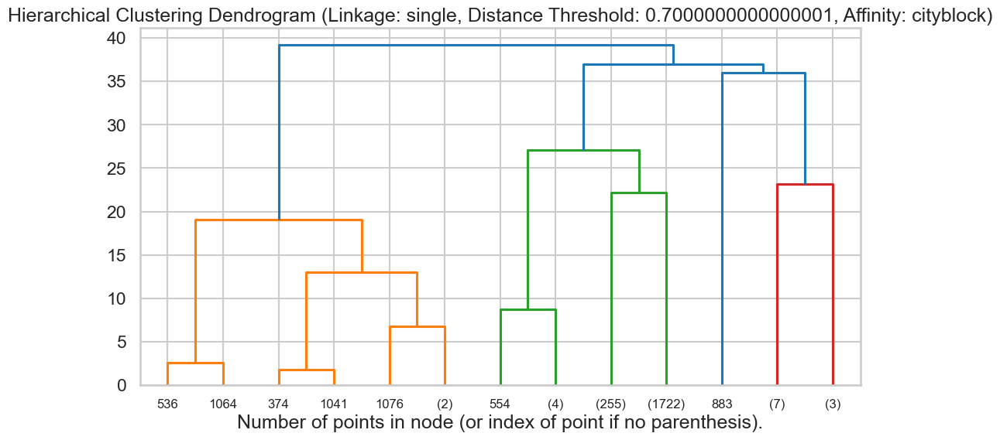

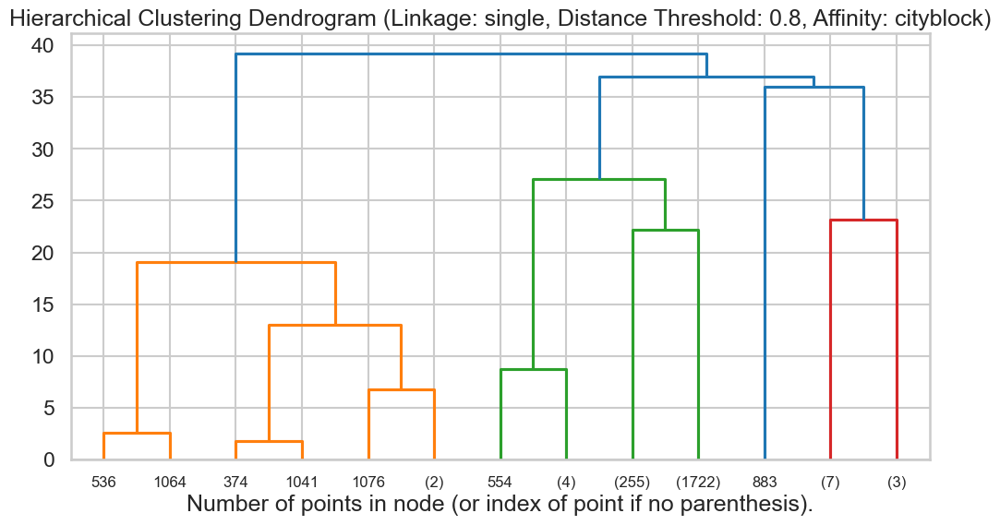

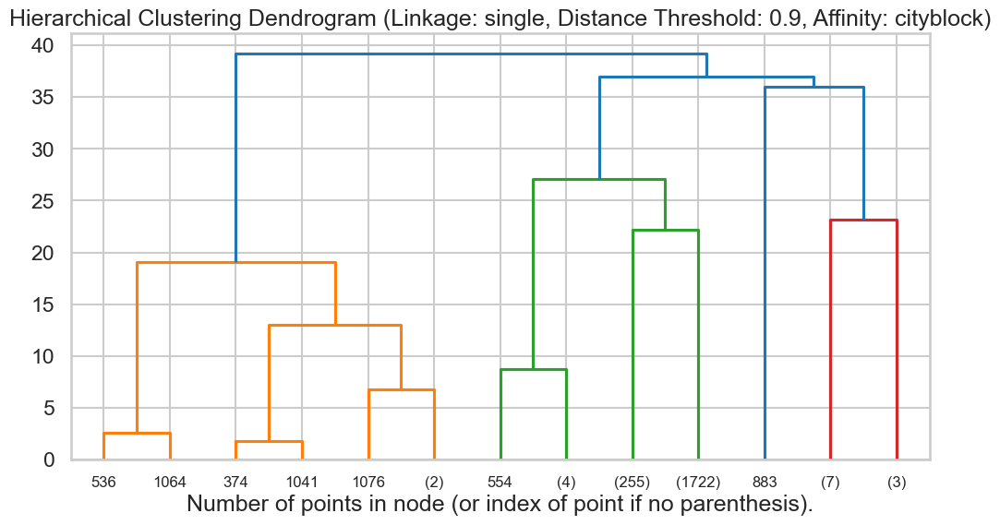

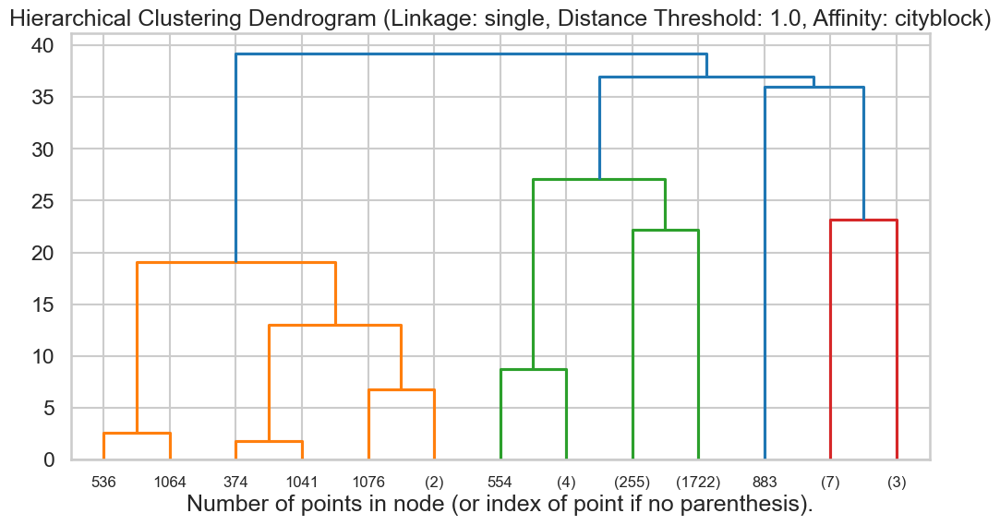

Best Parameters: {'distance_metric': 'euclidean', 'linkage_type': 'average', 'distance_threshold': 1.0, 'silhouette_score': 0.2719278902910803}


In [229]:


X_dataset = dataset.drop(['ID'], axis=1)

# Standardize the features
scaler = StandardScaler()
X_standardized = scaler.fit_transform(X_dataset)

# Apply PCA to reduce dimensions
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_standardized)

# Initialize variables to store best parameters and corresponding silhouette score
best_params = None
best_silhouette_score = -1  # Initialize with a value lower than possible silhouette scores

# Perform hierarchical clustering for each pair of features with a range of distance thresholds
for distance_metric in ['euclidean', 'cosine', 'cityblock']:
    for linkage_type in ['average', 'single']:
        for distance_threshold in np.linspace(0.1, 1.0, 10):
            labels = hierarchical_clustering(
                X_pca,
                affinity=distance_metric,
                linkage_type=linkage_type,
                distance_threshold=distance_threshold
            )

            # Compute silhouette score
            silhouette_score_value = silhouette_score(X_pca, labels)
            
            # Check if the current parameters result in a better silhouette score
            if silhouette_score_value > best_silhouette_score:
                best_silhouette_score = silhouette_score_value
                best_params = {
                    'distance_metric': distance_metric,
                    'linkage_type': linkage_type,
                    'distance_threshold': distance_threshold,
                    'silhouette_score': best_silhouette_score
                }

# Print the best parameters and corresponding silhouette score
print("Best Parameters:", best_params)


In [230]:
def hierarchical_clustering(X, affinity='euclidean', linkage_type='average', distance_threshold=None, plot_dendrogram=True):
    if affinity == 'pearson':
        distances = pearson_correlation(X)
    else:
        distances = squareform(pdist(X, metric=affinity))

    # Perform hierarchical clustering
    model = AgglomerativeClustering(linkage=linkage_type, n_clusters=None, distance_threshold=distance_threshold)
    labels = model.fit_predict(distances)

    # Plot dendrogram if specified
    if plot_dendrogram:
        plt.figure(figsize=(12, 6))
        plt.title(f'Hierarchical Clustering Dendrogram (Linkage: {linkage_type}, Distance Threshold: {distance_threshold}, Affinity: {affinity})')
        dendrogram(linkage(distances, method=linkage_type), truncate_mode='level', p=3)
        plt.xlabel("Number of points in node (or index of point if no parenthesis).")
        plt.show()

    # Return the computed labels
    return labels

def pearson_correlation(X):
    # Calculate the pairwise Pearson correlation coefficients
    corr_matrix = np.corrcoef(X.T)
    # Convert correlation coefficients to distances
    distances = 1 - np.abs(corr_matrix)
    return distances

# Load your larger dataset
dataset = pd.read_csv('C:/Users/hp/Desktop/Semester 10/(NETW 1013) Machine Learning/Machine Learning Assignment 1/Customer data.csv')

# Assume 'ID' is a column in your dataset
# df = dataset.drop('ID', axis=1)  # Drop 'ID' column if it exists

X_dataset = dataset.drop(['ID'], axis=1)

# Standardize the features
scaler = StandardScaler()
X_standardized = scaler.fit_transform(X_dataset)

# Apply PCA to reduce dimensions
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_standardized)

# Initialize variables to store best parameters and corresponding silhouette score
best_params = None
best_silhouette_score = -1  # Initialize with a value lower than possible silhouette scores
best_labels = None  # To store labels for the best result

# Perform hierarchical clustering for each pair of features with a range of distance thresholds
for distance_metric in ['euclidean', 'cosine', 'cityblock']:
    for linkage_type in ['average', 'single']:
        for distance_threshold in np.linspace(0.1, 1.0, 10):
            labels = hierarchical_clustering(
                X_pca,
                affinity=distance_metric,
                linkage_type=linkage_type,
                distance_threshold=distance_threshold,
                plot_dendrogram=False  # Don't plot dendrogram for each iteration
            )

            # Compute silhouette score
            silhouette_score_value = silhouette_score(X_pca, labels)
            
            # Check if the current parameters result in a better silhouette score
            if silhouette_score_value > best_silhouette_score:
                best_silhouette_score = silhouette_score_value
                best_params = {
                    'distance_metric': distance_metric,
                    'linkage_type': linkage_type,
                    'distance_threshold': distance_threshold,
                    'silhouette_score': best_silhouette_score
                }
                best_labels = labels

# Print the best parameters and corresponding silhouette score
print("Best Parameters:", best_params)

# Plot dendrogram for the best result
plt.figure(figsize=(12, 6))
plt.title(f'Best Hierarchical Clustering Dendrogram\n(Linkage: {best_params["linkage_type"]}, Distance Threshold: {best_params["distance_threshold"]}, Affinity: {best_params["distance_metric"]})')
dendrogram(linkage(X_pca, method=best_params["linkage_type"]), truncate_mode='level', p=3)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()


KeyboardInterrupt: 

## DBScan

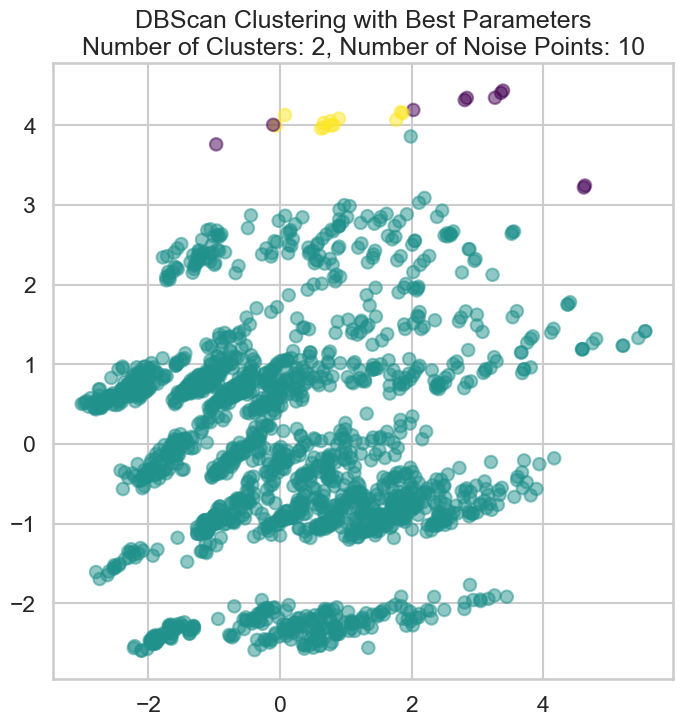

Best EPS: 1.0, Best Min_samples: 12
Best Silhouette Score: 0.39468663643661805


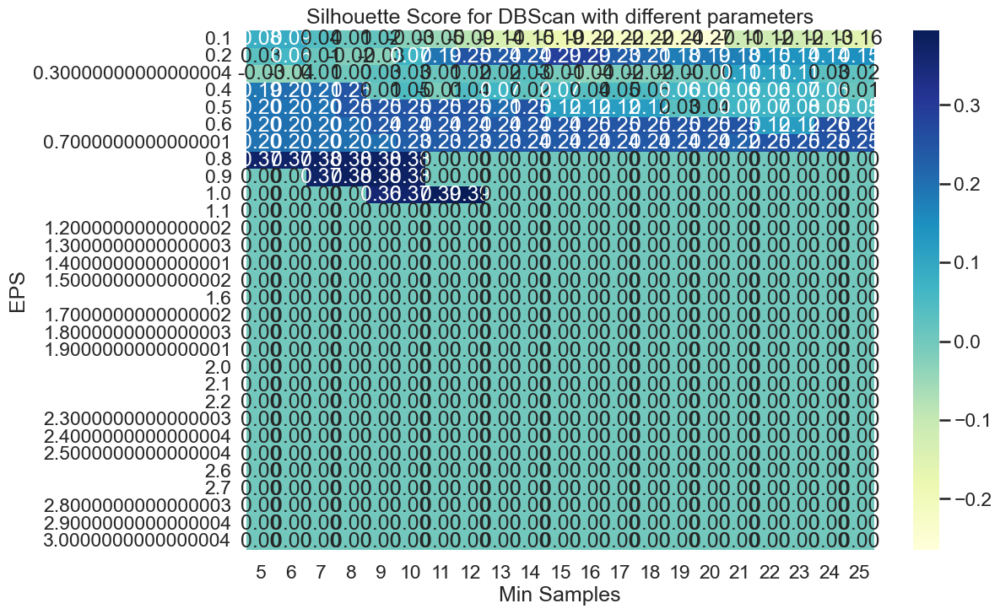

In [231]:
def perform_dbscan_pca(data, eps_range, min_samples_range):
    silhouette_scores = np.zeros((len(eps_range), len(min_samples_range)))

    for i, eps in enumerate(eps_range):
        for j, min_samples in enumerate(min_samples_range):
            avg_silhouette = 0
            num_valid_runs = 0

            dbscan = DBSCAN(eps=eps, min_samples=min_samples)
            labels = dbscan.fit_predict(data)

            unique_labels = set(labels)
            if len(unique_labels) > 2:  # At least 2 clusters and noise
                silhouette_avg = silhouette_score(data, labels)
                avg_silhouette += silhouette_avg
                num_valid_runs += 1

            if num_valid_runs > 0:
                avg_silhouette /= num_valid_runs
                silhouette_scores[i, j] = avg_silhouette

    return silhouette_scores


X_dataset = dataset.drop(['ID'], axis=1)

# Standardize the features
scaler = StandardScaler()
X_standardized = scaler.fit_transform(X_dataset)

# Apply PCA to reduce dimensions
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_standardized)

# Define the range of parameters to search
eps_range = np.arange(0.1, 3.1, 0.1)
min_samples_range = np.arange(5, 26, 1)

# Perform DBScan with varying parameters and average silhouette score
average_silhouette_scores = perform_dbscan_pca(X_pca, eps_range, min_samples_range)

# Find the indices of the maximum average silhouette score
best_indices = np.unravel_index(np.argmax(average_silhouette_scores), average_silhouette_scores.shape)
best_eps, best_min_samples, best_avg_silhouette_score = eps_range[best_indices[0]], min_samples_range[best_indices[1]], average_silhouette_scores[best_indices]

# Plot resulting clusters with the best parameters
best_dbscan = DBSCAN(eps=best_eps, min_samples=best_min_samples)
best_labels = best_dbscan.fit_predict(X_pca)

# Count the number of clusters (excluding noise)
num_clusters = len(set(best_labels)) - (1 if -1 in best_labels else 0)
num_noise_points = np.sum(best_labels == -1)

# Plot the clusters
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=best_labels, cmap='viridis', alpha=0.5)
plt.title(f'DBScan Clustering with Best Parameters\nNumber of Clusters: {num_clusters}, Number of Noise Points: {num_noise_points}')
plt.show()

# Print the best parameters and corresponding average silhouette score
print(f"Best EPS: {best_eps}, Best Min_samples: {best_min_samples}")
print(f"Best Silhouette Score: {best_avg_silhouette_score}")

# Plot average silhouette scores
plt.figure(figsize=(12, 8))
sns.heatmap(average_silhouette_scores, annot=True, fmt=".2f", cmap="YlGnBu",
            xticklabels=min_samples_range, yticklabels=eps_range)
plt.xlabel("Min Samples")
plt.ylabel("EPS")
plt.title("Silhouette Score for DBScan with different parameters")
plt.show()


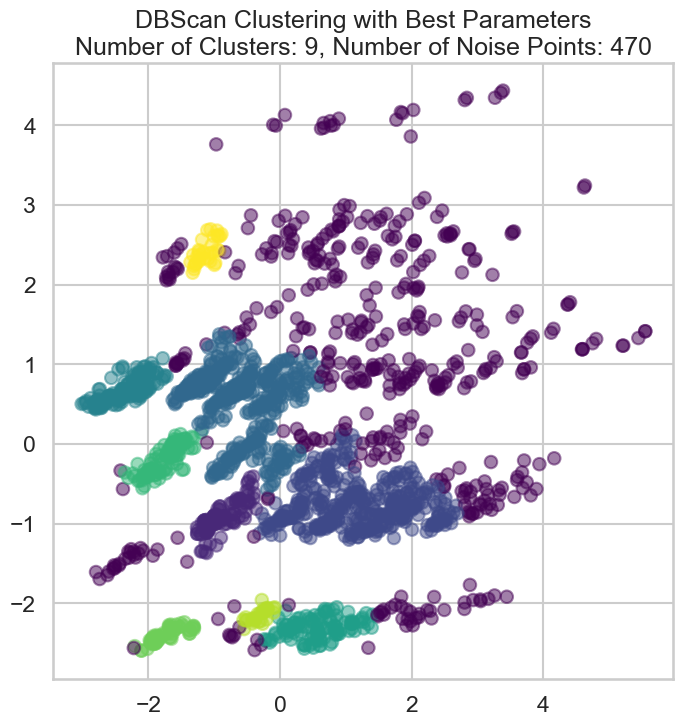

Best EPS: 0.2, Best Min_samples: 15
Best Silhouette Score: 0.28727142007682144


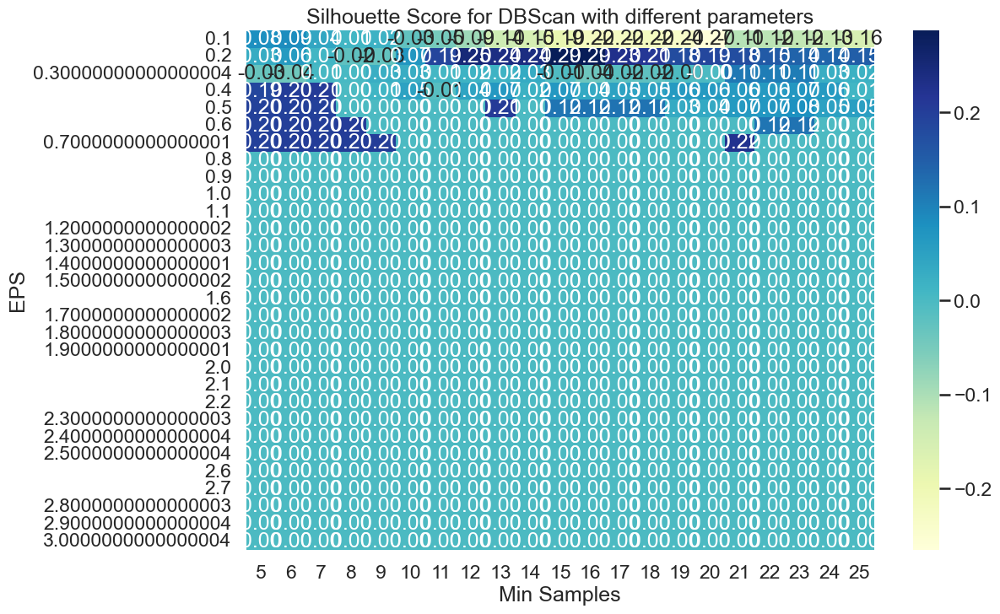

In [232]:
def perform_dbscan_pca(data, eps_range, min_samples_range):
    silhouette_scores = np.zeros((len(eps_range), len(min_samples_range)))

    for i, eps in enumerate(eps_range):
        for j, min_samples in enumerate(min_samples_range):
            avg_silhouette = 0
            num_valid_runs = 0

            dbscan = DBSCAN(eps=eps, min_samples=min_samples)
            labels = dbscan.fit_predict(data)

            unique_labels = set(labels)
            if len(unique_labels) > 3:  # At least 2 clusters and noise
                silhouette_avg = silhouette_score(data, labels)
                avg_silhouette += silhouette_avg
                num_valid_runs += 1

            if num_valid_runs > 0:
                avg_silhouette /= num_valid_runs
                silhouette_scores[i, j] = avg_silhouette

    return silhouette_scores


X_dataset = dataset.drop(['ID'], axis=1)

# Standardize the features
scaler = StandardScaler()
X_standardized = scaler.fit_transform(X_dataset)

# Apply PCA to reduce dimensions
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_standardized)

# Define the range of parameters to search
eps_range = np.arange(0.1, 3.1, 0.1)
min_samples_range = np.arange(5, 26, 1)

# Perform DBScan with varying parameters and average silhouette score
average_silhouette_scores = perform_dbscan_pca(X_pca, eps_range, min_samples_range)

# Find the indices of the maximum average silhouette score
best_indices = np.unravel_index(np.argmax(average_silhouette_scores), average_silhouette_scores.shape)
best_eps, best_min_samples, best_avg_silhouette_score = eps_range[best_indices[0]], min_samples_range[best_indices[1]], average_silhouette_scores[best_indices]

# Plot resulting clusters with the best parameters
best_dbscan = DBSCAN(eps=best_eps, min_samples=best_min_samples)
best_labels = best_dbscan.fit_predict(X_pca)

# Count the number of clusters (excluding noise)
num_clusters = len(set(best_labels)) - (1 if -1 in best_labels else 0)
num_noise_points = np.sum(best_labels == -1)

# Plot the clusters
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=best_labels, cmap='viridis', alpha=0.5)
plt.title(f'DBScan Clustering with Best Parameters\nNumber of Clusters: {num_clusters}, Number of Noise Points: {num_noise_points}')
plt.show()

# Print the best parameters and corresponding average silhouette score
print(f"Best EPS: {best_eps}, Best Min_samples: {best_min_samples}")
print(f"Best Silhouette Score: {best_avg_silhouette_score}")

# Plot average silhouette scores
plt.figure(figsize=(12, 8))
sns.heatmap(average_silhouette_scores, annot=True, fmt=".2f", cmap="YlGnBu",
            xticklabels=min_samples_range, yticklabels=eps_range)
plt.xlabel("Min Samples")
plt.ylabel("EPS")
plt.title("Silhouette Score for DBScan with different parameters")
plt.show()


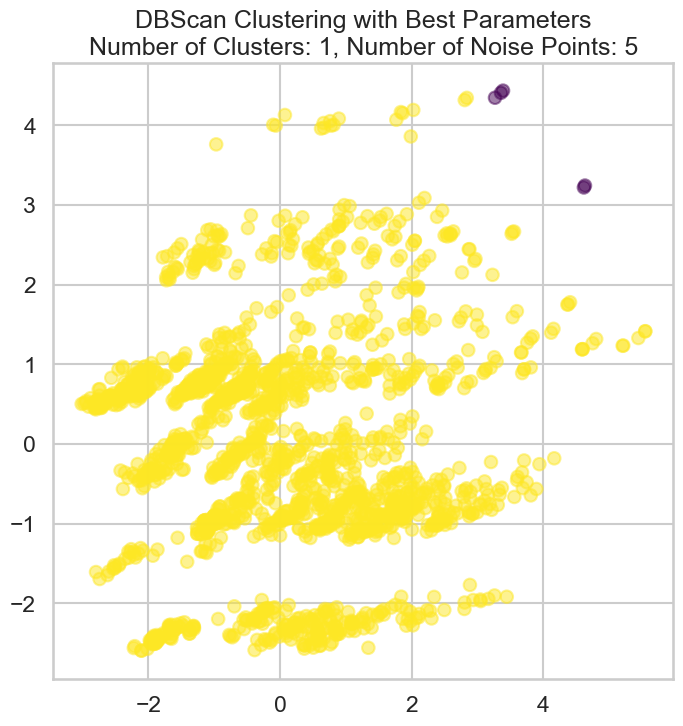

Best EPS: 1.1, Best Min_samples: 11
Best Silhouette Score: 0.516149151321788


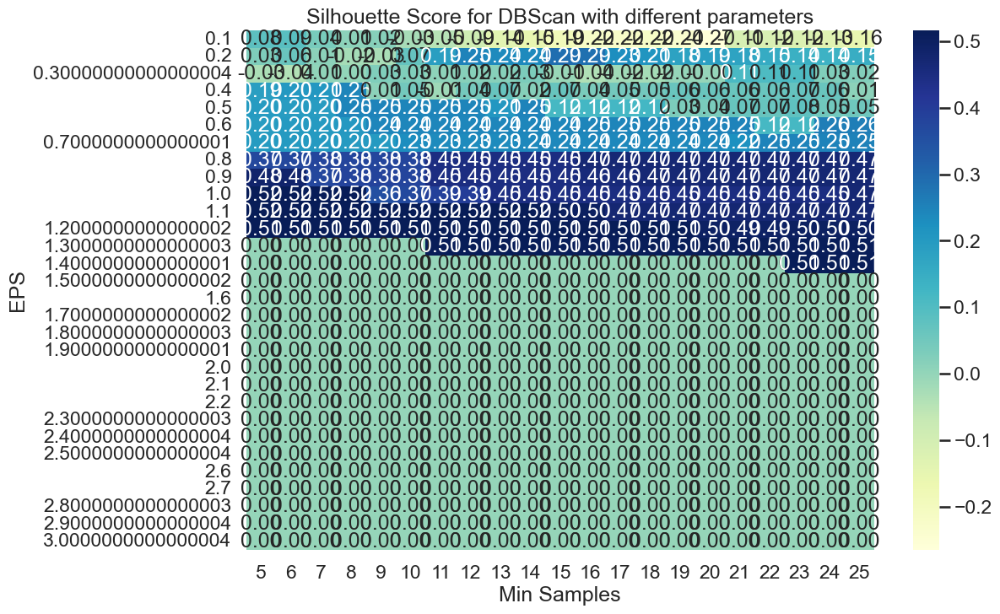

In [233]:

def perform_dbscan(data, eps_range, min_samples_range):
    silhouette_scores = np.zeros((len(eps_range), len(min_samples_range)))

    for i, eps in enumerate(eps_range):
        for j, min_samples in enumerate(min_samples_range):
            dbscan = DBSCAN(eps=eps, min_samples=min_samples)
            labels = dbscan.fit_predict(data)
            
            # Exclude outliers (-1) from silhouette score calculation
            if len(set(labels)) > 1:
                silhouette_avg = silhouette_score(data, labels)
                silhouette_scores[i, j] = silhouette_avg

    return silhouette_scores



# Extract relevant columns for clustering (modify as needed)
X_dataset = dataset.drop(['ID'], axis=1)

# Standardize the features
scaler = StandardScaler()
X_standardized = scaler.fit_transform(X_dataset)

# Apply PCA to reduce dimensions
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_standardized)

# Define the range of parameters to search
eps_range = np.arange(0.1, 3.1, 0.1)
min_samples_range = np.arange(5, 26, 1)

# Perform DBScan with varying parameters
silhouette_scores = perform_dbscan(X_pca, eps_range, min_samples_range)

# Find the indices of the maximum silhouette score
best_indices = np.unravel_index(np.argmax(silhouette_scores), silhouette_scores.shape)
best_eps, best_min_samples, best_silhouette_score = eps_range[best_indices[0]], min_samples_range[best_indices[1]], silhouette_scores[best_indices]

# Plot resulting clusters with the best parameters
best_dbscan = DBSCAN(eps=best_eps, min_samples=best_min_samples)
best_labels = best_dbscan.fit_predict(X_pca)

# Count the number of clusters (excluding noise)
num_clusters = len(set(best_labels)) - (1 if -1 in best_labels else 0)
num_noise_points = np.sum(best_labels == -1)

# Plot the clusters
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=best_labels, cmap='viridis', alpha=0.5)
plt.title(f'DBScan Clustering with Best Parameters\nNumber of Clusters: {num_clusters}, Number of Noise Points: {num_noise_points}')
plt.show()

# Print the best parameters and corresponding silhouette score
print(f"Best EPS: {best_eps}, Best Min_samples: {best_min_samples}")
print(f"Best Silhouette Score: {best_silhouette_score}")
# Plot silhouette scores
plt.figure(figsize=(12, 8))
sns.heatmap(silhouette_scores, annot=True, fmt=".2f", cmap="YlGnBu",
                xticklabels=min_samples_range, yticklabels=eps_range)
plt.xlabel("Min Samples")
plt.ylabel("EPS")
plt.title("Silhouette Score for DBScan with different parameters")
plt.show()


## Gaussian Mixture


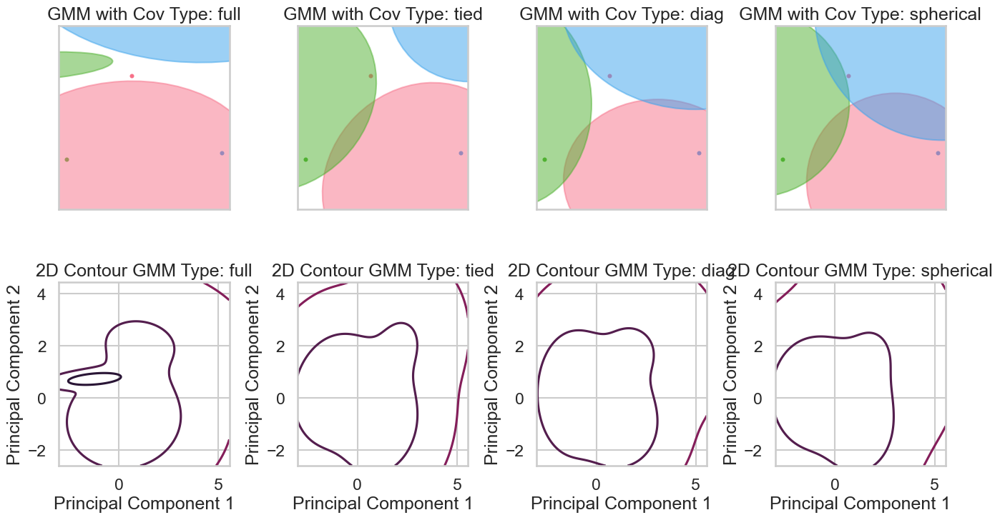

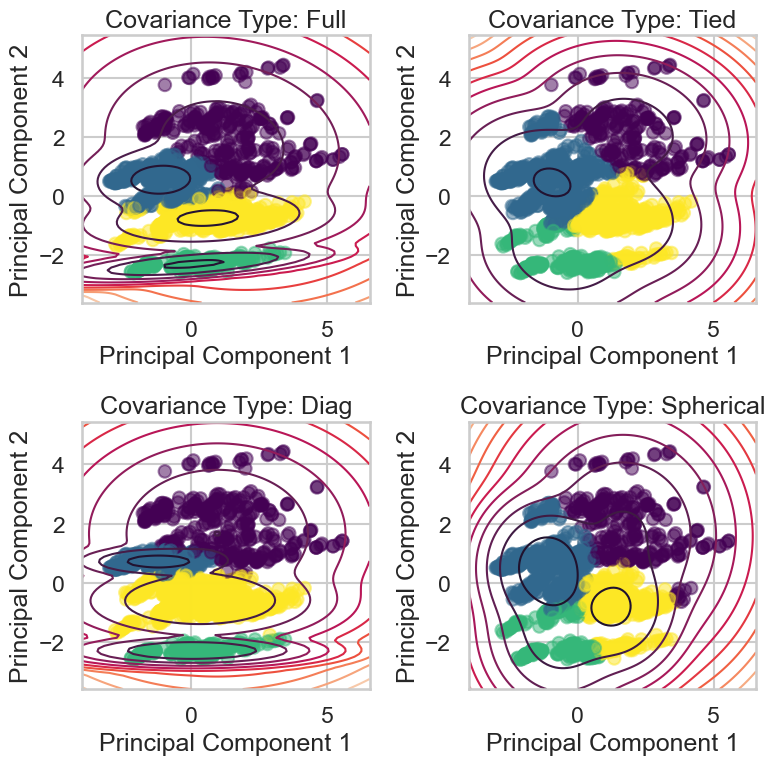

Log-likelihood for Full covariance type: -3.23
Log-likelihood for Tied covariance type: -3.48
Log-likelihood for Diag covariance type: -3.20
Log-likelihood for Spherical covariance type: -3.47


In [234]:
# Extract relevant columns for clustering (modify as needed)
X_dataset = dataset.drop(['ID'], axis=1)

# Standardize the features
scaler = StandardScaler()
X_standardized = scaler.fit_transform(X_dataset)

# Apply PCA to reduce the dataset to 2 dimensions
pca = PCA(n_components=2)
data_pca = pca.fit_transform(X_standardized)

# Set up GMM parameters
covariance_types = ["full", "tied", "diag", "spherical"]
n_estimators = len(covariance_types)

plt.figure(figsize=(4 * n_estimators, 8))
plt.subplots_adjust(wspace=0.4, hspace=0.4)

colors = sns.color_palette("husl", n_colors=3) 

for index, cov_type in enumerate(covariance_types):
    # Fit GMM with the current covariance_type
    gmm = GaussianMixture(n_components=3, covariance_type=cov_type, random_state=42)
    gmm.fit(data_pca)

    # Plot data points
    plt.subplot(2, n_estimators, index + 1)
    for n, color in zip(range(1, 4), colors):  # Use the modified colors
        data = data_pca[df.index[df.index == n]]
        plt.scatter(data[:, 0], data[:, 1], s=8, color=color, label=f"Class {n}")

    # Plot GMM components
    make_ellipses(gmm, plt.gca())
    plt.title(f"GMM with Cov Type: {cov_type}")
    plt.xticks(())
    plt.yticks(())

    # Plot 2D contour plot of the GMM
    plt.subplot(2, n_estimators, index + n_estimators + 1)
    h = plt.gca()
    x, y = np.meshgrid(np.linspace(data_pca[:, 0].min(), data_pca[:, 0].max(), 500),
                       np.linspace(data_pca[:, 1].min(), data_pca[:, 1].max(), 500))
    xy = np.column_stack((x.ravel(), y.ravel()))
    z = -gmm.score_samples(xy)
    z = z.reshape(x.shape)
    plt.contour(x, y, z, norm=LogNorm(vmin=1.0, vmax=1000.0), levels=np.logspace(0, 3, 10))
    plt.title(f"2D Contour GMM Type: {cov_type}")
    plt.xlabel("Principal Component 1")
    plt.ylabel("Principal Component 2")

plt.show()



log_likelihoods = {}

for i, covariance_type in enumerate(covariance_types, 1):
    
    gmm = GaussianMixture(n_components=4, covariance_type=covariance_type, random_state=0)
    gmm.fit(data_pca)
    
    log_likelihoods[covariance_type] = gmm.score(data_pca)
    
    # Generate grid points to evaluate the density
    x_min, x_max = data_pca[:, 0].min() - 1, data_pca[:, 0].max() + 1
    y_min, y_max = data_pca[:, 1].min() - 1, data_pca[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 100), np.linspace(y_min, y_max, 100))
    Z = -gmm.score_samples(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    
    # Plot contour plot
    plt.subplot(2, 2, i)
    plt.scatter(data_pca[:, 0], data_pca[:, 1], marker='o', c=gmm.predict(data_pca), cmap='viridis', alpha=0.5)
    plt.contour(xx, yy, Z, levels=10, linewidths=1.5)
    plt.title(f'Covariance Type: {covariance_type.capitalize()}')
    plt.xlabel('Principal Component 1')  
    plt.ylabel('Principal Component 2')  

plt.tight_layout()
plt.show()

for covariance_type, log_likelihood in log_likelihoods.items():
    print(f'Log-likelihood for {covariance_type.capitalize()} covariance type: {log_likelihood:.2f}')
